In [1]:
import numpy as np
import pandas as pd
import os
print(os.listdir("../predict_future_sales/input/"))
import matplotlib.pyplot as plt
import seaborn as sns
from xgboost import plot_importance
import gc

['sales_train.csv', 'Untitled.ipynb', 'shops.csv', 'test.csv', 'item_categories.csv', 'items.csv', 'sample_submission.csv']


In [2]:
def plot_features(booster, figsize):    
    fig, ax = plt.subplots(1,1,figsize=figsize)
    return plot_importance(booster=booster, ax=ax)

In [3]:
pd.get_option("display.max_columns")

#最大表示列数の指定（ここでは50列を指定）
pd.set_option('display.max_columns', 120)
#現在の最大表示行数の出力
pd.get_option("display.max_rows")

#最大表示行数の指定（ここでは50行を指定）
pd.set_option('display.max_rows', 300)

In [4]:
DATA_FOLDER = '../predict_future_sales/input'

transactions = pd.read_csv('input/sales_train.csv')
items = pd.read_csv('input/items.csv')
item_categories = pd.read_csv('input/item_categories.csv')
shops = pd.read_csv(os.path.join(DATA_FOLDER,'shops.csv'))


In [5]:
test = pd.read_csv(os.path.join(DATA_FOLDER,'test.csv'))

In [6]:
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day
0,02.01.2013,0,59,22154,999.00,1.0
1,03.01.2013,0,25,2552,899.00,1.0
2,05.01.2013,0,25,2552,899.00,-1.0
3,06.01.2013,0,25,2554,1709.05,1.0
4,15.01.2013,0,25,2555,1099.00,1.0


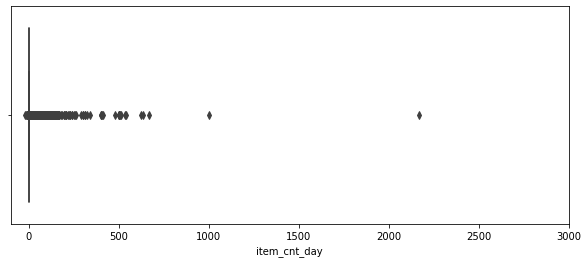

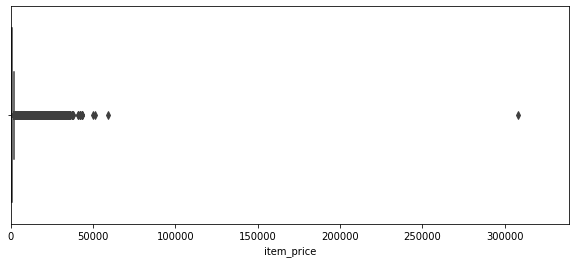

In [7]:
plt.figure(figsize=(10,4))
plt.xlim(-100, 3000)
sns.boxplot(x=transactions.item_cnt_day)

plt.figure(figsize=(10,4))
plt.xlim(transactions.item_price.min(), transactions.item_price.max()*1.1)
sns.boxplot(x=transactions.item_price)

In [8]:
transactions = transactions[transactions.item_cnt_day < 1001]
transactions  = transactions[transactions.item_price < 100000]

In [9]:
items.head(5)

,item_name,item_id,item_category_id
0,! ВО ВЛАСТИ НАВАЖДЕНИЯ (ПЛАСТ.) D,0,40
1,!ABBYY FineReader 12 Professional Edition Full...,1,76
2,***В ЛУЧАХ СЛАВЫ (UNV) D,2,40
3,***ГОЛУБАЯ ВОЛНА (Univ) D,3,40
4,***КОРОБКА (СТЕКЛО) D,4,40


In [10]:
item_categories.head(5)

,item_category_name,item_category_id
0,PC - Гарнитуры/Наушники,0
1,Аксессуары - PS2,1
2,Аксессуары - PS3,2
3,Аксессуары - PS4,3
4,Аксессуары - PSP,4


In [11]:
shops.head(10)

,shop_name,shop_id
0,"!Якутск Орджоникидзе, 56 фран",0
1,"!Якутск ТЦ ""Центральный"" фран",1
2,"Адыгея ТЦ ""Мега""",2
3,"Балашиха ТРК ""Октябрь-Киномир""",3
4,"Волжский ТЦ ""Волга Молл""",4
5,"Вологда ТРЦ ""Мармелад""",5
6,"Воронеж (Плехановская, 13)",6
7,"Воронеж ТРЦ ""Максимир""",7
8,"Воронеж ТРЦ Сити-Парк ""Град""",8
9,Выездная Торговля,9


In [12]:
shops['city_name'] = shops['shop_name'].map(lambda x:x.split(' ')[0])
shops['city_name'].value_counts()

Москва              13
РостовНаДону         3
Тюмень               3
Воронеж              3
Новосибирск          2
Жуковский            2
СПб                  2
Самара               2
Якутск               2
Н.Новгород           2
Красноярск           2
Казань               2
!Якутск              2
Уфа                  2
Коломна              1
Выездная             1
Калуга               1
Цифровой             1
Ярославль            1
Адыгея               1
Волжский             1
Курск                1
Интернет-магазин     1
Мытищи               1
Балашиха             1
Чехов                1
Томск                1
Химки                1
Вологда              1
Сергиев              1
Омск                 1
Сургут               1
Name: city_name, dtype: int64

In [13]:
shops.loc[shops['city_name'] == '!Якутск', 'city_name'] = 'Якутск'
shops.city_name.value_counts()

Москва              13
Якутск               4
РостовНаДону         3
Тюмень               3
Воронеж              3
Уфа                  2
Казань               2
Н.Новгород           2
Жуковский            2
Новосибирск          2
Красноярск           2
Самара               2
СПб                  2
Адыгея               1
Ярославль            1
Цифровой             1
Калуга               1
Чехов                1
Омск                 1
Вологда              1
Сергиев              1
Мытищи               1
Коломна              1
Химки                1
Томск                1
Балашиха             1
Интернет-магазин     1
Курск                1
Волжский             1
Выездная             1
Сургут               1
Name: city_name, dtype: int64

In [14]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [15]:
item_categories['split'] = item_categories['item_category_name'].str.split(' - ')
item_categories['type'] = item_categories['split'].map(lambda x:x[0].strip())
item_categories['subtype'] = item_categories['split'].map(lambda x:x[1].strip() if len(x) > 1 else x[0].strip())
item_categories['type'] = le.fit_transform(item_categories['type'])
item_categories['subtype'] = le.fit_transform(item_categories['subtype'])

item_categories = item_categories[['type','subtype','item_category_id']]

In [16]:
shops['city_name'] = le.fit_transform(shops['city_name'])

encoding = shops.groupby('city_name').size()
encoding = encoding / len(shops)
shops['city_frequency'] = shops.city_name.map(encoding)
shops.city_frequency.describe()

# encoding = test.groupby('item_id').size()
# encoding = encoding/len(test)
# test['item_freq'] = test.item_id.map(encoding)

count    60.000000
mean      0.072778
std       0.077628
min       0.016667
25%       0.016667
50%       0.033333
75%       0.066667
max       0.216667
Name: city_frequency, dtype: float64

In [17]:
transactions = pd.merge(transactions, items, on='item_id', how='left')
transactions = transactions.drop('item_name',axis=1)
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
0,02.01.2013,0,59,22154,999.00,1.0,37
1,03.01.2013,0,25,2552,899.00,1.0,58
2,05.01.2013,0,25,2552,899.00,-1.0,58
3,06.01.2013,0,25,2554,1709.05,1.0,58
4,15.01.2013,0,25,2555,1099.00,1.0,56


In [18]:
transactions = pd.merge(transactions, shops, on='shop_id', how='left')
transactions.head(5)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id,shop_name,city_name,city_frequency
0,02.01.2013,0,59,22154,999.00,1.0,37,"Ярославль ТЦ ""Альтаир""",30,0.016667
1,03.01.2013,0,25,2552,899.00,1.0,58,"Москва ТРК ""Атриум""",13,0.216667
2,05.01.2013,0,25,2552,899.00,-1.0,58,"Москва ТРК ""Атриум""",13,0.216667
3,06.01.2013,0,25,2554,1709.05,1.0,58,"Москва ТРК ""Атриум""",13,0.216667
4,15.01.2013,0,25,2555,1099.00,1.0,56,"Москва ТРК ""Атриум""",13,0.216667


In [19]:
from itertools import product
index_col = ['shop_id','item_id','date_block_num']

In [20]:
grid = []
for block_num in transactions['date_block_num'].unique():
    cur_shops = transactions.loc[transactions['date_block_num'] == block_num, 'shop_id'].unique()
    #This shows all shops in three countries working in each month
    cur_items = transactions.loc[transactions['date_block_num']==block_num,'item_id'].unique()
    grid.append(np.array(list(product(*[cur_shops,cur_items,[block_num]])),dtype='int32'))
grid = pd.DataFrame(np.vstack(grid),columns=index_col,dtype=np.int32)
grid.head(15)

,shop_id,item_id,date_block_num
0,59,22154,0
1,59,2552,0
2,59,2554,0
3,59,2555,0
4,59,2564,0
5,59,2565,0
6,59,2572,0
7,59,2573,0
8,59,2574,0
9,59,2593,0


## Make statistical features

In [21]:
mean_transactions = transactions.groupby(['date_block_num','shop_id','item_id']).agg({'item_cnt_day':'sum','item_price':np.mean}).reset_index()

mean_transactions.head(5)

,date_block_num,shop_id,item_id,item_cnt_day,item_price
0,0,0,32,6.0,221.0
1,0,0,33,3.0,347.0
2,0,0,35,1.0,247.0
3,0,0,43,1.0,221.0
4,0,0,51,2.0,128.5


In [22]:
mean_transactions.columns = ['date_block_num','shop_id','item_id','item_cnt_month','item_price']

In [23]:
mean_transactions.item_cnt_month.describe()

count    1.609123e+06
mean     2.265853e+00
std      8.466196e+00
min     -2.200000e+01
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      1.644000e+03
Name: item_cnt_month, dtype: float64

In [24]:
mean_transactions.item_cnt_month = mean_transactions.item_cnt_month.clip(0,20)
mean_transactions.item_cnt_month.describe()

count    1.609123e+06
mean     2.022807e+00
std      2.577964e+00
min      0.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      2.000000e+01
Name: item_cnt_month, dtype: float64

In [25]:
mean_transactions = pd.merge(grid, mean_transactions, on=['date_block_num','shop_id','item_id'],how='left').fillna(0)
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price
0,59,22154,0,1.0,999.0
1,59,2552,0,0.0,0.0
2,59,2554,0,0.0,0.0
3,59,2555,0,0.0,0.0
4,59,2564,0,0.0,0.0
5,59,2565,0,0.0,0.0
6,59,2572,0,0.0,0.0
7,59,2573,0,0.0,0.0
8,59,2574,0,2.0,399.0
9,59,2593,0,0.0,0.0


In [26]:
mean_transactions = pd.merge(mean_transactions, items, on='item_id',how='left')
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id
0,59,22154,0,1.0,999.0,ЯВЛЕНИЕ 2012 (BD),37
1,59,2552,0,0.0,0.0,DEEP PURPLE The House Of Blue Light LP,58
2,59,2554,0,0.0,0.0,DEEP PURPLE Who Do You Think We Are LP,58
3,59,2555,0,0.0,0.0,DEEP PURPLE 30 Very Best Of 2CD (Фирм.),56
4,59,2564,0,0.0,0.0,DEEP PURPLE Perihelion: Live In Concert DVD (К...,59
5,59,2565,0,0.0,0.0,DEEP PURPLE Stormbringer (фирм.),56
6,59,2572,0,0.0,0.0,DEFTONES Koi No Yokan,55
7,59,2573,0,0.0,0.0,DEL REY LANA Born To Die,55
8,59,2574,0,2.0,399.0,DEL REY LANA Born To Die The Paradise Editio...,55
9,59,2593,0,0.0,0.0,DEPECHE MODE Music For The Masses,55


In [27]:
shops.drop('shop_name',axis=1,inplace=True)
shops['city_name'].value_counts()

13    13
29     4
24     3
4      3
18     3
15     2
19     2
8      2
16     2
20     2
6      2
25     2
11     2
10     1
5      1
7      1
3      1
2      1
1      1
9      1
30     1
12     1
14     1
17     1
21     1
22     1
23     1
26     1
27     1
28     1
0      1
Name: city_name, dtype: int64

In [28]:
mean_transactions = pd.merge(mean_transactions, shops, on=['shop_id'], how='left')

In [29]:
mean_transactions = pd.merge(mean_transactions, item_categories, on = ['item_category_id'], how='left')

In [30]:
mean_transactions = mean_transactions[mean_transactions.date_block_num > 12]

In [31]:
test['date_block_num'] = 34
test  = pd.merge(test, items, on=['item_id'], how='left')
test = pd.merge(test, shops, on= ['shop_id'], how='left')
test = pd.merge(test, item_categories, on=['item_category_id'], how='left')

In [32]:
test.head(5)

,ID,shop_id,item_id,date_block_num,item_name,item_category_id,city_name,city_frequency,type,subtype
0,0,5,5037,34,"NHL 15 [PS3, русские субтитры]",19,3,0.016667,5,12
1,1,5,5320,34,ONE DIRECTION Made In The A.M.,55,3,0.016667,13,4
2,2,5,5233,34,"Need for Speed Rivals (Essentials) [PS3, русск...",19,3,0.016667,5,12
3,3,5,5232,34,"Need for Speed Rivals (Classics) [Xbox 360, ру...",23,3,0.016667,5,18
4,4,5,5268,34,"Need for Speed [PS4, русская версия]",20,3,0.016667,5,13


In [33]:
def downcast_dtypes(df):
    '''
        Changes column types in the dataframe: 
                
                `float64` type to `float32`
                `int64`   type to `int32`
    '''
    
    # Select columns to downcast
    float_cols = [c for c in df if df[c].dtype == "float64"]
    int_cols =   [c for c in df if df[c].dtype == "int64"]
    
    # Downcast
    df[float_cols] = df[float_cols].astype(np.float32)
    df[int_cols]   = df[int_cols].astype(np.int32)
    
    return df

In [34]:
transactions['sales'] = transactions['item_cnt_day'] * transactions['item_price']

In [35]:
mean_transactions['product_sales'] = mean_transactions['item_cnt_month'] * mean_transactions['item_price']

## I will make the similar dataframe about statistical features, but this time, these are lag features

In [36]:
item_mean = transactions.groupby(['item_id','date_block_num']).mean().reset_index()\
                        [['item_id','item_price','item_cnt_day','date_block_num','sales']]
item_mean.columns = ['item_id','item_price_per_item','item_cnt_day_per_item','date_block_num','sales_per_item']



item_std =transactions.groupby(['item_id','date_block_num']).std().reset_index()\
                        [['item_id','item_price','item_cnt_day','date_block_num','sales']]
item_std.columns = ['item_id','price_std_per_item','cnt_day_std_per_item','date_block_num','sales_std_per_item']

In [37]:
mean_transactions = pd.merge(mean_transactions, item_mean, on=['date_block_num','item_id'],how='left')
mean_transactions = pd.merge(mean_transactions, item_std, on=['date_block_num','item_id'],how='left')
del item_mean
del item_std
gc.collect()


mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,1398.0,666.750000,1.000000,666.750000,91.216775,0.000000,91.216775
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN
2,27,15279,13,2.0,799.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,1598.0,799.000000,1.043478,833.739130,0.000000,0.206185,164.741472
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666667,1.000000,365.666667,115.470054,0.000000,115.470054
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526316,1.000000,545.526316,15.141438,0.000000,15.141438
5,27,14890,13,1.0,1099.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,1099.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,1197.0,393.425532,1.074468,423.138298,26.583805,0.394570,160.707080
7,27,14913,13,1.0,999.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,999.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630
8,27,15227,13,2.0,2399.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,4798.0,2361.350000,1.000000,2361.350000,168.375919,0.000000,168.375919
9,27,14925,13,1.0,999.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,999.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000


In [38]:
mean_transactions = downcast_dtypes(mean_transactions)

gc.collect()

20

In [39]:
shop_mean_df = transactions.groupby(['date_block_num','shop_id']).mean().reset_index()\
                                 [['shop_id','date_block_num','item_cnt_day','item_price','sales']]
shop_mean_df.columns = ['shop_id','date_block_num','item_cnt_day_per_shop','item_price_per_shop','sales_per_shop']
mean_transactions = pd.merge(mean_transactions,shop_mean_df, on=['date_block_num','shop_id'],how='left')

shop_std_df =  transactions.groupby(['date_block_num','shop_id']).std().reset_index()\
                                 [['shop_id','date_block_num','item_cnt_day','item_price','sales']]
shop_std_df.columns = ['shop_id','date_block_num','cnt_day_std_shop','price_std_per_shop','sales_std_per_shop']
mean_transactions = pd.merge(mean_transactions,shop_std_df, on=['date_block_num','shop_id'],how='left')


del shop_mean_df
del shop_std_df
gc.collect()

0

In [40]:
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,1398.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
2,27,15279,13,2.0,799.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,1598.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
5,27,14890,13,1.0,1099.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,1099.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,1197.0,393.425537,1.074468,423.138306,26.583805,0.394570,160.707077,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
7,27,14913,13,1.0,999.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,999.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
8,27,15227,13,2.0,2399.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,4798.0,2361.350098,1.000000,2361.350098,168.375916,0.000000,168.375916,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548
9,27,14925,13,1.0,999.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,999.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000,1.298365,952.135647,1333.699784,1.46718,1656.836562,5565.338548


In [41]:
category_mean_df = transactions.groupby(['date_block_num','item_category_id']).mean().reset_index()[['item_category_id','date_block_num','item_cnt_day','item_price','sales']]
category_mean_df.columns = ['item_category_id','date_block_num','item_cnt_day_per_category','item_price_per_category','sales_per_category']
mean_transactions = pd.merge(mean_transactions, category_mean_df, on=['date_block_num','item_category_id'],how='left')

In [42]:
category_std_df = transactions.groupby(['date_block_num','item_category_id']).std().reset_index()[['item_category_id','date_block_num','item_cnt_day','item_price','sales']]
category_std_df.columns = ['item_category_id','date_block_num','cnt_day_std_per_category','price_std_per_category','sales_std_per_category']
mean_transactions = pd.merge(mean_transactions, category_std_df, on=['date_block_num','item_category_id'],how='left')

In [43]:
shop_cat_df = transactions.groupby(['date_block_num', 'item_category_id', 'shop_id']).mean().reset_index()\
                          [['date_block_num', 'item_category_id', 'shop_id','item_cnt_day','item_price']]
shop_cat_df.columns = ['date_block_num','item_category_id','shop_id','cnt_day_shop_cat','price_shop_cat']
mean_transactions = pd.merge(mean_transactions, shop_cat_df, on=['date_block_num', 'item_category_id','shop_id'], how='left')

In [44]:
del category_mean_df
del category_std_df
del shop_cat_df
gc.collect()

60

In [45]:
mean_transactions = downcast_dtypes(mean_transactions)
mean_transactions.head(10)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,1398.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
2,27,15279,13,2.0,799.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,1598.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603
5,27,14890,13,1.0,1099.0,МУМИЙ ТРОЛЛЬ Икра LP,58,13,0.216667,13,29,1099.0,1099.000000,1.000000,1099.000000,0.000000,0.000000,0.000000,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,0.994792,1729.023438,1666.528687,0.102062,1264.996338,1346.467285,1.000000,1710.764648
6,27,14912,13,3.0,399.0,МЫ-МИЛЛЕРЫ,40,13,0.216667,11,6,1197.0,393.425537,1.074468,423.138306,26.583805,0.394570,160.707077,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.115157,261.256531,303.425323,0.509787,121.250877,247.065536,1.140909,284.174988
7,27,14913,13,1.0,999.0,МЫ-МИЛЛЕРЫ (BD),37,13,0.216667,11,1,999.0,988.312500,1.000000,988.312500,60.457630,0.000000,60.457630,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.039731,410.838654,436.409668,0.300559,281.370209,356.970642,1.059633,427.159027
8,27,15227,13,2.0,2399.0,Мягкая игрушка Adventure Time Jake Slamacow со...,63,13,0.216667,14,43,4798.0,2361.350098,1.000000,2361.350098,168.375916,0.000000,168.375916,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
9,27,14925,13,1.0,999.0,МЭРИЛИН МОНРО (КОЛЛ.),41,13,0.216667,11,37,999.0,999.000000,1.000000,999.000000,0.000000,0.000000,0.000000,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.042735,1128.092285,1155.233765,0.360973,1107.490479,1225.665771,1.068966,1354.162109


In [46]:
mean_transactions.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,1398.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
2,27,15279,13,2.0,799.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,1598.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603


In [47]:
city_df = mean_transactions.groupby(['date_block_num','city_name']).mean().reset_index()\
                [['date_block_num','city_name','item_cnt_month','item_price']]
city_df.columns = ['date_block_num','city_name','item_cnt_day_city','item_price_city']
mean_transactions = pd.merge(mean_transactions, city_df, on=['date_block_num','city_name'], how='left')

del city_df
gc.collect()

0

In [48]:
cat_city_df = mean_transactions.groupby(['date_block_num','city_name','item_category_id']).mean().reset_index()\
                [['date_block_num','city_name','item_category_id','item_cnt_month','item_price']]
cat_city_df.columns = ['date_block_num','city_name','item_category_id','item_cnt_day_city_cat','item_price_city_cat']
mean_transactions = pd.merge(mean_transactions, cat_city_df, on=['date_block_num','city_name','item_category_id'], how='left')

del cat_city_df
gc.collect()

20

In [49]:
shop_cat_max_min = mean_transactions.groupby(['date_block_num','shop_id','item_category_id']).\
                                      agg(max_price_cat_shop=('item_price','max'), min_price_cat_shop=('item_price','min')).reset_index()\
                                        [['date_block_num','shop_id','item_category_id','max_price_cat_shop', 'min_price_cat_shop']]
mean_transactions = pd.merge(mean_transactions, shop_cat_max_min, on=['date_block_num','shop_id','item_category_id'],how='left')

del shop_cat_max_min
gc.collect()

0

In [50]:
mean_transactions.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_price,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales,item_price_per_item,item_cnt_day_per_item,sales_per_item,price_std_per_item,cnt_day_std_per_item,sales_std_per_item,item_cnt_day_per_shop,item_price_per_shop,sales_per_shop,cnt_day_std_shop,price_std_per_shop,sales_std_per_shop,item_cnt_day_per_category,item_price_per_category,sales_per_category,cnt_day_std_per_category,price_std_per_category,sales_std_per_category,cnt_day_shop_cat,price_shop_cat,item_cnt_day_city,item_price_city,item_cnt_day_city_cat,item_price_city_cat,max_price_cat_shop,min_price_cat_shop
0,27,15242,13,2.0,699.0,"Мягкая игрушка Angry Birds 12,5 см птичка кр...",63,13,0.216667,14,43,1398.0,666.750000,1.000000,666.750000,91.216774,0.000000,91.216774,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872,0.48716,143.209488,0.437705,166.641266,2399.0,0.0
1,27,15200,13,1.0,299.0,Музыкальная шкатулка/MICHELLE,69,13,0.216667,14,58,299.0,299.000000,1.000000,299.000000,NaN,NaN,NaN,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331,0.48716,143.209488,0.533846,100.043152,1199.0,0.0
2,27,15279,13,2.0,799.0,"Мягкая игрушка Minecraft Baby Pig 7""",63,13,0.216667,14,43,1598.0,799.000000,1.043478,833.739136,0.000000,0.206185,164.741470,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.051724,780.414490,815.940735,0.242795,394.862396,435.900391,1.029412,885.455872,0.48716,143.209488,0.437705,166.641266,2399.0,0.0
3,27,15202,13,1.0,299.0,Музыкальная шкатулка/NUTCRACKER SUITE,69,13,0.216667,14,58,299.0,365.666656,1.000000,365.666656,115.470055,0.000000,115.470055,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.251058,396.144104,468.640198,0.728081,341.102509,428.544617,1.200000,415.633331,0.48716,143.209488,0.533846,100.043152,1199.0,0.0
4,27,14888,13,1.0,549.0,МУМИЙ ТРОЛЛЬ SOS матросу (фирм.),55,13,0.216667,13,4,549.0,545.526306,1.000000,545.526306,15.141438,0.000000,15.141438,1.298365,952.13562,1333.699829,1.46718,1656.836548,5565.338379,1.018005,286.466553,292.990631,0.179855,136.019562,163.491577,1.019011,305.680603,0.48716,143.209488,0.308762,59.457031,1249.0,0.0


## Create Lag features 

In [51]:
#These are variables which are presented as lag features
lag_variables = list(mean_transactions.columns[11:]) + ['item_cnt_month']
lag_cnt_variables = []
lag_price_variables = []
for feat in lag_variables:
    if 'price' in feat:
        lag_price_variables.append(feat)
    elif 'sales'in feat:
        lag_cnt_variables.append(feat)
    if 'cnt' in feat:
        lag_cnt_variables.append(feat)
    

        
lags= [1,2,3,6]
from tqdm import tqdm_notebook
for lag in tqdm_notebook(lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num','shop_id','item_id'] + lag_cnt_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_fest+'_lag_'+ str(lag) for lag_fest in lag_cnt_variables]
    mean_transactions = pd.merge(mean_transactions, sales_new_df, on = ['date_block_num','shop_id','item_id'],how='left')
    del sales_new_df

In [52]:
lag_price_variables

['item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop']

In [53]:
lag_cnt_variables

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_cnt_month']

In [54]:
def lag_feature(df, lags, col):
    tmp = df[['date_block_num','shop_id','item_id', col]]
    for i in lags:
        shifted = tmp.copy()
        shifted.columns = ['date_block_num','shop_id','item_id', col + '_lag_' + str(i)]
        shifted['date_block_num'] += i
        df = pd.merge(df, shifted, on = ['date_block_num','shop_id','item_id'] , how='left')
    return df

In [55]:
type_df = mean_transactions.groupby(['date_block_num','type']).mean().reset_index()\
                [['date_block_num','type','item_cnt_month']]
type_df.columns = ['date_block_num','type','item_cnt_month_per_type']
mean_transactions = pd.merge(mean_transactions, type_df, on=['date_block_num','type'],how='left')

In [56]:
subtype_df = mean_transactions.groupby(['date_block_num','subtype']).mean().reset_index()\
                [['date_block_num','subtype','item_cnt_month']]
subtype_df.columns = ['date_block_num','subtype','item_cnt_month_subtype']
mean_transactions = pd.merge(mean_transactions, subtype_df, on=['date_block_num','subtype'],how='left')



In [57]:
subtype_city_df = mean_transactions.groupby(['date_block_num','subtype','city_name']).mean().reset_index()\
                [['date_block_num','subtype','city_name','item_cnt_month']]
subtype_city_df.columns = ['date_block_num','subtype','city_name','item_cnt_month_subtype_city']
mean_transactions = pd.merge(mean_transactions, subtype_city_df, on=['date_block_num','city_name','subtype'],how='left')


subtype_shop_df = mean_transactions.groupby(['date_block_num','subtype','shop_id']).mean().reset_index()\
                                    [['date_block_num','subtype','shop_id','item_cnt_month']]
subtype_shop_df.columns = ['date_block_num','subtype','shop_id','item_cnt_month_subtype_shop']
mean_transactions = pd.merge(mean_transactions, subtype_shop_df, on=['date_block_num','shop_id','subtype'],how='left')




lag_price_variables.extend(['item_cnt_month_per_type','item_cnt_month_subtype',\
                                                 'item_cnt_month_subtype_city', 'item_cnt_month_subtype_shop'])
lag_variables = lag_cnt_variables + lag_price_variables
del subtype_city_df
del subtype_shop_df
del type_df
del subtype_df
gc.collect()

0

In [58]:
delta_lags = [1,2]
from tqdm import tqdm_notebook
for lag in tqdm_notebook(delta_lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num','shop_id','item_id'] + lag_price_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_fest+'_lag_'+ str(lag) for lag_fest in lag_price_variables]
    mean_transactions = pd.merge(mean_transactions, sales_new_df, on = ['date_block_num','shop_id','item_id'],how='left')
    del sales_new_df

In [59]:
mean_transactions = mean_transactions[mean_transactions['date_block_num'] > 12]

In [60]:
# encoder = mean_transactions.groupby('item_id').size()
# encoder = encoder/len(mean_transactions)

# mean_transactions['item_freq'] = mean_transactions['item_id'].map(encoder)

In [61]:
for feat in mean_transactions.columns:
    if 'cnt' in feat:
        mean_transactions[feat] = mean_transactions[feat].fillna(0)
    elif 'price' in feat:
        mean_transactions[feat] = mean_transactions[feat].fillna(mean_transactions[feat].median())

In [62]:
lag_variables.remove('item_cnt_month')
lag_variables

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop',
 'item_cnt_month_per_type',
 'item_cnt_month_subtype',
 'item_cnt_month_subtype_city',
 'item_cnt_month_subtype_shop']

In [63]:
cols_to_drop = lag_variables + ['item_price','item_name']
cols_to_drop

['product_sales',
 'item_cnt_day_per_item',
 'sales_per_item',
 'cnt_day_std_per_item',
 'sales_std_per_item',
 'item_cnt_day_per_shop',
 'sales_per_shop',
 'cnt_day_std_shop',
 'sales_std_per_shop',
 'item_cnt_day_per_category',
 'sales_per_category',
 'cnt_day_std_per_category',
 'sales_std_per_category',
 'cnt_day_shop_cat',
 'item_cnt_day_city',
 'item_cnt_day_city_cat',
 'item_price_per_item',
 'price_std_per_item',
 'item_price_per_shop',
 'price_std_per_shop',
 'item_price_per_category',
 'price_std_per_category',
 'price_shop_cat',
 'item_price_city',
 'item_price_city_cat',
 'max_price_cat_shop',
 'min_price_cat_shop',
 'item_cnt_month_per_type',
 'item_cnt_month_subtype',
 'item_cnt_month_subtype_city',
 'item_cnt_month_subtype_shop',
 'item_price',
 'item_name']

## Trend features 

In [64]:
# group = mean_transactions.groupby(['item_id']).agg({'item_price':['mean']})
# group.columns = ['item_avg_item_price']
# group.reset_index(inplace=True)

# mean_transactions = pd.merge(mean_transactions, group, on=['item_id'], how='left')
# mean_transactions['item_avg_item_price'] = mean_transactions['item_avg_item_price'].astype(np.float16)
# lags  = [1,2,3,6]
# for i in lags:
#     mean_transactions['delta_price_lag_' + str(i)] = \
#     (mean_transactions['item_price_per_item_' + str(i)] - mean_transactions['item_avg_item_price'])/mean_transactions['item_avg_item_price']

# def select_trend(row):
#     for i in lags:
#         if row['delta_price_lag_' + str(i)]:
#             return row['delta_price_lag_' + str(i)]
#     return 0

# mean_transactions['delta_price_lag'] = mean_transactions.apply(select_trend, axis=1)
# #各行に対して最近のlag特徴量と平均値の差を計算し、その商品がどれほどホットなのかを計算する。
# mean_transactions['delta_price_lag'] = mean_transactions['delta_price_lag'].astype(np.float16).fillna(0, inplace=True)
# features_to_drop = ['item_avg_item_price']



## Special Features

In [65]:
# encoding = mean_transactions.groupby('item_id').size()
# encoding = encoding/len(mean_transactions)
# mean_transactions['item_freq'] = mean_transactions.item_id.map(encoding)

In [66]:
mean_transactions['month'] = mean_transactions['date_block_num'] % 12

In [67]:
mean_transactions['month'] = mean_transactions['month'].astype(np.int8)
days = pd.Series([31,28,31,30,31,30,31,31,30,31,30,31])
mean_transactions['days'] = mean_transactions['month'].map(days).astype(np.int8)

In [68]:
cache = {}
mean_transactions['item_shop_last_sale'] = -1
mean_transactions['item_shop_last_sale'] = mean_transactions['item_shop_last_sale'].astype(np.int8)

for row in mean_transactions.itertuples():
    idx = getattr(row, 'Index')
    item_id = getattr(row, 'item_id')
    shop_id = getattr(row, 'shop_id')
    date_block_num = getattr(row, 'date_block_num')
    item_cnt_month = getattr(row, 'item_cnt_month')
    key = str(int(item_id)) + ' ' + str(int(shop_id))
    if key not in cache:
        if item_cnt_month != 0:
            cache[key] = date_block_num
    else:
        last_date_block_num = cache[key]
        print(last_date_block_num)
        mean_transactions.at[idx, 'item_shop_last_sale'] = date_block_num -  last_date_block_num
        cache[key] = date_block_num
        
mean_transactions[['item_id','shop_id', 'item_shop_last_sale']].to_pickle('train_item_shop_last_sale.pkl')

# train_item_shop_last_sale_df = pd.read_pickle('train_item_shop_last_sale.pkl')
# mean_transactions = pd.merge(mean_transactions, train_item_shop_last_sale_df, on=['item_id', 'shop_id'], how='left')
# del train_item_shop_last_sale_df
gc.collect()

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
13
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
13
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
13
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

13
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
13
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
13
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
13
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
13
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
13
14
13
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
13
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
14
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
13
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
1

15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
14
15
15
15
13
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
13
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
14
15
14
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
1

15
14
15
15
15
15
15
15
15
14
15
14
15
13
15
15
15
15
15
14
15
15
13
15
14
15
14
15
14
14
13
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
14
15
15
15
15
13
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
14
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
13
15
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
14
15
14
15
15
14
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
13
15
14
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
13
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
1

15
15
15
15
15
15
14
15
15
15
15
15
15
13
15
14
15
15
15
15
15
15
15
15
15
15
14
15
15
13
14
15
15
15
14
15
15
15
14
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
13
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
1

15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
13
15
15
14
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
13
15
15
15
15
14
15
15
14
15
15
15
15
15
15
15
15
15
15
15
14
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
15
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
14
16
16
15
15
16
16
16
16
14
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
15
16
14
14
16
15
16
16
16
15
16
14
15
15
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
15
15
16
15
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
16
16
16
15
16
16
16
14
16
16
16
16
16
16
16
16
15
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
15
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
13
16
15
16
16
16
16
15
15
16
16
16
16
16
16
14
13
16
14
16
16
16
14
15
16
15
16
16
16
14
16
16
15
16
15
16
16
16
14
13
16
15
15
16
16
16
16
14
16
16
16
15
16
16
15
16
16
16
15
14
16
16
16
15
16
16
16
16
14
15
16
16
16
16
16
16
15
16
15
13
16
13
13
16
16
15
16
16
16
14
16
16
16
15
15
16
16
16
16
16
14
16
16
15
16
16
16
16
16
15
16
16
16
16
15
16
16
16
15
16
16
15
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
15
15
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
14
16
16
16
16
14
16
16
16
15
16
15
16
14
16
16
16
16
15
16
16
16
16
16
13
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
16
14
16
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
15
16
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
13
15
16
16
16
16
14
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
14
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
15
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
15
16
16
16
16
15
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
15
16
16
14
16
15
16
16
15
16
15
16
16
16
16
16
16
14
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
13
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
15
16
16
15
16
16
16
16
16
16
16
16
16
13
16
16
14
16
16
16
16
16
16
14
15
15
15
16
16
16
16
16
16
15
15
16
16
16
15
16
16
16
16
16
16
16
16
16
15
16
15
16
15
16
16
16
16
16
16
16
13
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
13
16
16
16
16
16
16
16
16
15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
15
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
15
16
14
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
15
16
16
16
16
16
15
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
14
16
16
16
15
16
14
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
14
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
14
16
16
16
16
16
15
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
1

15
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
15
16
16
16
16
15
16
16
16
16
16
15
16
16
16
15
16
16
16
16
16
15
16
16
16
16
16
16
16
14
16
16
13
16
16
16
15
16
13
16
16
16
16
16
16
16
14
14
16
16
15
16
15
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
16
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
15
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
16
16
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
16
16
17
17
17
17
17
17
17
17
14
17
17
14
17
17
16
17
17
17
17
16
17
17
17
17
16
17
17
17
17
16
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
15
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
14
16
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
16
17
16
17
17
16
17
17
17
17
17
16
16
17
17
17
16
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
16
17
17
17
13
16
16
17
17
17
17
17
17
17
13
16
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
17
17
17
15
16
16
17
17
17
17
17
17
17
16
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
16
17
16
17
17
17
17
17
16
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
15
15
17
17
17
17
17
17
17
17
17
16
17
17
17
17
15
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
16
17
17
17
17
17
17
16
17
17
17
15
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
16
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
16
16
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
16
17
15
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
16
17
17
17
17
15
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
1

17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
16
17
17
16
16
16
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
15
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
16
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
13
16
17
16
17
16
17
17
16
17
15
17
17
17
17
17
17
16
17
17
17
16
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
16
17
17
16
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
16
17
17
17
15
17
17
17
15
17
17
16
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
16
16
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
15
15
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
17
17
15
1

17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
16
17
17
15
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
1

17
13
16
17
17
16
17
14
16
17
17
17
17
16
17
17
16
17
17
17
17
17
17
16
17
16
17
17
17
17
16
17
17
17
17
17
14
17
14
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
15
17
17
17
16
17
15
17
17
15
13
15
17
16
16
16
15
17
17
17
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
17
17
17
17
17
17
17
17
17
15
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
15
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
15
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
16
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
15
17
17
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
14
17
16
17
17
15
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
16
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
16
17
17
17
17
16
17
17
17
17
15
14
17
17
17
17
17
16
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
15
17
14
17
17
14
17
17
17
17
17
16
17
16
17
17
16
17
17
17
17
16
17
15
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
16
17
17
17
17
17
13
15
15
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
16
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
15
17
16
16
17
17
17
17
17
17
17
17
17
17
16
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
16
16
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
16
17
16
13
17
16
17
17
17
17
17
17
14
17
17
17
16
1

17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
16
16
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
17
15
16
15
17
17
17
16
17
17
17
16
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
16
17
16
17
17
17
17
17
17
17
17
16
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
16
16
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
16
17
13
17
17
17
16
17
15
17
17
17
17
16
17
17
17
17
17
16
17
17
15
15
17
17
17
14
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
14
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
13
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
14
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
15
17
17
15
17
17
17
17
17
17
15
17
17
17
15
17
17
17
17
17
17
17
17
17
17
17
17
17
16
17
17
17
17
17
17
17
17
17
17
17
17
17
17
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
17
18
16
15
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
17
16
18
17
18
16
18
18
18
18
18
18
18
18
16
17
18
17
17
17
18
18
18
18
17
17
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
18
18
18
18
18
16
15
18
18
18
18
18
17
16
18
18
18
18
17
18
18
18
18
18
18
17
18
18
17
16
18
18
18
18
16
18
18
17
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
16
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
13
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
17
16
17
18
18
16
18
18
18
18
18
18
18
18
15
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
16
18
18
15
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
13
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
17
14
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
14
18
18
18
18
18
18
18
16
18
18
17
18
18
18
17
18
18
18
17
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
16
18
18
16
18
18
18
18
18
18
18
16
18
17
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
18
17
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
16
18
17
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
16
17
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
17
18
18
17
18
18
18
18
18
18
17
17
18
18
17
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
13
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
13
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
17
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
17
18
18
18
18
18
18
17
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
16
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
1

17
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
13
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
16
18
18
18
18
16
17
18
18
18
17
18
18
18
18
16
17
18
17
17
18
18
18
18
18
17
18
18
18
16
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
17
18
18
17
17
18
17
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
18
18
16
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

15
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
16
18
18
18
17
18
18
18
18
18
18
17
18
18
18
17
18
18
18
18
18
18
17
18
18
16
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

17
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
17
17
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
18
18
18
18
18
18
18
17
18
18
16
18
18
18
18
18
16
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
14
18
17
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
17
18
17
18
17
17
18
18
17
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
17
17
16
18
18
18
17
18
18
18
17
18
17
18
18
18
18
18
17
18
18
18
18
18
18
15
16
18
18
18
15
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
14
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
15
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
1

16
18
18
18
18
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
16
18
18
18
18
16
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
18
17
18
18
18
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
13
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
17
18
19
19
19
19
19
19
17
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
18
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
16
19
16
19
19
19
18
19
15
19
19
19
19
19
19
19
18
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
16
18
18
19
19
19
19
19
18
19
18
19
17
19
19
19
19
19
19
17
18
17
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
17
18
19
19
19
18
19
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
17
19
19
19
19
19
18
19
19
19
19
19
19
19
17
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
18
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
18
18
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
19
18
16
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
15
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
18
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
18
19
18
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
15
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
17
19
19
18
19
19
18
19
19
19
19
18
19
18
19
18
18
18
19
17
18
15
18
18
19
19
19
18
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
18
19
19
19
18
19
19
19
19
19
19
19
1

19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
18
19
19
17
19
19
18
19
19
15
19
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
14
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
17
19
19
14
19
19
19
18
19
18
19
15
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
17
18
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
18
18
18
19
15
19
19
19
19
19
19
19
19
19
17
19
19
19
18
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
18
19
19
19
19
18
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
18
19
19
18
19
13
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
17
19
19
19
19
19
19
19
19
19
19
19
18
19
19
17
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
15
19
18
17
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
19
19
19
15
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
18
19
14
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
17
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
18
19
19
19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
18
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
14
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
16
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
18
19
19
19
19
18
19
19
19
17
19
19
19
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
17
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
19
19
18
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
18
18
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
18
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
19
1

18
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
19
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
19
20
20
19
20
20
14
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
15
20
2

20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
15
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
19
19
19
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
19
20
19
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
17
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
18
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
16
19
20
19
20
20
19
20
20
20
1

20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
14
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
18
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
15
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
19
20
20
20
20
20
20
19
17
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
2

20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
18
17
20
20
20
20
20
20
20
17
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
19
20
20
20
17
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
18
15
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
18
20
20
20
20
20
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
19
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

16
20
20
20
20
17
20
20
20
20
20
20
20
20
20
18
20
20
20
20
18
19
20
19
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
16
18
17
20
20
20
19
20
20
20
20
19
20
20
20
20
20
19
20
20
20
19
18
20
20
20
16
20
19
20
20
20
20
20
20
19
20
20
20
20
20
19
19
18
20
19
20
20
19
20
20
20
20
20
20
20
19
16
20
19
19
20
20
18
20
20
19
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
19
19
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
18
20
18
20
20
20
19
20
19
20
20
20
19
20
20
20
19
20
19
20
20
18
18
20
19
20
20
20
20
20
20
19
19
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
18
20
20
20
20
18
20
20
20
18
20
20
18
17
20
20
20
20
20
20
17
18
19
19
19
19
20
19
20
20
14
20
20
19
18
19
19
15
20
20
19
20
18
20
20
19
20
19
18
20
20
20
20
19
17
20
20
19
20
20
20
19
19
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
15
18
16
20
20
19
20
20
20
19
20
20
20
20
18
20
20
20
18
20
20
20
19
20
18
20
18
20
19
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
19
20
2

20
19
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
17
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
18
19
2

20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
19
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
17
20
20
20
15
20
19
20
20
20
20
20
17
17
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
17
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
1

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
15
20
20
20
15
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
18
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
19
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
16
19
20
20
20
20
20
20
20
20
20
19
19
20
20
20
18
20
20
20
20
20
19
20
20
20
20
20
19
16
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
18
20
20
20
20
17
15
20
20
20
20
20
20
20
19
14
20
20
20
20
20
20
20
19
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
17
20
19
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
18
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
19
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
19
19
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
20
20
20
20
20
20
20
20
18
20
20
20
20
17
20
20
20
20
20
20
19
20
19
20
20
20
19
19
18
20
20
20
19
20
19
19
20
20
20
20
19
19
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
16
20
18
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
16
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
17
20
20
20
20
19
19
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
18
19
1

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
15
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
2

20
19
19
20
20
20
20
20
20
20
18
20
20
17
19
18
20
20
19
20
19
20
18
20
20
20
20
20
20
20
20
20
20
19
18
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
18
20
18
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
19
20
20
20
20
20
20
19
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
19
20
20
20
20
19
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
14
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
16
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
19
20
20
20
20
20
19
20
20
20
19
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
19
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
18
20
20
20
18
20
20
20
20
20
18
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
16
20
19
20
18
20
19
20
20
19
19
20
20
20
20
20
20
20
20
19
20
18
19
20
20
20
20
20
19
20
13
20
20
20
20
20
20
19
20
20
20
20
20
20
18
20
20
20
19
19
20
19
19
20
20
20
20
18
20
20
20
20
20
20
20
18
20
20
20
20
20
18
20
20
20
19
20
19
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
18
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
16
20
20
18
20
20
20
20
20
20
19
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
18
20
20
20
20
20
20
20
18
20
20
20
20
19
20
18
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
15
20
20
20
20
20
20
20
19
20
19
19
20
13
20
20
20
19
20
18
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
19
18
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
19
20
18
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
19
20
20
20
20
20
20
20
19
19
20
20
18
20
20
20
20
20
20
20
20
20
20
18
20
20
18
19
20
19
19
20
18
20
20
19
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
16
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
17
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
19
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
2

19
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
20
20
19
20
19
20
20
20
20
20
20
20
20
20
20
19
19
20
20
20
20
20
20
20
20
19
20
20
19
20
20
18
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
18
20
20
20
20
20
20
20
20
19
19
20
20
16
20
20
20
19
20
18
19
19
20
20
20
20
20
20
20
20
20
18
20
20
18
20
20
20
20
20
20
18
20
17
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
19
20
20
20
19
20
18
20
19
20
20
19
19
20
20
20
20
17
19
20
18
20
20
20
20
18
19
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
19
18
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
20
15
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
2

20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
19
20
20
20
20
19
20
20
19
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
19
20
20
20
19
19
20
20
20
20
20
20
18
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
20
20
19
20
20
20
20
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
20
19
20
20
16
20
19
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
19
20
19
20
20
20
20
18
20
20
20
20
2

20
19
20
20
20
20
20
20
20
20
20
20
20
20
20
18
20
18
20
20
19
18
19
19
20
20
20
20
20
19
20
20
20
19
19
20
18
18
20
20
20
20
20
20
20
20
20
20
20
19
20
20
20
20
20
20
20
20
18
20
20
20
20
20
20
19
20
20
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
2

21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
16
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
20
21
20
21
19
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
18
21
21
21
21
21
21
20
21
21
19
21
21
21
21
21
20
21
21
20
21
21
20
19
18
21
21
21
21
21
21
15
17
21
20
21
21
21
19
21
21
19
21
21
16
21
21
21
20
21
21
20
21
21
21
21
21
21
18
21
21
21
21
21
21
21
20
18
21
21
21
19
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
19
18
19
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
16
21
21
21
21
21
21
21
19
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
19
18
21
21
21
21
21
21
21
21
21
18
21
19
19
21
21
21
21
21
21
21
21
21
21
21
17
20
2

21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
16
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
14
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
19
21
21
21
21
21
19
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
19
20
21
21
15
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
20
21
21
20
20
21
21
20
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
18
21
20
19
21
21
21
21
19
21
21
21
18
21
21
20
21
21
21
21
21
21
21
21
20
19
21
21
21
20
21
21
21
21
21
16
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
16
21
21
17
16
16
16
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
19
19
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
2

20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
16
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
16
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
20
19
21
21
20
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
16
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
19
21
19
21
19
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
20
20
20
20
21
21
21
21
19
21
21
21
21
21
21
21
20
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
20
19
21
20
21
20
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
19
21
21
21
21
20
21
21
21
20
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
19
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
19
21
21
21
21
21
21
19
1

21
21
21
21
21
21
21
21
21
21
17
21
21
21
18
21
21
21
21
21
21
21
20
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
20
21
19
21
21
21
21
21
21
21
21
21
21
21
20
21
21
19
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
20
21
19
21
21
20
21
20
21
19
21
21
21
21
20
21
19
21
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
19
19
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
19
20
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
19
19
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
20
19
21
21
21
21
21
21
21
21
21
21
21
21
16
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
19
19
18
21
21
21
21
18
21
21
21
21
21
21
21
19
19
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
19
21
21
16
21
21
20
2

21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
18
21
20
21
21
21
21
21
19
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
20
21
21
21
21
21
20
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
18
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
20
21
20
21
21
16
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
19
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
19
21
20
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
20
19
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
20
19
18
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
18
21
20
21
21
21
21
20
16
21
21
21
21
21
20
21
21
21
21
2

21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
19
20
21
21
21
21
20
21
17
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
17
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
21
14
21
21
20
21
21
21
21
21
20
21
21
20
21
21
20
18
18
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
19
21
21
20
21
21
21
20
21
21
20
21
18
19
20
21
21
21
21
21
19
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

20
21
21
21
20
21
21
21
21
21
20
19
19
19
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
20
19
18
19
19
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
19
20
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
19
21
18
21
21
21
21
21
19
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
17
20
20
21
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
20
21
21
21
19
20
21
21
21
21
21
21
20
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
19
19
21
21
21
18
21
19
21
21
21
21
21
20
21
21
20
20
21
19
21
21
21
21
21
20
21
19
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
19
21
20
21
20
21
21
21
21
21
20
21
21
16
21
2

21
21
21
21
21
21
20
21
21
19
21
21
19
18
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
19
21
20
20
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
20
21
20
21
21
21
21
21
21
20
20
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
14
21
21
21
21
21
21
21
20
21
19
21
21
21
20
21
20
20
21
21
21
21
21
21
18
21
20
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
19
21
21
20
21
20
21
21
20
21
21
21
19
20
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
18
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
18
21
20
19
21
21
21
21
21
21
19
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
13
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
15
21
2

20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
2

21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
19
21
19
19
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
18
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
20
20
21
19
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
18
19
17
17
21
21
21
21
21
21
21
20
21
20
21
21
21
16
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
17
21
21
21
20
21
21
21
21
21
21
20
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
19
18
21
21
21
21
21
21
21
21
21
21
21
20
21
20
21
20
21
21
21
21
21
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
21
21
21
19
19
21
21
21
21
21
21
21
20
20
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
16
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
21
21
19
21
21
21
21
21
21
21
21
20
21
21
21
21
21
20
21
21
21
21
21
21
20
21
21
21
21
20
20
21
21
15
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
20
20
21
21
21
21
20
20
18
21
21
21
21
21
21
21
21
21
21
21
19
18
21
21
21
19
21
21
20
21
18
20
19
21
21
21
21
19
21
21
21
18
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
2

17
21
19
21
21
21
21
21
21
21
21
21
21
20
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
15
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
19
20
21
21
19
21
21
21
21
21
21
21
21
21
21
19
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
20
20
21
21
21
20
21
16
21
21
21
16
16
21
19
21
21
21
20
21
21
20
20
21
21
20
21
20
21
21
21
21
20
21
17
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
20
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
21
14
21
19
21
21
21
21
19
21
21
21
20
19
21
21
21
20
20
21
21
20
21
21
16
21
21
21
21
21
21
20
21
21
21
21
21
21
21
20
20
21
21
21
20
21
19
21
21
21
21
21
20
21
21
20
21
21
21
21
21
21
21
20
21
21
21
20
20
21
20
21
21
21
19
20
21
21
21
20
20
21
21
21
19
21
20
18
21
20
21
21
21
20
17
19
19
21
21
21
21
21
18
21
21
21
21
21
21
21
21
21
19
19
21
20
21
21
2

22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
18
22
22
18
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
19
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
18
22
21
22
22
22
22
22
22
19
21
22
22
22
22
22
22
22
22
22
22
22
20
22
21
22
22
22
22
22
22
22
22
22
22
19
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
18
22
22
21
22
22
22
21
22
22
22
22
22
22
21
20
21
22
20
22
22
21
22
22
22
22
22
22
22
22
22
22
22
20
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
21
22
22
22
22
22
22
21
20
20
21
22
22
21
20
21
20
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
21
19
22
21
21
21
22
20
22
22
22
22
22
22
19
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
21
21
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
21
21
22
22
22
20
22
22
22
22
22
21
22
21
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
21
22
22
22
22
22
22
22
22
22
22
18
21
21
22
22
22
22
22
22
20
22
21
22
22
22
22
21
22
21
22
21
21
22
22
22
21
22
22
22
21
22
22
22
20
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
20
21
22
22
16
22
22
21
22
22
22
22
22
21
21
21
21
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
17
22
22
20
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
21
21
21
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
21
21
22
22
22
22
21
22
22
22
2

19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
18
22
22
22
22
21
22
22
22
22
20
21
22
19
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
20
21
22
22
21
20
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
21
21
21
21
21
22
22
22
22
22
22
22
21
22
22
21
22
22
22
20
21
22
22
22
21
22
19
22
22
22
21
22
22
22
21
20
22
22
22
19
22
22
21
21
20
19
21
20
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
19
21
22
22
20
22
19
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
20
22
20
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
21
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
17
22
22
20
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
19
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
18
21
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
21
22
22
22
22
22
22
22
20
22
22
21
22
22
22
20
22
22
22
22
17
22
22
22
22
22
22
22
22
22
21
22
22
22
22
18
21
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
20
21
19
21
21
22
22
22
22
16
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
18
20
22
22
21
20
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
20
22
22
22
22
22
21
22
22
22
22
22
22
21
21
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
21
20
22
20
19
22
22
21
22
22
22
22
22
20
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
21
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
21
22
22
22
22
22
22
20
22
22
22
21
21
18
22
22
22
21
19
22
22
22
22
22
22
19
21
22
22
22
22
22
22
20
21
21
22
22
22
21
22
22
20
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
21
18
21
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
18
21
22
22
19
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
20
22
21
20
22
22
22
22
22
22
22
21
22
22
22
22
21
20
21
19
21
22
22
22
22
22
22
20
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
20
21
22
21
21
20
22
22
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
21
21
2

22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
21
22
22
22
20
20
21
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
19
22
22
20
21
22
20
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
19
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
21
22
22
18
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
22
22
22
21
22
22
21
18
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
20
18
17
22
22
21
22
22
22
22
22
22
22
22
22
19
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
18
21
21
22
22
22
22
22
22
22
20
22
21
22
22
22
22
21
22
21
22
21
21
21
22
22
22
22
21
22
22
22
21
22
22
22
20
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
16
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
20
22
22
22
21
22
22
20
21
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
19
22
22
20
20
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
21
22
21
22
21
22
22
21
22
21
22
22
22
20
21
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
21
18
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
21
21
21
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
2

22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
20
22
22
22
22
22
22
21
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
21
21
18
22
22
22
22
22
19
22
22
22
22
22
22
22
21
22
21
22
22
22
21
21
22
22
20
21
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
20
22
22
22
14
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
17
18
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
2

22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
20
22
21
22
22
22
21
22
22
21
21
21
22
22
22
22
21
22
22
22
21
22
22
22
20
21
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
20
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
21
21
21
22
22
21
22
22
22
22
22
22
22
21
22
21
22
22
21
22
22
22
22
22
21
22
22
20
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
19
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
18
19
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
18
22
22
18
21
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
16
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
20
22
22
22
22
22
21
19
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
19
21
22
22
22
22
22
22
22
22
22
21
22
22
21
21
22
22
22
21
22
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
21
22
21
22
22
21
22
22
22
22
14
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
21
19
22
22
22
22
22
22
21
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
2

22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

19
22
22
22
22
22
20
22
22
22
21
21
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
22
18
22
22
21
22
22
21
21
21
22
22
17
22
22
22
20
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
21
22
20
22
21
22
22
22
22
13
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
21
21
22
22
22
22
21
22
21
22
22
22
22
22
22
19
22
21
22
21
22
19
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
19
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
18
22
22
22
22
22
19
22
22
22
22
22
22
22
22
22
22
20
22
22
21
22
22
21
22
22
21
22
22
20
21
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
21
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
21
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
21
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
21
22
22
22
22
22
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
20
21
19
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
15
18
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
18
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
21
22
22
22
22
22
21
22
22
22
20
22
22
21
22
22
20
20
21
19
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
21
22
22
22
22
22
20
22
22
22
21
22
21
21
21
22
22
22
21
22
22
21
22
22
22
20
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
21
21
21
22
22
21
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
2

22
22
22
22
22
22
18
22
19
22
22
22
22
22
22
21
22
22
19
22
21
21
22
22
22
22
22
22
22
22
22
19
22
22
22
22
14
22
22
22
22
22
20
22
18
22
22
22
22
22
22
15
20
21
22
22
22
19
22
21
22
18
22
22
17
22
21
21
19
22
21
20
21
22
22
14
22
22
22
22
22
22
22
22
22
19
22
22
22
13
22
22
22
22
22
22
22
22
22
22
22
22
21
17
22
22
22
22
22
22
22
22
22
22
21
22
21
22
22
22
22
21
22
22
22
21
22
22
22
22
22
22
22
22
22
21
22
21
22
21
22
20
22
22
22
21
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
21
18
22
22
22
22
19
22
22
22
22
22
22
22
22
22
18
18
22
22
22
22
22
21
22
22
22
22
22
22
22
22
21
17
22
22
22
22
22
22
21
22
21
22
22
22
21
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
17
22
22
22
22
22
16
21
17
22
22
22
22
22
21
22
22
22
21
22
21
22
20
19
21
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
18
22
22
13
22
20
22
22
22
22
22
21
21
22
21
22
22
22
22
21
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
19
22
18
18
21
19
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
20
22
2

22
21
22
22
22
20
22
22
21
22
20
22
22
22
22
21
22
22
22
21
22
22
22
18
21
20
22
22
22
22
22
21
22
22
21
22
22
22
22
22
22
22
19
21
22
21
22
22
21
22
22
22
22
22
21
22
19
22
21
22
22
21
22
22
22
22
22
21
22
22
21
21
22
22
22
22
22
22
22
22
22
22
20
22
22
22
22
22
22
22
22
19
20
22
22
20
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
15
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
2

22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
21
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
22
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
17
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
18
23
23
23
19
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
16
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
21
23
21
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
22
23
23
20
23
23
23
22
23
23
23
23
22
23
23
22
23
20
23
23
23
22
23
23
23
23
23
23
23
23
18
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
22
23
22
23
22
21
21
23
23
23
22
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
22
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
21
23
21
23
21
23
21
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
22
23
23
23
23
21
20
23
23
23
23
23
23
23
23
23
23
21
23
23
20
23
23
23
23
23
22
23
22
21
23
23
23
23
23
23
23
22
23
23
23
22
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
21
23
23
23
22
23
22
19
20
19
23
23
16
23
22
22
23
21
23
23
23
21
23
23
23
23
23
23
23
23
23
23
22
23
23
15
23
22
23
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
22
22
22
22
23
23
23
23
21
23
22
23
23
21
23
21
15
23
23
23
22
23
2

23
23
23
23
23
23
23
22
23
23
20
23
23
23
23
23
23
23
23
18
23
23
23
22
20
23
23
23
22
21
21
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
19
23
23
23
22
23
23
23
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
21
23
23
23
21
23
21
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
20
23
22
23
23
23
22
23
23
22
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
13
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
2

23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
22
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
16
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
16
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
22
22
22
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
21
22
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
21
23
23
21
23
22
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
22
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
23
19
21
22
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
22
23
22
21
23
23
22
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
22
23
22
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
22
23
23
18
22
23
23
22
21
23
23
23
22
22
23
23
23
23
23
22
23
23
22
20
19
21
23
23
23
23
16
23
23
21
20
23
23
23
23
23
23
23
23
23
22
23
23
23
22
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
21
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
22
23
22
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
22
22
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
16
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
19
23
22
23
23
23
23
23
23
23
23
22
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
22
21
23
23
23
21
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
22
21
21
21
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
17
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
21
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
17
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
19
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
22
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
20
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
21
23
23
23
23
23
23
23
22
20
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
19
18
23
23
23
23
23
23
23
23
22
23
22
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
21
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
18
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
22
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
23
2

24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
23
24
24
24
22
24
24
24
24
24
24
21
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
23
24
21
24
24
24
24
24
24
24
20
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
21
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
22
24
24
18
24
23
24
24
24
24
19
24
24
24
24
24
21
24
24
24
24
24
23
24
23
24
24
22
21
24
24
24
24
23
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
23
18
24
22
24
18
23
22
24
24
24
24
24
24
23
24
24
23
24
24
23
22
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
23
24
24
20
24
24
23
23
24
24
24
2

24
24
23
24
24
23
24
24
21
24
24
23
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
23
24
20
22
24
24
24
24
24
24
24
22
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
23
24
23
22
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
23
24
22
23
24
23
21
24
24
24
23
22
24
24
24
24
24
24
24
24
21
24
23
24
24
24
24
24
24
24
23
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
22
23
24
24
23
23
24
23
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
22
24
24
20
24
24
24
24
24
19
24
24
24
24
24
24
24
24
24
23
22
24
24
23
21
24
22
24
24
24
24
24
24
18
24
22
24
24
24
24
23
24
23
23
22
20
23
23
24
24
23
24
23
24
24
24
24
24
22
24
24
24
23
24
24
23
23
24
24
24
23
24
23
22
24
23
24
24
23
24
24
24
24
23
24
24
23
24
21
23
24
23
22
24
21
24
24
23
24
23
21
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
21
24
24
24
24
24
24
23
24
23
18
23
23
23
23
24
24
24
23
24
24
24
24
24
23
24
23
24
24
23
23
23
24
24
22
23
24
24
24
24
23
24
22
23
24
24
23
24
24
24
24
23
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
23
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
23
21
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
21
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
24
20
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
19
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
19
24
21
24
23
24
24
24
23
24
22
23
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
23
21
24
24
24
24
2

24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
19
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
21
24
24
24
24
23
24
24
24
24
22
24
23
24
19
24
21
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
18
23
24
24
24
23
24
24
23
21
24
24
24
22
24
24
20
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
23
24
24
24
22
22
24
24
22
24
24
24
24
24
23
24
24
24
24
24
22
24
23
23
24
24
24
24
24
24
24
24
24
24
22
24
22
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
21
24
24
21
23
24
24
24
24
23
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
23
24
24
24
23
23
24
22
24
24
24
24
24
24
24
22
23
24
24
24
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
22
23
24
24
24
24
2

24
24
24
23
19
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
23
24
23
24
24
24
24
22
21
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
22
24
24
24
24
24
24
24
24
24
24
19
24
20
24
24
24
24
24
24
24
24
23
18
24
22
24
18
23
24
24
22
22
24
24
24
24
24
24
24
24
23
24
24
24
22
23
19
24
24
23
24
22
24
24
24
24
24
23
21
24
24
24
24
24
24
24
22
24
24
24
24
24
24
22
24
24
24
24
23
24
24
24
24
24
20
24
24
24
23
23
24
24
24
24
24
23
24
23
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
23
24
24
21
24
24
24
24
24
24
24
24
24
18
24
24
23
24
24
22
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
17
22
24
24
24
24
24
24
23
24
24
24
17
24
23
24
24
22
24
23
24
24
24
24
24
24
24
23
24
19
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
22
22
22
22
22
24
23
24
24
24
22
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
21
24
22
24
23
24
24
24
24
2

24
24
23
24
24
20
24
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
24
24
24
21
24
24
24
24
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
22
24
24
18
24
24
23
24
23
22
24
24
19
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
23
24
23
24
24
24
24
22
21
20
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
22
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
18
24
24
24
23
24
22
24
24
18
23
24
24
22
22
24
24
24
24
24
24
24
23
24
24
22
23
24
24
23
24
24
24
24
24
23
21
24
24
24
22
24
24
24
24
24
24
24
24
24
23
24
24
24
20
24
24
23
24
23
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
22
23
19
24
24
24
24
24
23
24
24
21
24
24
24
24
24
24
18
24
24
23
24
24
24
23
22
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
24
24
24
23
24
24
17
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
17
24
19
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
18
23
24
24
24
24
24
24
24
24
23
22
22
24
22
22
23
24
23
24
24
24
22
23
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
22
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
22
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
22
23
24
24
24
23
21
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
22
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
22
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

23
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
22
23
24
24
24
23
24
24
24
22
24
24
22
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
20
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
21
24
24
24
24
24
23
24
24
24
24
24
24
24
22
24
24
24
23
24
24
19
24
24
24
24
24
21
24
24
24
24
24
24
24
23
24
23
24
24
22
21
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
22
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
18
23
24
24
24
22
24
24
24
24
24
23
24
24
23
24
23
22
24
23
21
24
24
24
22
18
24
24
22
24
24
24
24
24
24
23
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
18
24
24
24
24
24
24
24
24
24
22
24
24
24
23
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
19
24
24
24
24
24
24
23
24
24
24
24
24
22
22
24
23
24
23
24
24
24
2

24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
21
23
24
24
24
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
24
24
24
23
23
24
23
22
24
24
24
24
24
24
24
24
22
23
24
21
24
24
23
22
24
24
24
24
24
24
24
21
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
23
22
23
20
23
23
24
23
24
22
24
23
24
23
24
22
23
24
24
23
24
24
24
24
21
24
23
22
21
24
24
23
24
24
24
24
24
24
24
24
24
24
17
24
24
24
24
24
24
19
23
19
24
23
23
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
2

24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
23
24
24
24
24
23
24
22
24
19
20
24
24
24
21
19
24
24
24
24
24
21
22
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
22
23
23
24
24
24
24
23
24
21
24
24
24
24
24
24
24
24
24
24
24
22
24
21
23
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
22
23
24
24
24
23
24
24
24
24
24
24
24
24
21
23
24
23
24
24
24
24
24
24
18
18
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
21
24
20
24
24
24
24
23
24
22
24
24
24
24
24
24
21
22
24
24
19
24
24
21
24
24
23
24
24
22
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
19
23
24
23
24
24
24
24
24
23
22
24
24
23
24
24
24
23
24
24
24
23
24
24
23
23
24
22
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
22
24
22
23
24
21
24
24
24
23
22
22
24
24
24
24
24
24
24
24
24
22
21
22
24
24
21
24
24
24
24
24
24
23
24
23
24
24
24
23
13
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
23
24
22
23
23
21
24
23
23
24
23
24
24
24
24
24
24
22
24
24
23
24
24
22
22
22
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
20
24
2

24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
22
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
22
22
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
20
24
24
24
24
24
24
24
24
24
2

24
24
24
24
20
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
23
24
24
24
22
23
24
24
24
22
24
24
24
24
24
24
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
23
24
24
24
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
24
22
24
24
24
24
23
24
23
22
24
24
24
19
24
24
24
24
24
24
21
24
24
24
24
24
24
23
24
24
20
24
24
24
24
24
24
23
23
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
19
24
20
24
24
24
24
23
18
24
22
24
18
23
24
22
24
24
24
24
24
23
24
24
22
23
24
24
23
24
24
24
24
21
24
24
24
24
24
24
22
24
24
24
24
22
24
24
24
24
24
24
20
24
19
24
24
23
23
24
23
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
19
24
20
24
24
24
23
24
24
21
24
24
24
24
24
24
24
24
24
18
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
22
24
24
24
24
24
24
24
24
23
24
24
22
24
23
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
22
24
21
20
24
24
23
24
24
22
24
24
24
23
24
24
24
23
24
22
24
24
24
24
24
24
21
24
23
22
21
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
23
23
24
24
24
24
24
24
22
24
23
24
24
24
21
22
24
21
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
23
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
18
23
24
24
24
24
22
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
2

23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
22
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
23
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
24
20
24
24
24
24
24
24
24
23
24
23
23
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
22
24
24
24
21
24
24
24
24
24
24
24
22
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
22
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
23
24
24
22
24
24
24
24
24
24
24
24
24
17
24
24
19
24
24
24
24
24
23
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
14
24
24
24
24
24
23
23
24
24
24
23
24
24
24
24
24
24
24
2

24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
22
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
22
23
24
24
24
24
24
23
21
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
21
24
24
24
24
24
20
24
22
24
24
24
24
24
16
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
23
24
24
21
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
16
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
22
24
24
23
24
24
24
24
24
21
24
24
24
24
24
24
24
22
24
23
24
24
24
20
23
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
17
24
24
24
23
24
24
24
24
24
24
20
24
24
19
23
24
20
24
24
24
24
24
24
24
24
17
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
23
19
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
22
24
24
24
24
24
24
24
23
23
24
22
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
2

24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
17
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
19
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
21
23
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
22
24
24
24
24
23
24
24
19
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
18
23
22
24
24
24
24
24
24
23
24
24
22
24
23
24
24
24
23
21
24
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
2

24
24
20
24
24
24
24
24
21
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
22
24
24
24
24
24
24
24
14
24
24
24
24
24
24
23
23
24
24
24
20
24
24
24
23
23
24
23
24
24
24
24
24
24
24
23
23
24
24
24
24
24
24
24
24
20
23
24
24
24
24
24
23
24
24
24
23
24
24
24
24
24
24
22
23
24
23
24
24
24
22
24
24
22
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
20
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
22
24
24
24
24
24
23
22
24
24
24
19
24
24
24
24
21
24
24
24
24
24
24
24
24
22
21
20
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
23
24
22
24
18
23
22
22
22
24
24
24
24
24
23
24
24
24
23
22
24
24
24
24
23
21
24
24
24
24
24
24
2

24
24
24
24
23
24
24
24
24
24
24
22
24
24
24
24
24
14
24
24
24
24
24
23
23
24
24
24
24
23
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
24
24
24
21
24
23
24
24
22
24
16
24
24
23
24
24
24
22
23
24
24
24
22
23
24
24
22
24
22
24
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
24
24
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
22
24
24
18
24
24
24
24
24
23
24
24
19
24
24
24
24
24
24
21
24
24
24
24
23
23
24
24
22
21
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
18
23
24
24
22
24
24
24
24
24
24
24
23
24
24
24
22
23
24
24
23
24
24
24
24
21
24
24
24
24
22
24
24
24
24
24
22
24
24
23
24
24
24
20
24
24
23
24
21
24
24
24
23
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
24
24
24
23
24
24
24
24
24
24
24
24
24
18
24
24
24
23
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
2

24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
23
24
19
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
22
24
23
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
21
24
24
24
24
23
24
24
21
24
23
24
24
24
21
17
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
23
24
24
24
24
24
23
24
24
22
24
24
23
24
24
24
24
24
24
24
21
24
24
24
24
24
24
24
24
22
24
24
23
24
24
20
24
23
21
24
24
24
24
22
21
24
24
24
24
21
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
19
23
24
24
24
24
20
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
20
21
24
24
24
24
24
24
24
24
17
24
24
24
24
24
24
24
23
24
23
24
23
23
24
19
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
23
23
24
24
24
24
24
24
24
21
24
24
24
23
20
24
24
24
24
23
24
2

24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
22
24
22
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
22
24
24
24
23
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
23
24
24
24
24
24
24
23
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
24
24
24
24
24
24
24
24
24
24
23
24
23
24
22
24
24
24
24
24
24
24
24
24
24
23
24
22
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
23
23
24
24
24
22
24
24
24
20
24
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
24
24
24
24
24
22
23
24
24
24
24
23
21
24
24
24
24
24
24
24
24
23
24
24
24
24
24
24
24
23
24
24
24
22
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
22
24
23
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
24
2

25
25
24
25
25
22
25
25
24
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
21
25
25
25
23
25
25
25
25
23
25
25
25
24
25
25
25
25
23
25
25
25
25
24
25
25
25
25
22
25
25
25
25
22
24
25
25
21
24
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
24
23
23
24
25
25
25
21
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
18
25
25
25
25
25
25
24
25
25
22
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
23
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
20
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
22
25
24
25
25
25
25
25
24
25
2

25
25
25
25
25
25
21
25
25
24
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
22
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
24
23
24
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
22
25
25
25
25
25
25
24
25
25
21
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
23
25
25
25
25
25
25
25
25
25
24
25
25
25
24
23
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
22
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
24
20
25
21
25
25
23
25
24
25
25
25
25
25
24
25
25
25
25
25
18
25
25
24
25
25
25
25
25
22
25
24
24
25
25
25
25
24
25
25
23
25
25
25
24
25
25
25
25
25
25
25
24
25
25
24
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

24
25
25
25
24
25
23
25
23
25
24
25
21
25
23
24
25
25
25
18
25
25
25
23
24
18
25
23
25
17
17
25
25
25
25
23
21
25
21
25
25
25
23
20
25
21
24
25
23
22
25
25
25
24
25
24
25
25
22
25
25
24
24
25
25
25
24
25
25
21
25
25
20
25
22
24
22
23
24
25
25
25
21
25
25
25
25
25
25
25
25
21
23
24
25
25
24
24
25
25
25
25
23
23
25
25
22
23
25
25
25
25
21
25
25
24
25
24
24
25
24
21
25
25
24
23
24
23
24
25
25
25
21
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
16
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
24
25
25
25
25
19
25
25
22
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
21
25
24
20
25
24
25
23
24
24
24
25
24
25
25
22
25
22
24
25
24
25
25
25
25
25
25
18
23
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
24
25
25
25
25
24
22
25
25
24
24
25
25
24
25
25
25
25
25
25
25
24
25
25
23
25
25
24
25
25
24
18
21
25
25
22
25
24
25
25
25
25
24
25
25
25
25
25
23
25
23
25
25
25
25
23
25
25
25
24
23
25
25
25
25
25
24
25
25
24
25
23
18
25
23
25
25
21
25
23
25
24
25
22
25
25
25
22
24
20
25
24
25
25
25
21
22
24
25
25
25
25
24
25
24
25
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
24
25
25
25
25
21
25
23
24
25
25
24
25
25
21
25
25
25
24
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
22
21
22
25
25
25
25
25
25
25
25
25
24
25
21
23
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
20
24
23
25
25
25
25
20
25
25
24
23
25
25
23
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
23
19
19
25
25
25
25
25
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
24
24
21
25
25
25
25
25
25
25
25
21
24
25
25
25
24
23
25
25
20
24
25
25
25
25
25
25
23
24
25
25
24
24
24
25
25
25
22
25
24
25
25
24
20
24
20
25
25
18
25
24
23
25
18
25
25
25
25
18
25
25
25
25
24
24
25
25
25
25
25
18
25
25
22
25
25
23
25
25
25
22
25
24
23
25
25
25
24
25
25
25
25
25
24
25
25
23
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
24
25
25
25
25
25
24
25
25
25
24
25
25
25
25
22
25
25
25
25
25
24
25
20
25
25
25
25
25
25
24
25
25
25
25
18
22
25
22
19
25
1

25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
15
25
24
23
25
25
25
25
25
24
25
25
22
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
23
24
25
25
25
25
25
25
25
25
23
24
24
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
21
23
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
24
23
25
25
25
25
20
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
17
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
23
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
24
25
25
25
25
24
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
21
24
25
25
25
23
25
20
25
25
25
23
18
25
24
24
25
25
25
22
25
24
21
25
25
24
20
25
25
20
18
25
25
24
25
25
25
25
22
25
25
25
24
25
24
25
25
25
25
25
25
25
22
25
22
25
25
22
25
24
23
25
25
24
25
25
25
25
25
23
25
25
25
25
25
24
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
22
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
23
25
25
25
16
22
25
25
25
24
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
23
23
25
25
25
25
23
25
25
25
25
25
23
25
24
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
20
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
24
25
25
25
25
22
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
25
25
24
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
24
25
25
25
25
24
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
23
25
25
25
25
25
19
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
22
25
25
22
25
25
25
25
25
25
25
22
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
19
24
23
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
24
25
22
24
25
25
25
25
25
25
25
25
25
25
19
25
25
25
22
25
25
25
25
25
25
25
25
21
23
25
25
25
25
25
21
25
25
25
25
25
25
25
23
25
25
25
23
25
25
25
25
25
25
25
25
25
25
23
2

25
23
25
25
25
20
25
25
25
25
23
25
24
24
25
25
25
23
18
25
25
25
25
25
25
21
25
20
24
23
25
24
25
25
25
25
24
25
24
25
25
21
24
25
25
25
23
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

24
25
25
25
25
25
25
25
24
25
25
25
25
25
22
25
25
25
25
22
25
25
25
25
25
25
25
25
25
15
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
23
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
24
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
23
25
25
25
25
25
25
24
23
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
24
25
25
25
23
25
25
23
24
25
25
24
25
25
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
21
25
25
25
23
25
25
25
21
24
24
25
20
25
25
23
25
24
24
25
25
24
24
20
25
25
24
25
25
18
25
25
24
25
25
25
25
25
25
23
25
24
25
25
25
24
25
25
25
24
25
25
25
25
25
25
24
25
24
25
25
25
24
25
25
25
25
25
25
25
23
25
25
25
25
25
25
20
24
23
22
24
25
21
25
24
25
18
25
21
25
25
24
25
25
25
25
25
25
25
25
25
25
25
23
25
18
25
25
24
23
25
25
25
23
25
22
25
24
25
25
24
25
18
23
25
18
23
25
25
21
25
24
25
25
25
25
25
25
25
25
24
25
25
23
21
24
25
25
25
25
25
25
21
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
17
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
22
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
17
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
23
25
23
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
20
25
18
24
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
23
25
25
25
19
24
25
25
25
25
25
25
25
25
25
25
25
25
13
25
25
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
20
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
23
25
25
21
25
24
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
22
25
23
24
25
25
25
25
25
25
23
25
21
20
23
25
25
21
25
22
25
25
24
25
25
24
24
25
25
23
23
25
25
21
24
24
25
21
25
24
23
24
25
25
21
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

25
23
24
24
25
25
24
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
24
23
25
25
24
23
25
25
25
25
25
25
24
25
25
24
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
21
24
24
24
25
25
24
25
25
25
25
25
22
24
24
25
25
22
23
24
23
25
18
24
25
24
24
24
25
24
25
22
24
25
25
24
24
25
25
25
25
25
25
25
25
25
25
23
23
24
20
23
25
25
25
25
25
24
24
25
25
25
25
25
22
25
23
25
24
23
24
25
25
25
24
25
25
24
25
25
25
25
25
25
25
24
24
25
25
24
25
25
25
25
24
25
25
24
25
25
25
25
25
20
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
22
24
25
19
21
25
25
25
23
25
25
25
25
23
22
25
25
25
25
23
24
25
24
25
25
24
25
23
25
25
25
25
25
25
25
25
22
25
23
25
24
25
21
25
23
25
25
18
25
25
25
25
25
25
23
25
24
25
25
25
23
25
25
25
25
25
25
25
25
24
25
25
25
21
23
25
25
22
25
25
24
25
24
24
21
25
23
25
25
25
25
23
24
2

25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
2

25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
18
25
25
24
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
23
25
25
25
25
25
25
23
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
23
25
2

25
25
16
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
18
25
23
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
16
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
19
25
25
23
25
24
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
23
25
25
25
24
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
23
25
23
25
25
25
25
25
23
25
24
23
25
25
23
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
24
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
21
25
24
25
21
24
25
25
25
25
21
25
25
25
25
24
19
23
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
24
24
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
18
25
25
24
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
16
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
23
25
25
25
25
25
24
25
25
23
25
25
19
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
15
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
19
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
2

25
25
25
23
25
23
25
25
25
23
25
25
25
25
23
25
25
24
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
21
25
24
25
21
25
25
25
25
25
25
25
24
19
23
25
25
25
25
24
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
24
25
25
25
25
22
25
25
25
24
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
23
23
25
24
19
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
21
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
22
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
2

25
25
25
25
24
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
18
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
24
25
25
24
25
25
23
25
25
25
25
25
25
24
25
25
25
24
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
24
25
25
25
25
24
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
24
25
25
25
25
25
25
25
25
25
25
18
25
23
25
25
25
25
25
25
24
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
16
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
19
25
25
25
23
25
24
25
25
25
25
25
25
25
25
25
25
25
2

25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
23
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
22
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
24
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
25
2

26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
18
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
21
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
2

25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
20
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
25
26
26
25
26
26
26
26
26
25
26
26
26
24
26
26
25
26
25
26
26
26
25
26
22
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
25
26
26
26
23
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
24
26
25
26
25
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
24
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
18
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
2

26
26
26
25
26
25
26
26
26
22
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
25
21
26
26
26
26
26
25
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
25
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
20
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
24
26
26
26
25
26
26
26
23
26
26
26
25
26
26
26
2

26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
24
26
26
26
26
26
26
26
18
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
24
26
26
26
25
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
22
26
26
26
26
26
26
25
19
16
26
26
26
26
26
26
26
25
26
26
26
26
25
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
25
26
24
26
24
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
23
26
24
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
22
25
18
26
26
26
26
25
26
26
26
25
26
26
24
26
25
24
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
20
26
23
26
26
16
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
25
25
26
26
24
24
26
25
26
25
21
24
26
26
26
26
26
26
19
26
26
26
25
26
26
25
26
26
26
25
26
24
26
24
24
26
25
26
26
25
24
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
23
26
25
25
26
25
18
26
26
26
25
26
26
26
26
26
26
26
25
26
26
23
25
24
26
26
24
26
26
26
23
26
26
26
25
26
26
26
26
24
22
24
26
26
26
26
26
22
26
26
26
26
24
26
26
19
26
26
24
26
23
25
26
26
21
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
25
26
25
26
26
26
25
26
25
26
26
26
25
26
26
24
22
26
26
26
23
26
22
26
26
26
26
26
26
25
26
26
26
26
26
23
23
26
26
26
25
26
26
26
26
26
26
26
25
26
25
24
25
26
26
26
25
26
26
25
26
25
26
22
24
25
26
25
26
26
26
25
26
21
24
26
24
26
26
26
26
25
26
24
22
26
25
26
24
24
26
26
26
26
23
25
25
26
18
24
2

26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
2

26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
25
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
24
26
26
26
26
26
26
25
25
26
26
26
25
26
26
26
25
26
22
26
26
26
26
26
26
26
26
26
23
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
17
26
26
24
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
22
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
25
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
25
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
22
26
26
25
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
18
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
16
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
24
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
25
26
25
25
26
26
26
26
26
25
26
25
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
23
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
24
23
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
20
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
24
26
25
26
26
25
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
19
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
24
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
2

26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
20
26
26
26
25
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
20
26
26
25
26
26
26
26
26
26
26
26
26
26
26
24
26
26
22
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
25
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
24
26
24
26
26
26
19
26
26
26
26
24
26
24
25
26
25
26
26
26
26
26
26
26
26
25
26
25
26
26
23
25
26
26
25
26
26
24
26
26
26
26
26
26
26
26
24
25
26
26
26
25
25
26
26
26
26
25
26
24
26
22
26
23
26
26
26
26
26
26
25
26
26
26
23
25
23
26
26
26
26
26
26
26
25
26
25
26
26
26
26
24
26
26
26
26
26
23
25
26
26
26
25
26
24
26
26
25
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
22
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
22
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
23
26
2

26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
25
26
26
25
26
26
26
25
26
25
26
24
22
26
26
22
26
26
26
26
25
26
26
26
26
26
26
26
26
24
26
26
26
26
21
25
25
26
24
26
26
25
26
22
26
26
26
26
18
24
26
26
26
25
26
26
21
26
24
24
26
26
25
24
25
26
24
26
26
26
26
26
26
25
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
22
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
23
26
23
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
2

26
26
26
26
26
25
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
23
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
24
26
20
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
25
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
24
26
25
26
26
26
25
25
26
26
25
26
24
22
26
26
23
26
22
26
26
26
26
25
25
26
25
26
26
26
25
24
25
26
26
26
21
26
24
26
25
26
25
26
23
26
26
26
26
26
26
25
26
23
26
26
22
25
24
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
24
26
26
26
18
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
16
26
26
26
26
26
26
26
24
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
24
26
26
26
26
26
26
26
23
26
26
25
26
26
26
26
26
26
25
26
26
25
26
26
26
26
26
25
26
26
26
26
25
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
25
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
21
26
26
26
26
25
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
2

26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
24
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
25
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
25
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
25
26
18
26
24
26
24
26
26
26
26
26
26
26
26
25
26
26
26
26
26
25
26
26
26
26
26
23
26
23
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
25
24
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
26
26
26
26
26
25
26
26
25
26
26
26
26
26
26
26
26
26
26
26
26
26
19
26
26
26
26
26
26
26
26
26
26
26
26
25
26
26
26
26
26
26
26
26
26
26
23
26
26
26
26
26
26
26
26
26
26
26
26
26
26
24
25
26
26
26
26
25
26
26
26
26
25
25
26
26
26
26
26
23
26
26
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
21
27
27
27
25
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
25
27
27
27
27
27
24
27
27
27
26
27
25
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
24
26
27
27
27
27
19
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
25
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
24
27
26
27
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
25
26
27
27
26
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
24
27
27
27
27
27
25
27
27
25
27
26
27
26
26
26
27
27
27
27
26
27
27
25
18
27
26
27
24
27
27
27
27
27
27
27
27
25
27
27
22
26
27
26
25
27
27
27
25
24
25
24
21
20
27
27
27
26
27
27
27
27
27
27
27
24
25
26
27
27
27
26
27
26
27
27
27
27
19
26
26
27
27
27
24
27
27
25
27
27
27
26
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
25
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
24
24
25
27
27
25
27
27
27
27
27
27
27
25
27
26
26
27
27
27
23
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
24
25
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
23
27
27
25
25
26
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
21
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
18
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
24
27
27
27
27
27
25
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
26
26
26
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
26
27
27
27
27
27
27
26
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
17
27
27
27
26
27
27
27
27
24
27
22
26
27
27
27
27
26
27
27
26
27
26
27
27
27
27
27
27
27
27
23
25
15
27
27
27
27
27
27
27
25
27
26
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
26
27
21
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
20
26
25
27
27
27
27
27
27
26
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
26
27
27
27
27
26
25
27
27
27
26
27
27
26
27
27
23
26
27
27
27
27
27
25
26
27
25
27
27
27
27
27
27
27
27
27
27
27
26
23
27
26
27
23
27
27
26
27
27
27
27
25
25
27
27
23
26
27
27
25
27
27
27
27
27
27
27
26
27
26
27
19
27
26
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
22
27
27
27
27
27
27
27
26
27
27
27
25
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
2

27
27
21
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
23
25
25
27
27
27
25
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
25
27
26
27
27
27
27
23
27
25
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
26
27
27
26
27
27
22
27
26
26
27
27
27
27
27
23
26
26
27
27
27
27
27
27
27
25
27
27
27
27
25
27
27
26
25
26
27
26
27
25
27
23
27
27
27
27
27
27
27
27
27
27
27
25
26
27
27
26
27
27
27
27
26
26
27
27
27
27
27
27
26
26
27
27
27
26
27
27
27
27
27
27
27
27
25
27
25
26
27
27
26
26
27
27
27
27
27
26
25
27
27
24
25
22
24
27
27
27
27
27
27
27
27
27
24
25
26
27
27
27
24
27
27
27
26
27
27
27
25
27
27
27
27
27
26
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
25
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
24
26
27
27
27
26
26
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
27
26
26
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
17
24
27
26
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
21
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
25
27
27
26
27
27
27
27
27
27
27
23
27
27
27
27
27
27
26
27
27
25
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
25
27
27
2

27
25
26
27
27
27
27
27
27
27
27
27
26
27
27
27
24
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
24
25
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
14
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
24
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
23
26
27
27
27
26
27
27
27
27
27
27
18
27
26
27
27
27
27
26
27
27
27
27
27
26
26
27
27
27
27
25
27
27
26
27
27
27
27
27
27
27
27
27
26
27
26
27
27
26
27
27
26
26
26
27
26
26
24
27
27
27
27
27
23
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
25
27
27
25
27
26
27
26
26
27
27
27
27
26
27
27
25
18
27
26
27
24
27
27
27
27
27
27
27
27
25
27
27
26
27
26
25
27
27
25
24
25
24
21
24
27
20
27
27
26
27
27
27
27
27
27
24
25
26
27
27
27
26
27
26
27
27
27
27
26
26
27
27
27
24
27
27
25
27
27
27
26
27
18
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
26
27
26
27
27
23
26
27
22
23
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
24
25
27
27
25
27
27
27
27
27
27
27
25
27
26
26
27
27
27
23
27
26
27
27
27
27
27
27
27
27
25
27
26
27
27
18
27
27
27
27
24
25
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
2

27
25
27
23
27
27
17
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
26
27
27
27
26
27
27
27
27
27
27
26
27
27
27
26
27
27
27
26
26
27
27
27
25
27
27
26
27
27
27
27
27
27
27
27
26
27
26
27
27
26
27
27
27
26
26
26
27
26
27
27
27
27
23
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
25
27
27
26
27
27
27
26
27
27
25
27
26
27
24
27
27
27
27
27
27
27
27
26
25
27
27
26
27
26
25
27
27
27
25
24
25
22
24
21
27
20
27
27
26
27
27
27
27
27
27
27
24
25
26
27
27
26
27
25
26
27
27
27
27
19
26
27
27
24
27
27
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
23
27
25
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
24
25
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
2

27
27
27
26
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
24
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
25
27
26
27
27
27
27
27
26
26
27
27
26
27
27
27
27
26
25
27
27
27
27
27
25
27
26
27
27
27
26
27
27
27
24
25
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
26
26
27
27
27
27
27
25
15
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
24
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
26
23
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
24
27
27
26
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
24
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
27
16
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
26
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
24
27
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
24
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
2

27
27
26
27
27
27
21
27
27
26
27
27
27
27
26
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
25
27
27
27
27
27
23
27
27
26
25
26
27
26
27
27
27
27
27
27
27
27
23
27
27
27
27
27
26
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
26
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
22
26
26
27
27
27
27
27
23
25
26
26
27
27
27
27
26
27
27
27
25
27
27
27
27
25
27
27
21
26
23
26
27
24
27
26
27
27
23
27
27
24
27
27
27
27
27
27
26
27
27
27
27
26
26
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
25
27
26
26
25
27
25
24
24
27
20
27
27
27
27
27
24
25
26
27
27
27
26
27
27
27
27
26
27
27
24
27
27
27
27
27
27
25
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
25
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
2

27
27
27
27
27
27
27
27
27
26
27
27
27
26
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
24
27
26
18
26
27
27
27
27
25
27
27
27
27
27
26
20
20
27
27
26
27
27
27
24
25
26
27
27
27
26
26
26
27
27
25
27
26
27
25
26
27
24
25
27
27
23
27
22
24
26
26
27
27
26
27
27
27
26
21
26
27
22
18
24
23
27
27
27
27
27
26
26
24
26
23
27
27
23
26
24
25
26
27
27
24
27
26
26
25
27
27
27
27
27
26
27
27
26
27
27
26
26
26
27
24
25
26
27
26
27
25
27
27
25
25
27
24
27
27
27
24
27
26
27
27
27
27
27
26
25
26
27
27
27
27
27
27
23
27
26
27
26
27
26
27
27
26
27
25
27
26
27
27
27
25
27
27
24
27
27
27
23
27
26
27
27
27
27
26
26
27
27
25
27
24
27
26
27
27
27
26
27
22
24
23
27
26
27
27
27
26
27
27
27
27
25
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
17
24
23
25
25
16
23
25
27
23
25
27
27
27
27
27
27
26
26
21
19
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
24
25
26
26
26
25
27
19
27
27
25
18
27
27
27
26
27
27
25
27
26
20
26
27
25
27
27
27
27
27
27
27
27
23
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
24
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
25
27
26
27
27
27
27
27
27
26
26
27
27
27
26
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
25
27
27
27
27
27
27
27
27
27
18
27
27
27
27
24
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
26
27
21
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
21
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
26
26
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
26
27
23
27
26
27
26
27
17
27
27
25
27
27
26
27
27
27
23
27
27
27
27
27
26
27
16
25
25
27
26
27
26
27
27
27
27
27
27
27
26
23
27
27
27
27
27
27
27
26
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
19
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
25
27
26
27
27
27
25
27
27
26
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
25
27
27
27
27
27
23
27
27
27
27
27
26
26
27
27
27
27
27
23
25
26
26
27
27
27
27
26
27
27
27
27
27
26
25
27
27
27
27
25
27
27
26
27
27
26
23
26
27
26
27
27
23
27
27
24
27
27
27
27
27
27
27
27
27
25
27
27
26
27
27
27
27
27
26
27
27
27
26
27
27
27
27
26
26
27
27
27
25
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
26
26
27
26
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
25
27
25
26
27
27
26
25
27
26
27
27
27
27
27
27
25
27
27
25
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
17
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
26
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
26
27
27
27
27
27
27
23
27
27
25
27
27
27
24
25
26
27
27
27
27
25
27
26
27
27
27
27
27
26
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
24
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
24
27
27
27
19
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
25
27
2

27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
23
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
21
27
27
27
27
27
27
21
27
27
27
27
27
26
27
27
27
27
2

27
27
24
27
23
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
24
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
22
27
27
27
27
27
27
27
27
27
2

27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
25
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
20
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
26
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
27
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
26
28
28
28
28
28
28
28
25
18
28
2

28
28
28
28
28
28
28
28
28
28
28
28
27
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
21
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
22
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
27
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
26
25
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
26
28
26
28
28
24
25
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
26
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
26
28
28
28
28
28
28
28
25
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
25
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

22
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
25
28
28
27
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
22
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
27
28
28
27
28
27
28
28
28
28
15
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
25
28
27
28
28
26
28
28
28
28
28
28
27
28
28
28
28
27
28
27
28
28
28
28
27
28
28
24
26
28
28
28
27
28
23
28
28
23
28
28
27
28
28
27
28
28
28
28
25
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
26
28
28
27
27
27
25
25
28
28
27
27
27
28
28
28
28
27
28
18
28
28
28
28
28
28
28
28
27
27
26
28
26
28
28
22
26
28
28
27
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
17
28
28
26
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
26
25
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
28
27
28
28
28
26
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
25
28
28
2

28
27
28
28
28
28
28
28
28
22
27
28
22
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
26
28
28
28
28
27
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
26
24
26
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
27
26
28
28
28
28
28
27
27
28
27
28
28
28
28
28
28
28
27
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
26
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
26
27
28
27
28
27
28
28
28
28
26
27
28
25
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
27
28
26
28
28
28
27
28
28
28
28
28
28
28
28
17
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
26
28
28
26
28
26
28
28
27
28
28
25
28
27
27
28
28
28
26
28
28
28
28
28
28
24
26
28
28
24
28
28
28
28
25
24
28
28
28
26
28
28
28
27
26
25
28
25
28
28
24
28
27
24
25
28
27
28
28
28
28
28
28
28
26
28
28
28
27
28
26
23
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
26
27
28
28
28
28
28
28
28
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
27
27
28
28
28
28
28
28
28
28
28
28
24
2

28
28
28
28
27
28
28
28
28
28
25
28
28
26
26
26
28
28
27
27
28
27
28
28
28
26
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
26
28
28
27
28
28
28
27
28
28
27
27
28
26
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
26
28
28
26
28
28
27
28
25
28
27
27
28
28
28
28
27
28
26
24
26
28
28
28
24
28
28
25
24
28
28
28
28
25
28
28
28
25
25
28
24
25
28
28
28
27
28
26
26
28
21
27
28
28
27
28
26
23
28
28
28
28
28
28
28
28
26
28
28
27
28
28
28
28
28
28
28
17
26
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
26
26
26
28
24
22
26
28
25
27
28
28
28
28
26
27
28
27
24
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
23
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
19
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
20
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
25
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
20
28
28
28
28
28
26
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
24
28
26
26
28
28
28
28
28
28
28
28
28
28
20
28
28
28
26
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
25
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
26
24
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
27
28
28
28
28
28
28
25
28
28
28
28
28
28
28
27
28
23
26
28
28
28
28
28
28
26
28
28
28
28
28
28
28
2

28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
27
2

28
28
27
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
27
28
28
28
28
28
28
28
28
25
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
21
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
22
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
27
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
17
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
28
28
28
28
27
28
28
28
28
27
17
28
28
27
28
28
28
24
26
2

28
24
26
28
28
28
24
28
28
28
25
24
28
28
28
28
28
28
28
28
28
27
28
28
25
25
28
28
24
28
24
25
28
28
28
28
28
28
27
28
21
21
28
28
27
26
23
28
28
27
28
28
28
28
28
28
28
28
28
28
28
21
28
26
28
28
26
27
28
28
28
28
26
28
28
26
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
25
28
28
28
28
26
28
27
28
28
24
22
26
28
28
28
25
27
28
28
28
27
28
28
27
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
19
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
20
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
26
28
28
28
28
28
28
28
28
28
27
28
27
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
20
28
28
28
28
28
28
22
28
26
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
26
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
24
26
26
28
28
28
28
28
28
28
28
28
20
28
28
28
26
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
27
28
28
28
28
25
28
28
28
28
27
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
14
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

27
28
28
28
28
28
27
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
26
28
28
28
28
28
25
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
22
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
27
26
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
26
25
28
28
28
28
28
28
28
28
28
27
28
28
28
23
28
28
28
27
28
28
28
28
28
26
28
28
28
28
28
28
27
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
20
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
26
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
14
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
22
27
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
24
28
28
26
28
28
28
28
28
27
28
28
27
28
28
27
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
27
28
28
27
28
26
27
28
26
28
27
28
28
28
28
28
27
28
26
28
28
26
27
28
28
28
28
28
28
26
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
26
28
27
28
28
28
28
28
26
28
26
28
28
27
28
28
27
27
28
28
28
28
28
26
24
26
24
28
24
24
28
28
28
28
28
28
24
28
28
24
24
28
28
28
28
28
28
27
28
23
28
28
28
26
28
27
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
24
28
28
28
28
28
26
26
28
24
22
28
28
28
28
28
28
28
28
28
28
26
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
28
28
28
28
26
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
24
28
26
26
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
25
28
28
27
28
23
28
28
28
28
26
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
27
28
25
28
28
28
28
28
27
28
25
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
27
28
28
28
28
28
27
28
28
28
27
28
28
28
28
26
28
25
28
28
27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
17
28
28
28
28
28
28
27
28
28
28
28
28
26
28
28
28
27
28
28
25
28
27
27
28
28
28
28
26
24
26
28
28
28
28
25
24
28
28
28
28
28
28
25
25
28
28
28
24
28
24
25
28
28
28
28
27
24
28
26
28
27
28
26
23
28
28
28
28
28
28
28
28
26
28
28
26
27
28
28
26
28
28
28
28
28
25
25
28
26
27
28
24
27
22
26
28
28
27
28
28
26
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
28
28
27
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
24
28
25
28
24
28
28
27
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
26
28
28
28
28
28
28
24
24
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
26
28
28
27
28
28
28
28
28
2

28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
27
27
28
28
27
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
24
25
28
28
28
28
28
28
27
27
28
28
28
28
28
27
28
27
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
26
25
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
22
27
28
28
28
22
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
24
26
27
27
28
25
25
28
28
28
28
28
27
28
28
28
28
28
28
28
28
26
16
28
28
27
26
27
24
28
28
28
28
28
28
27
27
26
28
27
28
27
28
26
28
28
27
28
28
19
25
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
26
28
28
28
27
28
28
2

28
28
28
24
28
28
28
27
28
26
26
28
27
28
28
27
27
28
28
28
28
28
28
27
27
28
28
27
28
28
28
27
27
27
27
26
27
27
27
28
28
28
28
28
28
28
25
28
26
27
28
26
26
28
28
28
20
28
27
28
28
28
28
28
25
28
27
28
28
28
28
28
26
27
28
28
28
23
28
28
28
28
25
25
28
25
27
20
26
28
28
27
26
28
26
28
28
20
22
27
25
28
23
28
28
28
28
28
27
28
28
28
28
27
28
19
28
28
28
27
28
28
27
28
28
28
26
27
27
28
28
27
28
28
28
28
28
28
28
27
27
27
22
28
28
28
28
28
28
28
17
28
28
28
28
21
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
24
28
28
24
28
25
28
24
28
28
28
25
28
28
25
28
27
28
26
27
26
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
27
28
28
28
28
26
28
28
27
27
27
28
28
25
28
25
28
28
28
28
28
28
28
28
28
27
27
26
28
28
28
28
24
24
24
27
24
20
27
25
28
27
28
26
27
27
26
28
25
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
26
27
28
28
28
28
16
21
25
24
25
18
28
24
19
28
28
26
28
25
28
28
28
26
28
28
27
28
27
28
27
27
26
28
28
28
28
27
28
28
28
23
28
28
28
28
28
28
25
28
25
28
28
24
2

28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
23
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
19
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
20
28
20
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
26
28
28
28
28
28
25
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
20
28
28
28
28
28
28
2

27
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
20
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
22
28
28
28
28
28
28
28
28
28
28
26
27
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
25
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
27
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
26
28
28
27
27
28
28
23
28
28
27
27
28
28
28
28
18
28
28
28
28
28
27
27
28
27
28
28
22
28
28
28
27
28
28
28
28
28
28
28
27
28
27
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
26
28
26
28
28
28
28
24
25
28
28
28
28
28
27
28
25
28
26
28
28
28
27
28
27
27
28
26
28
28
22
28
28
28
28
28
26
28
28
28
28
28
28
27
28
28
26
27
28
27
28
28
28
27
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
27
28
28
27
28
28
28
28
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
26
28
25
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
14
28
28
28
28
28
28
28
28
28
28
28
27
28
28
28
28
28
27
28
27
28
28
28
28
28
28
28
28
22
27
28
28
28
28
22
28
27
28
28
28
28
28
27
28
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
27
28
28
28
28
28
28
28
26
28
28
28
28
28
28
28
28
28
27
25
28
27
24
27
28
28
28
28
27
27
28
28
27
28
28
28
28
28
28
28
28
25
27
28
28
28
28
28
28
28
28
28
28
28
28
28
28
2

28
28
28
28
28
27
28
27
28
28
28
28
28
26
26
27
27
26
28
26
25
25
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
28
28
28
27
27
26
19
27
27
28
28
28
28
28
28
27
26
27
28
28
28
27
28
28
28
28
27
27
28
26
28
26
28
27
27
28
28
28
28
28
28
28
26
28
28
27
18
28
28
28
27
25
28
28
27
26
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
28
27
28
26
28
28
28
28
28
27
28
28
28
28
28
23
28
28
28
27
28
20
27
28
27
26
26
28
26
28
28
28
28
28
26
27
28
25
28
28
28
27
25
28
28
28
28
26
28
27
27
28
28
28
28
28
27
28
26
28
28
28
28
28
27
28
26
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
27
28
28
28
28
28
28
28
28
26
28
28
26
27
28
28
26
23
28
28
27
28
28
28
27
27
28
28
28
28
28
28
28
28
28
28
26
24
28
28
28
28
28
24
28
28
28
25
24
28
28
28
28
28
26
28
25
28
28
26
26
28
28
27
23
23
28
25
28
28
28
28
28
24
28
26
28
24
25
28
26
28
28
28
28
28
27
24
28
28
25
27
26
21
27
28
28
27
28
28
26
23
28
28
27
28
28
28
28
27
28
27
28
28
28
26
28
28
28
28
27
27
28
28
28
27
21
28
26
28
28
26
27
28
27
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
2

29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
26
29
29
29
29
29
29
29
21
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
26
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
24
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
28
29
29
29
29
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
26
29
29
29
29
28
29
28
28
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
22
29
29
28
29
29
29
27
29
26
29
29
29
29
28
28
26
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
27
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
22
29
29
29
29
29
29
29
28
29
29
27
29
29
27
27
29
29
23
29
29
28
29
29
27
29
28
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
26
29
29
29
28
28
29
29
27
29
29
29
29
29
29
29
29
2

28
29
29
29
25
29
29
29
28
29
27
29
29
29
29
28
21
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
28
29
29
29
29
29
28
27
29
28
29
29
27
28
28
29
29
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
27
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
26
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
26
29
29
29
29
29
29
27
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
19
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
2

29
28
29
28
29
29
29
28
29
29
29
28
27
29
27
29
29
29
29
29
28
27
29
27
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
26
29
29
29
27
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
25
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
26
29
29
29
29
29
29
29
29
29
29
21
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
23
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
27
28
29
29
29
29
29
28
29
23
28
29
29
29
29
26
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
27
29
29
29
28
29
29
29
29
27
29
29
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
28
27
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
26
29
29
29
29
28
29
29
29
29
27
29
22
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
27
29
29
28
29
29
29
29
29
27
29
28
29
29
28
29
29
29
19
29
29
27
29
29
29
27
29
29
29
29
28
29
29
28
29
28
28
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
28
29
16
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
2

29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
25
27
27
28
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
28
29
29
28
29
29
29
29
29
29
29
29
29
26
28
29
29
29
29
26
29
29
29
29
29
29
29
29
29
28
29
29
29
29
27
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
24
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
2

29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
28
28
29
27
29
29
28
29
29
27
29
29
18
28
29
29
29
28
29
29
29
29
29
28
27
29
28
28
29
29
27
28
27
29
29
29
28
29
29
29
29
29
27
29
29
29
29
29
28
29
27
28
29
29
29
28
28
28
29
29
29
29
26
29
29
27
28
29
29
29
29
29
29
29
27
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
28
29
29
28
28
29
29
23
24
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
27
29
29
29
29
28
26
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
22
27
28
29
29
27
28
29
28
29
29
29
29
29
29
29
29
29
29
29
27
29
21
26
29
29
29
29
29
28
29
29
29
27
29
29
29
29
28
29
28
28
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
26
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
28
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
22
29
29
29
29
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
28
29
25
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
27
28
29
28
29
29
29
29
29
28
29
29
25
29
29
29
28
28
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
28
29
29
28
29
27
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
28
29
29
28
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
2

29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
24
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
27
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

28
27
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
29
29
27
22
29
29
29
29
29
29
29
29
28
27
29
29
27
29
29
23
29
29
28
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
26
25
29
29
25
29
29
29
29
29
29
29
27
29
29
29
29
28
29
29
28
29
17
29
29
28
28
29
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
29
26
29
29
29
29
29
22
29
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
25
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
28
29
29
28
29
28
29
29
29
29
29
29
29
29
29
25
28
28
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
26
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
27
28
29
29
29
28
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
28
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
28
29
16
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
16
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
28
29
29
21
27
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
27
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
23
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
21
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
28
29
29
29
29
26
2

21
29
29
29
29
29
29
29
29
29
29
27
29
29
29
25
29
29
29
29
29
28
29
29
27
29
29
29
29
29
27
29
29
29
28
29
28
27
29
29
29
28
28
29
28
29
29
29
29
29
25
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
25
27
27
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
26
29
28
29
29
29
29
29
28
26
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
28
29
28
26
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
29
28
29
29
29
29
28
29
28
29
29
27
29
28
29
29
29
29
29
29
29
29
27
2

29
28
28
20
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
27
29
26
29
29
29
25
29
29
29
28
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
22
27
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
27
27
29
29
29
28
29
28
29
29
28
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
28
29
29
29
29
28
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
26
25
29
29
29
29
25
24
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
27
29
29
29
28
27
29
29
28
29
29
26
29
28
28
29
29
27
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
28
28
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
29
29
29
29
29
28
29
29
29
29
29
28
29
29
27
29
28
29
29
29
29
29
29
29
28
29
29
25
28
29
29
29
28
25
29
2

29
29
29
29
29
29
29
29
29
29
29
29
29
28
26
29
29
27
28
22
29
21
26
29
29
29
29
29
29
29
29
29
29
29
28
27
29
29
29
27
29
29
27
27
29
29
29
29
29
23
29
29
29
29
28
29
28
29
27
29
28
29
28
28
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
28
29
24
26
29
29
29
29
28
29
29
29
29
28
26
28
28
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
24
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
27
29
29
29
29
29
26
28
25
29
29
29
29
29
29
29
25
24
29
16
29
29
29
29
29
29
29
25
29
29
29
28
29
29
29
29
29
27
29
29
29
29
28
29
29
28
29
28
29
28
29
29
16
17
29
29
29
29
26
29
29
28
28
29
29
29
20
27
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
27
29
29
29
29
29
26
29
29
29
29
29
29
26
29
29
22
29
29
29
29
21
28
29
29
29
28
29
29
29
29
29
29
29
29
29
29
2

27
29
26
29
29
29
26
25
29
29
29
29
29
25
24
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
28
29
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
29
29
29
29
29
29
29
22
29
29
29
28
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
28
29
27
28
29
29
29
29
29
29
29
28
29
29
29
25
29
29
29
29
29
29
28
28
29
29
29
29
29
29
29
29
25
27
27
29
28
29
29
29
29
29
29
29
28
29
29
25
29
28
28
29
29
28
28
29
29
29
29
29
23
27
29
29
29
29
29
29
29
29
29
29
29
29
29
26
27
29
27
29
29
28
29
29
29
29
29
26
29
29
29
28
29
26
29
29
29
29
29
29
29
29
29
18
29
29
29
28
29
29
29
28
29
28
29
27
29
29
29
29
29
29
29
29
29
29
29
28
24
27
29
29
29
29
29
29
26
29
28
29
29
29
29
29
29
29
27
29
29
28
29
26
28
29
28
29
29
29
29
27
29
29
29
27
28
29
29
29
29
28
29
29
29
29
25
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
26
26
29
29
29
29
29
28
29
29
29
22
29
29
29
28
28
29
29
27
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
28
29
29
27
28
29
29
29
28
29
29
29
29
28
29
24
29
25
29
25
29
2

29
29
29
29
29
29
29
29
25
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
26
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
27
27
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
25
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
26
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
28
29
29
29
29
29
29
29
29
29
29
29
29
27
29
29
29
29
29
29
29
29
29
29
29
29
29
29
29
2

30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
29
30
29
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
27
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
28
30
30
30
27
27
30
30
29
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
15
30
30
30
29
30
30
30
30
29
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
29
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
28
30
30
30
30
28
30
29
30
28
30
30
27
28
29
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
28
30
28
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
24
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
29
30
3

30
30
30
30
29
30
30
30
30
30
30
30
26
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
22
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
18
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
27
30
30
30
30
30
28
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
30
30
29
27
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
29
30
30
30
30
30
30
30
29
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
27
29
30
30
30
30
30
30
26
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
26
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
29
30
30
30
29
27
30
30
28
30
30
30
30
29
30
30
30
30
30
29
30
30
30
29
26
30
30
30
30
29
27
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
26
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
25
28
3

30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
30
30
30
3

30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
27
30
29
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
26
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
26
30
25
30
30
30
29
27
30
30
30
30
30
30
30
30
30
25
30
30
30
30
29
30
30
30
30
30
30
30
30
25
28
30
30
29
28
30
30
30
30
27
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
28
30
28
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
29
25
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
30
30
28
29
30
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
30
29
30
29
30
30
28
26
28
30
30
23
30
30
24
30
29
29
28
30
30
30
30
28
30
30
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
28
30
27
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
29
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
18
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
29
30
30
30
30
29
30
30
30
27
30
30
30
30
28
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
29
27
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
26
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
27
30
30
30
30
30
28
30
30
30
30
30
29
30
30
30
30
30
30
30
30
25
28
30
30
23
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
25
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
29
30
29
30
24
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
23
30
2

30
30
30
30
30
30
30
30
30
30
30
26
30
29
30
30
30
30
30
29
29
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
26
25
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
28
29
30
30
30
30
29
30
30
30
30
28
23
30
29
30
28
30
30
30
30
30
30
27
30
30
30
29
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
28
30
30
30
30
30
30
30
30
28
28
30
29
30
30
30
30
30
29
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
28
29
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
28
26
28
29
29
30
23
30
30
30
29
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
25
30
30
29
30
30
30
24
30
30
29
30
30
29
30
30
30
27
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
23
30
26
29
30
27
28
30
30
30
30
30
30
30
30
25
30
30
28
30
30
28
30
25
30
30
30
30
29
25
30
30
30
30
30
29
30
30
29
30
30
29
30
30
27
24
30
27
30
30
30
30
30
30
24
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
28
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
24
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
27
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
30
27
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
18
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
27
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
26
30
30
30
30
29
27
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
26
30
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
26
30
30
30
29
30
30
30
30
30
30
28
30
30
30
30
25
30
30
30
29
30
30
30
30
30
30
30
30
25
28
30
30
29
30
28
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
29
30
30
28
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
25
30
30
30
30
30
30
29
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
23
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
29
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
27
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
19
30
30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
28
29
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
30
28
26
28
30
23
30
30
24
29
29
28
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
30
30
26
30
30
28
29
30
29
29
30
30
30
30
30
30
28
30
29
30
30
30
29
30
30
30
30
30
23
30
26
30
30
28
30
30
30
30
30
30
30
30
28
30
29
30
25
30
30
29
30
30
30
30
30
30
29
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
28
30
30
30
30
30
29
30
30
30
29
30
30
30
21
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
22
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
29
28
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
3

30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
29
30
30
30
30
30
27
21
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
22
30
30
30
30
30
30
30
27
30
30
28
30
30
30
30
30
30
30
27
30
30
29
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
25
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
23
30
29
30
30
30
30
30
29
30
30
30
30
26
30
26
30
30
26
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
25
30
30
30
25
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
2

30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
29
30
29
30
30
30
30
29
30
30
30
30
30
30
30
28
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
29
30
30
29
27
29
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
29
26
30
30
30
30
30
29
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
27
30
30
30
30
26
30
30
30
30
30
29
27
30
30
30
30
30
30
28
30
30
30
30
25
30
30
30
28
29
30
30
30
30
30
30
30
30
30
30
30
30
25
28
30
30
30
29
30
28
30
30
30
30
30
29
27
28
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
29
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
28
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
28
26
2

30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
29
30
26
30
29
30
30
30
30
30
29
30
30
30
30
30
29
30
29
30
30
30
30
30
30
30
30
24
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
28
30
30
30
30
27
29
30
30
30
30
30
30
30
30
26
30
30
30
30
30
29
25
30
29
30
30
30
30
30
29
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
29
29
29
29
30
27
30
29
30
30
30
28
29
30
29
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
25
28
29
30
30
30
30
30
29
23
30
29
30
29
28
30
30
30
30
30
30
30
28
30
30
30
30
29
30
27
30
30
30
30
29
30
29
29
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
29
30
28
30
30
29
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
28
30
29
27
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
19
30
30
30
3

30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
26
30
30
30
30
30
25
30
30
30
29
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
25
30
30
30
30
30
28
29
30
30
30
30
30
30
30
30
29
28
30
30
30
30
30
30
30
25
28
29
30
30
30
29
30
28
30
30
30
30
28
30
30
30
27
30
30
30
29
30
29
30
30
30
30
30
30
30
30
30
30
30
30
29
30
28
30
30
29
30
28
29
30
28
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
19
30
30
30
30
30
25
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
29
30
30
30
28
29
30
30
30
28
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
29
30
29
30
30
28
26
28
29
30
30
30
30
24
30
29
29
28
30
30
30
30
30
30
30
30
30
30
30
30
28
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
27
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
26
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
29
3

31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
29
31
31
31
31
31
30
31
29
29
31
30
31
31
31
31
31
26
28
30
31
31
29
30
31
31
31
30
31
31
31
29
31
31
29
31
31
31
31
31
31
29
31
31
30
31
31
31
31
27
31
31
31
31
30
31
31
31
31
30
29
31
30
25
31
31
31
31
30
31
27
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
30
31
31
30
31
30
31
31
29
31
31
31
31
31
31
26
31
31
25
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
27
31
31
31
31
30
31
31
31
31
31
31
29
29
30
31
31
31
31
31
31
31
30
31
31
30
24
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
30
31
31
31
31
31
26
30
31
26
31
31
31
31
31
31
29
31
31
28
29
31
31
31
31
31
31
31
30
31
31
31
31
31
30
28
30
29
31
31
31
31
31
31
29
29
31
31
31
30
31
30
31
31
29
31
30
31
30
28
26
31
31
31
25
31
29
31
31
30
31
29
31
31
31
26
22
31
29
28
23
31
31
31
26
31
31
29
31
31
27
30
31
31
29
31
30
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

28
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
26
31
27
31
31
31
31
31
31
25
26
31
31
30
28
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
30
31
31
28
31
31
31
28
31
31
31
31
30
30
31
30
31
31
31
31
31
31
30
31
31
31
31
31
31
31
28
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
25
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
27
29
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
28
30
31
31
31
31
30
31
29
31
31
31
31
31
30
31
31
31
31
31
28
31
31
25
31
31
28
30
31
31
31
31
31
31
28
26
31
31
31
31
31
31
29
31
31
31
31
31
31
31
30
27
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
30
29
31
31
26
28
31
31
31
31
31
31
29
31
30
31
31
30
31
31
31
31
31
31
31
31
29
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

30
28
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
24
31
31
31
28
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
27
29
31
31
31
26
31
25
26
31
31
31
30
28
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
28
31
29
31
31
31
31
30
31
31
28
31
31
31
31
31
31
31
30
31
30
30
31
31
31
31
31
31
31
30
31
30
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
27
31
31
31
31
31
31
28
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
27
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
26
31
30
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
30
25
31
31
31
31
30
31
31
31
25
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
29
31
27
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
30
31
31
31
30
31
31
31
25
31
31
31
31
30
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
30
31
31
31
30
31
31
31
25
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
25
31
29
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
26
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
25
31
31
31
31
31
31
29
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
28
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
28
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
3

31
31
31
30
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
28
26
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
27
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
29
31
31
29
31
31
31
31
30
31
31
29
29
31
30
31
31
31
31
26
28
30
31
30
31
31
30
31
31
31
29
31
29
31
31
31
29
31
31
30
31
31
27
31
31
31
30
31
31
31
30
29
31
30
31
31
31
31
31
29
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
30
31
30
31
29
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
30
31
24
31
31
31
31
30
31
30
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
30
28
30
31
31
31
31
29
31
31
31
30
31
30
31
31
31
30
31
25
15
31
30
31
31
31
31
31
31
30
31
31
31
31
29
31
30
31
31
30
31
31
31
31
30
31
31
31
30
31
29
31
24
30
31
31
31
31
31
26
31
29
31
31
30
31
31
30
31
28
31
30
31
31
31
28
28
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
27
30
30
26
31
31
30
30
31
30
31
31
31
19
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
19
31
25
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
23
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
30
28
31
31
31
31
31
30
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
29
31
26
23
31
31
30
31
31
31
31
29
31
30
31
31
31
31
31
31
31
31
30
28
31
29
30
31
31
31
31
31
31
26
31
29
31
31
30
30
31
30
31
30
31
31
28
31
31
31
28
31
31
30
30
30
31
31
31
31
31
31
31
31
30
31
31
26
30
16
22
31
30
26
28
30
31
31
31
31
31
31
31
31
25
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
29
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
23
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
28
31
31
31
31
31
28
26
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
29
31
31
30
31
31
26
28
30
31
31
31
31
29
27
31
30
29
31
31
31
31
31
31
31
30
31
30
31
30
31
27
31
31
31
31
28
31
30
31
31
31
31
31
31
31
30
31
30
31
30
31
30
31
31
31
26
31
25
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
29
30
31
31
31
31
27
24
31
31
31
27
31
30
31
31
31
30
31
30
31
30
31
31
31
28
29
31
31
31
31
31
31
31
28
30
29
31
29
29
31
31
31
30
31
31
30
31
28
26
31
31
31
31
31
26
31
29
31
31
29
31
31
31
31
31
30
31
31
31
30
28
31
31
24
30
31
31
31
31
31
31
31
26
31
31
29
31
31
31
30
30
31
30
31
30
31
28
31
30
31
28
31
31
30
31
31
31
31
31
30
31
31
31
30
31
31
26
27
31
31
30
26
28
24
24
31
31
30
30
31
31
31
31
31
19
31
25
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
19
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
25
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
19
31
31
30
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
28
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
20
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
28
30
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
26
31
26
31
31
31
30
28
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
30
31
31
28
31
31
31
31
31
28
31
31
31
30
30
31
31
31
31
31
31
3

30
31
30
31
31
28
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
30
31
30
28
31
24
31
31
31
31
31
31
31
31
31
25
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
29
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
20
31
29
31
31
31
31
31
31
31
30
26
28
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
28
31
31
30
31
28
31
31
31
31
31
30
31
31
31
31
30
28
31
31
31
31
31
31
30
30
31
31
31
31
31
31
31
31
31
31
31
31
3

27
31
30
31
31
30
26
28
31
31
31
30
30
31
31
31
31
31
31
25
31
30
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
28
31
30
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
30
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

31
31
29
25
31
31
27
30
31
31
26
29
31
30
31
31
31
31
31
28
30
31
31
30
30
31
31
31
29
31
31
31
31
29
31
30
30
27
27
31
31
31
31
31
30
28
31
29
31
31
24
27
31
31
17
30
30
31
31
31
31
31
31
26
30
31
30
31
31
31
31
31
26
29
31
31
31
29
30
31
31
30
31
30
31
31
31
31
30
27
27
30
30
31
30
30
31
30
30
31
30
31
30
31
31
28
31
30
31
30
31
31
30
31
28
31
30
31
28
31
31
30
30
30
31
31
31
31
31
31
26
31
30
31
31
31
31
30
30
27
31
31
31
31
31
31
31
31
31
31
31
31
26
27
30
31
22
31
31
30
26
30
31
31
30
30
26
28
31
30
30
31
24
24
31
31
31
31
31
30
30
31
31
23
31
30
31
31
31
31
31
31
25
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
28
31
30
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
3

30
31
26
31
31
31
30
31
30
31
29
31
31
31
31
31
30
27
30
30
31
30
30
31
30
31
30
31
30
31
31
28
31
31
30
31
31
30
31
28
31
28
31
30
30
31
31
31
31
31
31
30
31
31
31
31
30
30
27
31
31
31
31
31
31
31
31
31
31
31
26
27
30
30
31
31
26
19
30
31
31
30
26
28
30
30
31
31
24
24
31
31
31
31
31
30
30
31
30
31
31
31
31
22
31
19
31
25
31
31
31
31
31
30
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
29
31
31
31
31
31
31
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
3

31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
30
31
31
31
30
31
31
31
31
31
31
31
29
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
27
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
30
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
30
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
31
30
3

31
25
31
31
31
30
31
31
31
31
29
31
31
31
31
31
31
30
31
31
31
31
29
29
30
31
31
31
31
31
31
30
27
31
31
31
31
31
27
31
30
31
31
31
31
31
31
31
31
31
26
30
26
31
31
31
31
31
26
31
29
31
31
31
30
31
31
28
30
29
29
29
31
31
30
31
31
31
31
31
31
31
31
31
31
31
29
31
31
31
26
31
31
31
31
31
27
31
29
31
30
31
31
28
30
31
31
30
31
31
31
31
31
31
30
31
31
31
31
31
28
31
31
31
24
30
30
31
31
31
31
26
31
31
31
31
29
30
31
31
31
31
31
30
30
31
30
31
30
31
28
31
31
30
31
31
31
28
30
31
31
30
31
31
31
31
30
31
31
31
30
27
31
31
31
31
31
26
27
31
30
31
30
26
31
24
31
31
31
31
30
30
31
30
31
31
31
31
25
31
31
31
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
29
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
28
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
30
3

32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
22
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
29
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
31
32
32
32
32
32
28
32
32
32
32
26
31
32
29
32
31
32
32
32
29
30
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
31
32
27
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
27
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
26
32
29
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
29
32
31
32
30
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
30
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
31
31
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
31
32
32
32
32
32
31
32
31
32
32
32
32
21
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
31
32
31
30
32
31
32
31
32
31
32
32
32
32
32
32
32
32
32
30
32
32
32
32
28
31
31
32
32
32
32
32
32
32
32
32
30
32
3

32
32
31
32
32
32
27
32
32
32
28
32
32
32
32
32
32
32
32
32
32
28
32
32
31
31
25
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
29
32
32
32
32
27
32
31
31
31
32
31
30
32
32
31
27
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
32
31
32
32
28
32
32
29
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
31
30
31
23
32
30
31
25
32
32
32
32
31
32
32
32
31
32
32
32
25
21
32
32
32
23
32
32
29
32
32
31
32
32
32
32
32
32
32
28
31
32
32
32
32
32
32
32
26
32
32
29
32
32
32
28
32
31
30
32
31
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
24
32
32
32
32
32
32
32
27
32
32
32
32
19
32
32
31
30
32
32
32
32
32
32
32
32
32
22
22
32
31
32
32
32
30
32
32
32
32
16
32
25
32
32
31
3

32
32
32
32
16
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
32
32
31
32
32
32
31
32
32
30
32
32
31
32
32
32
32
32
21
32
31
32
32
32
32
30
30
31
26
31
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
28
32
32
31
31
32
32
30
24
28
24
32
27
32
32
32
32
32
32
30
28
28
32
32
29
29
32
32
31
31
32
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
30
30
32
32
32
32
32
32
31
32
32
32
32
32
32
31
31
32
32
30
32
32
32
31
31
29
32
31
32
32
32
31
32
32
32
31
32
30
31
32
31
32
31
31
31
32
32
30
32
32
29
32
28
31
32
31
32
32
32
31
31
32
26
30
25
32
32
32
32
32
31
32
32
27
32
32
31
32
31
31
30
31
32
32
32
32
31
32
32
28
32
32
30
32
32
32
27
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
30
32
32
32
32
32
31
32
31
26
28
32
31
32
32
32
32
31
32
32
31
32
32
32
31
3

32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
30
32
32
31
32
28
24
32
32
32
32
32
32
32
32
32
32
32
28
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
29
32
30
32
32
32
32
32
32
32
32
31
32
32
32
27
32
32
32
32
28
32
32
32
32
32
32
32
32
32
31
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
31
32
29
32
32
32
32
32
27
32
31
31
31
30
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
30
30
32
32
28
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
30
32
30
31
32
32
32
32
32
32
31
32
32
25
21
32
32
32
31
32
32
32
32
32
32
32
2

32
32
32
32
32
32
32
32
32
32
31
31
32
32
30
32
30
31
25
32
32
31
32
32
31
32
32
32
25
21
31
32
32
32
32
32
28
32
32
32
32
29
32
32
32
31
28
32
30
32
31
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
23
32
32
20
32
32
32
32
32
31
32
32
30
32
32
32
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
31
32
32
31
31
32
32
30
32
31
32
32
32
32
32
21
30
32
32
30
27
31
32
32
30
32
32
32
32
31
32
30
30
31
26
30
31
32
32
32
32
32
32
32
32
30
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
30
24
15
24
32
32
32
32
32
30
28
28
32
32
31
31
32
32
32
32
32
31
32
32
32
32
32
31
32
32
28
32
32
32
32
32
32
32
32
30
30
32
28
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
29
31
31
32
32
31
32
32
32
32
32
32
31
29
32
32
30
31
32
32
31
31
32
32
32
31
31
30
32
32
32
32
21
29
32
32
28
31
31
32
32
31
32
32
32
31
32
32
31
32
30
32
32
32
26
32
32
32
32
32
32
30
32
30
25
32
32
3

32
32
31
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
31
32
31
32
29
31
31
32
31
32
32
32
32
32
28
30
31
32
32
32
31
29
30
32
31
29
32
31
31
32
32
31
30
32
32
32
32
29
32
32
28
31
24
31
32
32
32
32
32
31
31
32
31
26
32
30
32
30
25
32
32
32
30
32
32
32
32
32
31
31
24
32
32
32
32
32
31
31
31
30
32
32
32
31
32
32
28
32
32
32
31
32
32
30
28
32
31
32
32
32
32
30
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
27
32
32
32
32
31
32
32
32
32
32
32
32
31
31
32
32
29
32
32
31
32
32
32
32
32
32
32
31
32
32
31
31
32
32
31
32
32
32
30
32
32
32
32
31
32
32
32
32
32
32
32
32
30
32
32
32
32
32
30
32
32
32
32
30
32
32
32
32
32
31
26
28
32
32
32
31
30
32
32
32
32
32
21
31
32
32
32
32
32
31
32
26
32
32
30
31
32
31
32
30
32
29
32
30
32
32
32
32
32
31
32
29
31
32
32
29
31
32
32
32
32
19
23
32
32
31
32
31
14
31
31
31
32
32
32
32
31
32
32
26
31
29
31
24
32
31
26
28
31
30
32
32
32
31
32
32
32
32
32
30
30
30
31
32
32
32
32
32
32
32
32
32
32
3

32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
29
32
32
32
32
31
31
31
32
31
30
32
32
31
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
30
32
32
32
32
28
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
30
31
25
32
32
32
32
32
32
31
32
32
32
25
21
31
32
32
32
32
32
32
32
32
32
32
26
29
32
32
32
32
31
30
32
31
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
31
32
32
31
31
32
32
32
32
31
32
32
32
32
21
31
32
32
32
30
31
26
30
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
31
32
31
32
32
31
32
32
27
32
32
31
32
32
32
32
28
32
32
32
31
32
32
28
28
32
32
32
31
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
30
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
31
32
31
29
32
31
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
29
25
32
32
32
32
32
32
32
32
32
31
32
32
20
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
31
30
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
25
32
25
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
30
32
32
32
28
32
32
29
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
30
32
31
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
31
32
16
32
32
32
32
32
31
32
32
32
21
32
28
32
32
30
31
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
28
28
32
32
31
32
31
32
32
31
32
32
32
32
32
32
32
32
32
30
30
32
32
32
32
32
32
32
32
32
32
32
31
29
31
32
32
32
32
31
30
32
31
31
29
31
31
32
31
32
31
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
31
32
32
30
32
18
32
32
32
32
32
32
32
32
32
28
32
32
32
32
31
32
32
32
32
32
31
32
31
32
29
32
29
32
32
32
31
32
31
26
28
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
31
32
32
32
32
32
32
32
32
32
26
32
32
2

32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
27
32
32
32
32
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
25
32
32
32
32
32
32
32
32
32
31
32
20
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
31
31
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
24
32
32
32
32
32
32
32
32
32
28
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
29
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
29
32
32
32
32
31
31
31
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
3

32
31
32
32
32
30
32
32
32
32
32
30
32
32
31
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
31
32
32
28
30
31
32
32
32
29
32
29
32
29
32
32
31
32
32
31
29
32
26
28
30
32
31
27
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
22
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
31
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
26
32
31
32
32
32
32
32
31
32
30
32
31
32
32
32
32
32
32
22
32
31
32
32
30
32
28
32
32
30
30
31
26
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
22
28
28
32
32
31
31
32
32
32
31
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
30
30
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
29
32
31
32
32
32
32
32
31
29
32
32
32
31
31
32
32
31
30
32
32
29
32
32
28
31
24
32
32
31
32
31
32
31
32
32
30
25
32
32
32
32
32
24
32
32
31
31
30
32
32
32
28
32
32
28
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
31
32
32
32
32
32
32
29
32
32
32
32
29
32
32
32
32
31
32
32
32
32
30
32
18
31
32
32
32
32
30
32
32
32
32
32
32
30
20
32
28
32
32
32
32
31
32
32
32
32
32
31
32
32
32
30
31
32
32
30
32
32
32
29
31
32
29
31
32
32
32
32
29
32
31
30
32
31
29
2

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
24
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
21
32
29
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
20
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
24
32
32
32
32
32
32
32
32
32
32
19
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
29
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
29
32
32
32
27
32
32
31
32
32
31
32
32
32
32
32
31
32
32
32
32
32
31
32
32
30
28
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
30
31
32
32
32
32
32
31
32
32
32
21
31
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
31
32
32
32
31
32
32
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
26
32
32
26
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
31
24
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
31
32
31
32
32
31
32
32
32
32
32
32
31
32
32
32
32
31
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
32
32
29
32
31
32
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
30
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
20
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
31
32
32
32
32
32
32
32
32
32
32
30
32
29
32
26
30
32
32
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
29
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
30
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
29
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
3

29
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
30
32
31
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
30
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
26
30
32
29
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
30
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
3

32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
28
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
25
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
29
32
26
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
3

32
32
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
32
32
32
32
32
31
32
31
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
27
30
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
30
32
32
32
32
32
32
32
31
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
31
30
32
32
32
32
32
25
32
32
25
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
30
32
32
32
32
32
32
32
32
32
23
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
31
32
32
32
32
32
32
32
32
32
32
32
32
32
31
32
32
32
14
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
32
31
24
30
32
32
3

0

In [69]:
training = mean_transactions.drop(cols_to_drop,axis=1)

In [70]:
import xgboost as xgb

In [71]:
len(training.columns)

110

In [72]:
training.head(5)

,shop_id,item_id,date_block_num,item_cnt_month,item_category_id,city_name,city_frequency,type,subtype,product_sales_lag_1,item_cnt_day_per_item_lag_1,sales_per_item_lag_1,cnt_day_std_per_item_lag_1,sales_std_per_item_lag_1,item_cnt_day_per_shop_lag_1,sales_per_shop_lag_1,cnt_day_std_shop_lag_1,sales_std_per_shop_lag_1,item_cnt_day_per_category_lag_1,sales_per_category_lag_1,cnt_day_std_per_category_lag_1,sales_std_per_category_lag_1,cnt_day_shop_cat_lag_1,item_cnt_day_city_lag_1,item_cnt_day_city_cat_lag_1,item_cnt_month_lag_1,product_sales_lag_2,item_cnt_day_per_item_lag_2,sales_per_item_lag_2,cnt_day_std_per_item_lag_2,sales_std_per_item_lag_2,item_cnt_day_per_shop_lag_2,sales_per_shop_lag_2,cnt_day_std_shop_lag_2,sales_std_per_shop_lag_2,item_cnt_day_per_category_lag_2,sales_per_category_lag_2,cnt_day_std_per_category_lag_2,sales_std_per_category_lag_2,cnt_day_shop_cat_lag_2,item_cnt_day_city_lag_2,item_cnt_day_city_cat_lag_2,item_cnt_month_lag_2,product_sales_lag_3,item_cnt_day_per_item_lag_3,sales_per_item_lag_3,cnt_day_std_per_item_lag_3,sales_std_per_item_lag_3,item_cnt_day_per_shop_lag_3,sales_per_shop_lag_3,cnt_day_std_shop_lag_3,sales_std_per_shop_lag_3,item_cnt_day_per_category_lag_3,sales_per_category_lag_3,cnt_day_std_per_category_lag_3,sales_std_per_category_lag_3,cnt_day_shop_cat_lag_3,item_cnt_day_city_lag_3,item_cnt_day_city_cat_lag_3,item_cnt_month_lag_3,product_sales_lag_6,item_cnt_day_per_item_lag_6,sales_per_item_lag_6,cnt_day_std_per_item_lag_6,sales_std_per_item_lag_6,item_cnt_day_per_shop_lag_6,sales_per_shop_lag_6,cnt_day_std_shop_lag_6,sales_std_per_shop_lag_6,item_cnt_day_per_category_lag_6,sales_per_category_lag_6,cnt_day_std_per_category_lag_6,sales_std_per_category_lag_6,cnt_day_shop_cat_lag_6,item_cnt_day_city_lag_6,item_cnt_day_city_cat_lag_6,item_cnt_month_lag_6,item_price_per_item_lag_1,price_std_per_item_lag_1,item_price_per_shop_lag_1,price_std_per_shop_lag_1,item_price_per_category_lag_1,price_std_per_category_lag_1,price_shop_cat_lag_1,item_price_city_lag_1,item_price_city_cat_lag_1,max_price_cat_shop_lag_1,min_price_cat_shop_lag_1,item_cnt_month_per_type_lag_1,item_cnt_month_subtype_lag_1,item_cnt_month_subtype_city_lag_1,item_cnt_month_subtype_shop_lag_1,item_price_per_item_lag_2,price_std_per_item_lag_2,item_price_per_shop_lag_2,price_std_per_shop_lag_2,item_price_per_category_lag_2,price_std_per_category_lag_2,price_shop_cat_lag_2,item_price_city_lag_2,item_price_city_cat_lag_2,max_price_cat_shop_lag_2,min_price_cat_shop_lag_2,item_cnt_month_per_type_lag_2,item_cnt_month_subtype_lag_2,item_cnt_month_subtype_city_lag_2,item_cnt_month_subtype_shop_lag_2,month,days,item_shop_last_sale
0,27,15242,13,2.0,63,13,0.216667,14,43,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,344.909088,0.0,1014.04718,1951.160522,423.169922,272.086212,410.538452,121.493195,49.692528,899.0,0.0,0.0,0.0,0.0,0.0,343.549988,0.0,1005.679382,1943.062256,423.057983,267.398346,410.200012,119.018791,49.568573,899.0,0.0,0.0,0.0,0.0,0.0,1,28,-1
1,27,15200,13,1.0,69,13,0.216667,14,58,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,344.909088,0.0,1014.04718,1951.160522,423.169922,272.086212,410.538452,121.493195,49.692528,899.0,0.0,0.0,0.0,0.0,0.0,343.549988,0.0,1005.679382,1943.062256,423.057983,267.398346,410.200012,119.018791,49.568573,899.0,0.0,0.0,0.0,0.0,0.0,1,28,-1
2,27,15279,13,2.0,63,13,0.216667,14,43,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,NaN,0.0,Na

In [73]:
training = downcast_dtypes(training)
test = downcast_dtypes(test)

In [74]:
X_train = training[training.date_block_num < 33].drop(['item_cnt_month'], axis=1)
Y_train = training[training.date_block_num < 33]['item_cnt_month']
X_valid = training[training.date_block_num == 33].drop(['item_cnt_month'], axis=1)
y_valid = training[training.date_block_num == 33]['item_cnt_month']

In [75]:
pd.Series(Y_train).describe()

count    5.839576e+06
mean     2.875133e-01
std      1.186862e+00
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      2.000000e+01
Name: item_cnt_month, dtype: float64

In [76]:
pd.Series(y_valid).describe()

count    238172.000000
mean          0.258565
std           1.136157
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          20.000000
Name: item_cnt_month, dtype: float64

In [77]:
xgbtrain = xgb.DMatrix(X_train.values, Y_train.values)
xgbvalid = xgb.DMatrix(X_valid.values, y_valid.values)
evals = [(xgbtrain, 'train'), (xgbvalid, 'eval')]

In [78]:
params = {
          'max_depth':10,
          'subsample':0.8,
          'min_child_weight':300,
          'colsample_bytree':0.8,
          'eta':0.3,'num_round':1000,
          'seed':1,
          'silent':0,
          'eval_metric':'rmse'
         }
bst = xgb.train(params, xgbtrain, num_boost_round=1000,early_stopping_rounds=10, evals=evals, verbose_eval=1)

[08:54:49] WARNING: src/learner.cc:686: Tree method is automatically selected to be 'approx' for faster speed. To use old behavior (exact greedy algorithm on single machine), set tree_method to 'exact'.
[0]	train-rmse:1.06707	eval-rmse:1.05014
Multiple eval metrics have been passed: 'eval-rmse' will be used for early stopping.

Will train until eval-rmse hasn't improved in 10 rounds.
[1]	train-rmse:0.987669	eval-rmse:0.994673
[2]	train-rmse:0.943698	eval-rmse:0.967138
[3]	train-rmse:0.918436	eval-rmse:0.951929
[4]	train-rmse:0.902373	eval-rmse:0.944077
[5]	train-rmse:0.889239	eval-rmse:0.939568
[6]	train-rmse:0.881066	eval-rmse:0.939264
[7]	train-rmse:0.874507	eval-rmse:0.935408
[8]	train-rmse:0.868874	eval-rmse:0.933268
[9]	train-rmse:0.864743	eval-rmse:0.941379
[10]	train-rmse:0.862045	eval-rmse:0.942144
[11]	train-rmse:0.8577	eval-rmse:0.944731
[12]	train-rmse:0.854647	eval-rmse:0.943612
[13]	train-rmse:0.852511	eval-rmse:0.943012
[14]	train-rmse:0.850131	eval-rmse:0.943348
[15]	tra

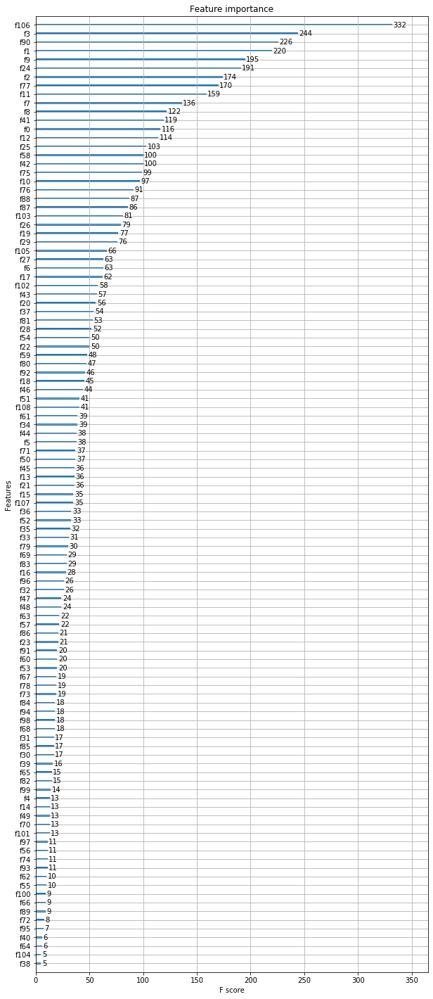

In [79]:
plot_features(bst, (10,25))

### 役に立つ特徴量

In [115]:
cols = list(training.columns)

del cols[cols.index('item_cnt_month')]
[cols[x] for x in [106,3,91,9,24,2,77,11,7,8,41,0,12,25,58]]

['month',
 'item_category_id',
 'item_price_per_item_lag_2',
 'item_cnt_day_per_item_lag_1',
 'item_cnt_month_lag_1',
 'date_block_num',
 'price_std_per_item_lag_1',
 'cnt_day_std_per_item_lag_1',
 'subtype',
 'product_sales_lag_1',
 'item_cnt_month_lag_2',
 'shop_id',
 'sales_std_per_item_lag_1',
 'product_sales_lag_2',
 'item_cnt_month_lag_3']

### 役に立たない特徴量

In [116]:
cols = list(training.columns)

del cols[cols.index('item_cnt_month')]
[cols[x] for x in [38,104,64,40,95]]

['cnt_day_shop_cat_lag_2',
 'item_cnt_month_subtype_city_lag_2',
 'item_cnt_day_per_shop_lag_6',
 'item_cnt_day_city_cat_lag_2',
 'item_price_per_category_lag_2']

In [82]:
xgb_val_predict = xgb.DMatrix(X_valid.values)
val_pred = bst.predict(xgb_val_predict)

pd.Series(val_pred).describe()

count    238172.000000
mean          0.279413
std           0.770876
min          -0.657257
25%           0.031276
50%           0.102544
75%           0.226926
max          20.218468
dtype: float64

In [83]:
from sklearn.linear_model import LinearRegression
from sklearn import preprocessing

In [84]:
category_feat_drop = ['days','type','city_name']

In [85]:
# X_train_lr_pickle = training.drop(category_feat, axis=1)

# for feat in X_train_lr.columns:
#     X_train_lr[feat] = X_train_lr[feat].fillna(X_train_lr[feat].median())

In [86]:
# X_train_lr.date_block_num = X_train_lr.date_block_num.astype(str)
# X_train_lr.to_csv('lr_dataframe.csv',index=False)
# X_train_lr.date_block_num = pd.get_dummies(X_train_lr.date_block_num,sparse=False)      
# scaler = preprocessing.StandardScaler()

# X_train_lr = scaler.fit_transform(X_train_lr)

In [87]:
# lr = LinearRegression()

# lr.fit(X_train_lr, training['item_cnt_month'])

In [88]:
#ensembleのためにpickleファイルに保存する
#training.to_pickle('data.pkl')

In [89]:
for lag in tqdm_notebook(lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num', 'shop_id','item_id'] + lag_cnt_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_feat + '_lag_'  + str(lag) for lag_feat in lag_cnt_variables]
    test = pd.merge(test, sales_new_df, on=['date_block_num','shop_id','item_id'],how='left')

In [90]:
for lag in tqdm_notebook(delta_lags):
    sales_new_df = mean_transactions.copy()
    sales_new_df.date_block_num += lag
    sales_new_df = sales_new_df[['date_block_num', 'shop_id','item_id'] + lag_price_variables]
    sales_new_df.columns = ['date_block_num','shop_id','item_id'] + [lag_feat + '_lag_'  + str(lag) for lag_feat in lag_price_variables]
    test = pd.merge(test, sales_new_df, on=['date_block_num','shop_id','item_id'],how='left')

In [91]:
test.head(10)

,ID,shop_id,item_id,date_block_num,item_name,item_category_id,city_name,city_frequency,type,subtype,product_sales_lag_1,item_cnt_day_per_item_lag_1,sales_per_item_lag_1,cnt_day_std_per_item_lag_1,sales_std_per_item_lag_1,item_cnt_day_per_shop_lag_1,sales_per_shop_lag_1,cnt_day_std_shop_lag_1,sales_std_per_shop_lag_1,item_cnt_day_per_category_lag_1,sales_per_category_lag_1,cnt_day_std_per_category_lag_1,sales_std_per_category_lag_1,cnt_day_shop_cat_lag_1,item_cnt_day_city_lag_1,item_cnt_day_city_cat_lag_1,item_cnt_month_lag_1,product_sales_lag_2,item_cnt_day_per_item_lag_2,sales_per_item_lag_2,cnt_day_std_per_item_lag_2,sales_std_per_item_lag_2,item_cnt_day_per_shop_lag_2,sales_per_shop_lag_2,cnt_day_std_shop_lag_2,sales_std_per_shop_lag_2,item_cnt_day_per_category_lag_2,sales_per_category_lag_2,cnt_day_std_per_category_lag_2,sales_std_per_category_lag_2,cnt_day_shop_cat_lag_2,item_cnt_day_city_lag_2,item_cnt_day_city_cat_lag_2,item_cnt_month_lag_2,product_sales_lag_3,item_cnt_day_per_item_lag_3,sales_per_item_lag_3,cnt_day_std_per_item_lag_3,sales_std_per_item_lag_3,item_cnt_day_per_shop_lag_3,sales_per_shop_lag_3,cnt_day_std_shop_lag_3,sales_std_per_shop_lag_3,item_cnt_day_per_category_lag_3,sales_per_category_lag_3,cnt_day_std_per_category_lag_3,sales_std_per_category_lag_3,cnt_day_shop_cat_lag_3,item_cnt_day_city_lag_3,item_cnt_day_city_cat_lag_3,item_cnt_month_lag_3,product_sales_lag_6,item_cnt_day_per_item_lag_6,sales_per_item_lag_6,cnt_day_std_per_item_lag_6,sales_std_per_item_lag_6,item_cnt_day_per_shop_lag_6,sales_per_shop_lag_6,cnt_day_std_shop_lag_6,sales_std_per_shop_lag_6,item_cnt_day_per_category_lag_6,sales_per_category_lag_6,cnt_day_std_per_category_lag_6,sales_std_per_category_lag_6,cnt_day_shop_cat_lag_6,item_cnt_day_city_lag_6,item_cnt_day_city_cat_lag_6,item_cnt_month_lag_6,item_price_per_item_lag_1,price_std_per_item_lag_1,item_price_per_shop_lag_1,price_std_per_shop_lag_1,item_price_per_category_lag_1,price_std_per_category_lag_1,price_shop_cat_lag_1,item_price_city_lag_1,item_price_city_cat_lag_1,max_price_cat_shop_lag_1,min_price_cat_shop_lag_1,item_cnt_month_per_type_lag_1,item_cnt_month_subtype_lag_1,item_cnt_month_subtype_city_lag_1,item_cnt_month_subtype_shop_lag_1,item_price_per_item_lag_2,price_std_per_item_lag_2,item_price_per_shop_lag_2,price_std_per_shop_lag_2,item_price_per_category_lag_2,price_std_per_category_lag_2,price_shop_cat_lag_2,item_price_city_lag_2,item_price_city_cat_lag_2,max_price_cat_shop_lag_2,min_price_cat_shop_lag_2,item_cnt_month_per_type_lag_2,item_cnt_month_subtype_lag_2,item_cnt_month_subtype_city_lag_2,item_cnt_month_subtype_shop_lag_2
0,0,5,5037,34,"NHL 15 [PS3, русские субтитры]",19,3,0.016667,5,12,0.0,1.000000,1499.000000,0.000000,0.000000,1.090155,1140.12439,0.449938,2012.336304,1.041791,1785.249023,0.304898,1260.846924,1.013514,0.190098,0.513699,0.0,749.5,1.428571,1258.038940,1.657746,1266.470825,1.148265,1231.808594,0.877853,2667.791748,1.273688,1863.874756,1.332492,3326.656006,1.195652,0.2059,0.696203,1.0,2997.5,1.190000,1036.971558,0.544857,457.709259,1.080134,969.072205,0.41916,1915.93335,1.126207,1239.744751,0.519704,765.679199,1.062016,0.245106,0.830303,3.0,1299.0,1.087500,1656.543701,0.284349,583.962952,1.143503,1171.629395,0.902971,3209.707275,1.061991,1494.353638,0.407311,877.990784,1.013699,0.180011,0.432749,1.0,1499.00000,0.000000,1030.721924,1654.235107,1681.477905,835.197998,1548.945923,111.209793,420.219177,3399.0,0.0,0.494105,0.337299,0.447059,0.447059,941.385193,327.270966,1034.784302,1661.687866,1358.810913,846.124573,1355.232666,123.394585,416.793091,3999.0,0.0,0.611331,0.521406,0.647727,0.647727
1,1,5,5320,34,ONE DIRECTION Made In The A.M.,55,3,0.016667,13,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [92]:
# encoder = test.groupby('item_id').size()
# encoder = encoder/len(test)

# test['item_freq'] = test['item_id'].map(encoder)

In [93]:
test = test.drop(['ID','item_name'], axis=1)

In [94]:
for feat in test.columns:
    if 'cnt' in feat:
        test[feat] = test[feat].fillna(0)
    elif 'price' in feat:
        test[feat] = test[feat].fillna(test[feat].median())

In [95]:
test['month'] = test['date_block_num'] % 12
test['month'] = test['month'].astype(np.int8)
test['days'] = 30

In [96]:
test['item_shop_last_sale'] = -1
test['item_shop_last_sale'] = test['item_shop_last_sale'].astype(np.int8)
for row in test.itertuples():
    idx = getattr(row, 'Index')
    item_id = getattr(row, 'item_id')
    shop_id = getattr(row, 'shop_id')
    date_block_num = getattr(row, 'date_block_num')
    key = str(item_id) + ' ' + str(shop_id)
    print(key)
    if key  in cache:
        last_date_block_num = cache[key]
        test.at[idx, 'item_shop_last_sale'] = date_block_num - last_date_block_num
        

test[['item_id','shop_id', 'item_shop_last_sale']].to_pickle('test_item_shop_last_sale.pkl')

# test_item_shop_last_sale = pd.read_pickle('test_item_shop_last_sale.pkl')
# test = pd.merge(test, test_item_shop_last_sale, on=['item_id','shop_id'], how='left')

5037 5
5320 5
5233 5
5232 5
5268 5
5039 5
5041 5
5046 5
5319 5
5003 5
4806 5
4843 5
4607 5
4869 5
4870 5
4872 5
4874 5
4678 5
4892 5
4964 5
4717 5
5002 5
5823 5
5814 5
5900 5
5907 5
5908 5
5643 5
5657 5
5675 5
5666 5
5668 5
5669 5
5672 5
5653 5
5678 5
5674 5
5671 5
5845 5
5841 5
5840 5
5820 5
5821 5
5822 5
5824 5
5826 5
5827 5
5828 5
5829 5
5837 5
5838 5
5839 5
5459 5
5830 5
3731 5
4719 5
3341 5
3343 5
3350 5
3351 5
3352 5
3364 5
3365 5
3537 5
3538 5
3571 5
3676 5
3677 5
3678 5
3686 5
3604 5
3353 5
3334 5
3331 5
3407 5
3408 5
5962 5
3405 5
3423 5
3442 5
3443 5
3444 5
3445 5
3464 5
4244 5
4248 5
4249 5
4107 5
4351 5
4357 5
4365 5
4367 5
4385 5
4389 5
4479 5
4442 5
4363 5
4240 5
4233 5
3732 5
3733 5
3756 5
3835 5
3837 5
3840 5
3831 5
3898 5
3928 5
3967 5
3984 5
4052 5
4053 5
4054 5
4055 5
4228 5
6062 5
8327 5
6002 5
9355 5
9414 5
9395 5
9397 5
9398 5
9405 5
9407 5
9409 5
9391 5
9035 5
9039 5
9165 5
9469 5
9496 5
10200 5
10201 5
9412 5
8546 5
8547 5
8548 5
8550 5
8551 5
8653 5
8658 5
8690

22137 5
22111 5
22106 5
2531 5
2270 5
3027 5
2782 5
2591 5
1969 5
10389 5
8852 5
9019 5
8555 5
9020 5
12482 5
12473 5
12405 5
12317 5
12088 5
12031 5
12206 5
11968 5
12539 5
10455 5
10625 5
11567 5
11046 5
6733 5
6694 5
5541 5
5842 5
6027 5
5667 5
7984 5
6740 5
7384 5
18430 5
18425 5
18417 5
18384 5
18375 5
18361 5
18464 5
19286 5
18192 5
18187 5
18186 5
18184 5
18209 5
18467 5
18501 5
18629 5
18627 5
19341 5
18483 5
18560 5
18523 5
19309 5
19308 5
19317 5
18132 5
17883 5
17847 5
17840 5
18043 5
17890 5
17764 5
18011 5
17898 5
18125 5
18115 5
18108 5
18104 5
17989 5
18091 5
17936 5
17929 5
17757 5
18653 5
18669 5
19464 5
19126 5
19110 5
19093 5
19092 5
19087 5
19085 5
19162 5
19220 5
19210 5
19507 5
19488 5
19478 5
19075 5
18911 5
18884 5
18849 5
18841 5
18835 5
18831 5
18764 5
18759 5
18714 5
18708 5
18746 5
19053 5
19051 5
19050 5
19046 5
19044 5
19015 5
18979 5
19423 5
19422 5
18654 5
17568 5
2707 5
2699 5
2799 5
3023 5
3234 5
3236 5
17403 5
1364 5
17534 5
17479 5
17469 5
17461 5
17

9419 5
7572 5
7925 5
6117 5
6108 5
9030 5
21425 5
3316 5
19024 5
6156 5
7972 5
6882 5
1867 5
20367 5
18883 5
18666 5
18589 5
1041 5
11467 5
12491 5
13515 5
14543 5
19253 5
17957 5
12470 5
7543 5
6661 5
11137 5
11489 5
9782 5
2972 5
19889 5
20650 5
5665 5
9978 5
10767 5
14443 5
14341 5
5401 5
9500 5
16007 5
3280 5
4393 5
4352 5
18049 5
18027 5
18454 5
16188 5
15757 5
19648 5
969 5
5037 4
5320 4
5233 4
5232 4
5268 4
5039 4
5041 4
5046 4
5319 4
5003 4
4806 4
4843 4
4607 4
4869 4
4870 4
4872 4
4874 4
4678 4
4892 4
4964 4
4717 4
5002 4
5823 4
5814 4
5900 4
5907 4
5908 4
5643 4
5657 4
5675 4
5666 4
5668 4
5669 4
5672 4
5653 4
5678 4
5674 4
5671 4
5845 4
5841 4
5840 4
5820 4
5821 4
5822 4
5824 4
5826 4
5827 4
5828 4
5829 4
5837 4
5838 4
5839 4
5459 4
5830 4
3731 4
4719 4
3341 4
3343 4
3350 4
3351 4
3352 4
3364 4
3365 4
3537 4
3538 4
3571 4
3676 4
3677 4
3678 4
3686 4
3604 4
3353 4
3334 4
3331 4
3407 4
3408 4
5962 4
3405 4
3423 4
3442 4
3443 4
3444 4
3445 4
3464 4
4244 4
4248 4
4249 4
4107 4
4

19039 4
19037 4
19036 4
19023 4
19001 4
18704 4
18690 4
18686 4
18680 4
18843 4
17391 4
18140 4
18107 4
18102 4
17982 4
17948 4
17858 4
20374 4
20360 4
20346 4
20336 4
20231 4
20224 4
20099 4
20187 4
20048 4
19888 4
20571 4
20568 4
20540 4
20537 4
20536 4
20464 4
19847 4
19795 4
19503 4
19479 4
19621 4
19691 4
17375 4
15989 4
15560 4
15922 4
15858 4
16031 4
15510 4
15500 4
16036 4
16140 4
16130 4
16120 4
16119 4
16042 4
16097 4
16085 4
16061 4
16098 4
15276 4
15392 4
15490 4
15330 4
15328 4
15326 4
15290 4
17242 4
15572 4
15566 4
16177 4
16174 4
16186 4
16361 4
15793 4
15692 4
15686 4
16313 4
16311 4
8693 4
8687 4
9187 4
8676 4
8672 4
8803 4
8779 4
9206 4
9203 4
8357 4
8615 4
9171 4
8429 4
8809 4
9358 4
9359 4
9065 4
9066 4
9047 4
9403 4
9401 4
9366 4
8918 4
8864 4
8856 4
8825 4
8821 4
9344 4
9010 4
7508 4
7507 4
7459 4
7409 4
7390 4
7267 4
7655 4
7647 4
7256 4
7161 4
7146 4
7668 4
8148 4
8095 4
8093 4
8029 4
8043 4
7998 4
8443 4
7956 4
8182 4
8296 4
8510 4
8238 4
8219 4
8218 4
8214 4


13086 4
12363 4
13325 4
13326 4
14246 4
14135 4
14163 4
14222 4
14193 4
14501 4
14370 4
14310 4
14409 4
12781 4
13520 4
13705 4
13048 4
13812 4
13663 4
13573 4
2839 4
10546 4
8071 4
11179 4
17468 4
16025 4
5912 4
5010 4
6488 4
20677 4
20344 4
20411 4
20408 4
20316 4
20999 4
21254 4
21243 4
21210 4
21208 4
21195 4
21123 4
20998 4
21046 4
21045 4
21007 4
20921 4
20919 4
20916 4
20863 4
20764 4
20747 4
19098 4
19460 4
19979 4
19973 4
6184 4
3985 4
21664 4
21592 4
21733 4
21714 4
21975 4
21974 4
21953 4
21948 4
2129 4
3272 4
3232 4
2637 4
2664 4
454 4
430 4
302 4
173 4
154 4
5831 4
5057 4
3547 4
3989 4
3932 4
9596 4
9162 4
10436 4
8138 4
12216 4
5621 4
5601 4
18707 4
17482 4
14972 4
15472 4
16034 4
13543 4
13403 4
11758 4
11181 4
11236 4
11674 4
11454 4
12569 4
12063 4
12065 4
13079 4
15545 4
14794 4
15702 4
16679 4
16057 4
14140 4
14026 4
13976 4
13674 4
13659 4
13609 4
13605 4
12979 4
14504 4
15033 4
8508 4
10297 4
10423 4
10578 4
9783 4
10823 4
10541 4
10516 4
10977 4
10508 4
10697 4
87

17391 6
18140 6
18107 6
18102 6
17982 6
17948 6
17858 6
20374 6
20360 6
20346 6
20336 6
20231 6
20224 6
20099 6
20187 6
20048 6
19888 6
20571 6
20568 6
20540 6
20537 6
20536 6
20464 6
19847 6
19795 6
19503 6
19479 6
19621 6
19691 6
17375 6
15989 6
15560 6
15922 6
15858 6
16031 6
15510 6
15500 6
16036 6
16140 6
16130 6
16120 6
16119 6
16042 6
16097 6
16085 6
16061 6
16098 6
15276 6
15392 6
15490 6
15330 6
15328 6
15326 6
15290 6
17242 6
15572 6
15566 6
16177 6
16174 6
16186 6
16361 6
15793 6
15692 6
15686 6
16313 6
16311 6
8693 6
8687 6
9187 6
8676 6
8672 6
8803 6
8779 6
9206 6
9203 6
8357 6
8615 6
9171 6
8429 6
8809 6
9358 6
9359 6
9065 6
9066 6
9047 6
9403 6
9401 6
9366 6
8918 6
8864 6
8856 6
8825 6
8821 6
9344 6
9010 6
7508 6
7507 6
7459 6
7409 6
7390 6
7267 6
7655 6
7647 6
7256 6
7161 6
7146 6
7668 6
8148 6
8095 6
8093 6
8029 6
8043 6
7998 6
8443 6
7956 6
8182 6
8296 6
8510 6
8238 6
8219 6
8218 6
8214 6
8491 6
8484 6
8472 6
8469 6
8193 6
9449 6
7843 6
7671 6
7876 6
9451 6
10518 6
10

14246 6
14135 6
14163 6
14222 6
14193 6
14501 6
14370 6
14310 6
14409 6
12781 6
13520 6
13705 6
13048 6
13812 6
13663 6
13573 6
2839 6
10546 6
8071 6
11179 6
17468 6
16025 6
5912 6
5010 6
6488 6
20677 6
20344 6
20411 6
20408 6
20316 6
20999 6
21254 6
21243 6
21210 6
21208 6
21195 6
21123 6
20998 6
21046 6
21045 6
21007 6
20921 6
20919 6
20916 6
20863 6
20764 6
20747 6
19098 6
19460 6
19979 6
19973 6
6184 6
3985 6
21664 6
21592 6
21733 6
21714 6
21975 6
21974 6
21953 6
21948 6
2129 6
3272 6
3232 6
2637 6
2664 6
454 6
430 6
302 6
173 6
154 6
5831 6
5057 6
3547 6
3989 6
3932 6
9596 6
9162 6
10436 6
8138 6
12216 6
5621 6
5601 6
18707 6
17482 6
14972 6
15472 6
16034 6
13543 6
13403 6
11758 6
11181 6
11236 6
11674 6
11454 6
12569 6
12063 6
12065 6
13079 6
15545 6
14794 6
15702 6
16679 6
16057 6
14140 6
14026 6
13976 6
13674 6
13659 6
13609 6
13605 6
12979 6
14504 6
15033 6
8508 6
10297 6
10423 6
10578 6
9783 6
10823 6
10541 6
10516 6
10977 6
10508 6
10697 6
8799 6
8798 6
8797 6
8796 6
9205 6

4414 3
4406 3
4382 3
4138 3
4067 3
4059 3
4242 3
4070 3
6291 3
6695 3
6311 3
6045 3
6040 3
6464 3
6265 3
6259 3
6407 3
6405 3
6202 3
6378 3
6931 3
6815 3
6811 3
6810 3
6806 3
6798 3
6333 3
6826 3
6867 3
6857 3
6855 3
6853 3
6847 3
6332 3
5605 3
5551 3
5543 3
5539 3
5663 3
5659 3
6005 3
5999 3
5995 3
5963 3
5961 3
5959 3
5951 3
5942 3
3541 3
3354 3
3624 3
5467 3
4996 3
4335 3
4710 3
4639 3
1325 3
1215 3
1253 3
1538 3
902 3
892 3
22069 3
22059 3
22105 3
888 3
30 3
22139 3
22137 3
22111 3
22106 3
2531 3
2270 3
3027 3
2782 3
2591 3
1969 3
10389 3
8852 3
9019 3
8555 3
9020 3
12482 3
12473 3
12405 3
12317 3
12088 3
12031 3
12206 3
11968 3
12539 3
10455 3
10625 3
11567 3
11046 3
6733 3
6694 3
5541 3
5842 3
6027 3
5667 3
7984 3
6740 3
7384 3
18430 3
18425 3
18417 3
18384 3
18375 3
18361 3
18464 3
19286 3
18192 3
18187 3
18186 3
18184 3
18209 3
18467 3
18501 3
18629 3
18627 3
19341 3
18483 3
18560 3
18523 3
19309 3
19308 3
19317 3
18132 3
17883 3
17847 3
17840 3
18043 3
17890 3
17764 3
18011 3


16205 2
15446 2
15493 2
15496 2
15507 2
15521 2
15552 2
16003 2
16012 2
16047 2
16221 2
16069 2
16091 2
16103 2
16108 2
16113 2
16115 2
16163 2
16169 2
16195 2
16071 2
18729 2
18743 2
18825 2
19436 2
19438 2
19440 2
19441 2
19080 2
19602 2
19634 2
18688 2
19655 2
19656 2
19659 2
19688 2
18641 2
19295 2
17747 2
17748 2
17775 2
18326 2
18334 2
18397 2
18434 2
18438 2
18439 2
18456 2
18479 2
18499 2
15417 2
15413 2
15401 2
15338 2
13559 2
12778 2
12797 2
12881 2
12935 2
13675 2
13697 2
13706 2
13717 2
13023 2
13518 2
13804 2
13824 2
13867 2
13901 2
14227 2
14229 2
14127 2
14308 2
13415 2
13411 2
13363 2
13400 2
13337 2
13402 2
13452 2
13457 2
10914 2
13458 2
13464 2
13505 2
13409 2
14956 2
19985 2
14396 2
14647 2
14652 2
14807 2
14830 2
14832 2
14839 2
14840 2
15230 2
15238 2
15256 2
15257 2
15270 2
15278 2
15285 2
15069 2
14398 2
14400 2
14421 2
14458 2
14436 2
14437 2
14525 2
14526 2
14532 2
15037 2
15049 2
15063 2
15066 2
14959 2
20192 2
2252 2
2269 2
2271 2
2369 2
2131 2
2152 2
2422 2

20953 2
21021 2
21042 2
20739 2
20751 2
21107 2
21112 2
21681 2
21682 2
22015 2
21619 2
21120 2
21191 2
21196 2
21214 2
21257 2
4391 2
4427 2
4541 2
3000 2
3153 2
3159 2
3160 2
14108 2
2153 2
2183 2
2141 2
2088 2
2623 2
2626 2
1721 2
1815 2
1829 2
3457 2
3290 2
3284 2
3597 2
3500 2
3372 2
3377 2
3168 2
3218 2
3082 2
3096 2
18462 2
18466 2
18484 2
19415 2
19088 2
19183 2
19611 2
14795 2
14865 2
15260 2
16212 2
15035 2
18322 2
18325 2
16826 2
16858 2
16889 2
16997 2
17112 2
17157 2
17320 2
17332 2
16260 2
1515 2
1290 2
1292 2
1322 2
1256 2
153 2
413 2
88 2
72 2
22154 2
59 2
1104 2
1075 2
1012 2
970 2
971 2
1010 2
762 2
4336 2
3992 2
2376 2
2244 2
2090 2
2956 2
2976 2
3079 2
4364 2
6285 2
6519 2
6521 2
6522 2
6523 2
6524 2
6525 2
6526 2
6527 2
6528 2
6529 2
6530 2
6520 2
6532 2
6130 2
6164 2
6624 2
4636 2
4638 2
5470 2
5500 2
17640 2
17641 2
17201 2
17711 2
17225 2
15835 2
16494 2
17364 2
19337 2
19338 2
19339 2
19345 2
19346 2
18696 2
18724 2
19344 2
18587 2
17750 2
18017 2
17963 2
15034

13818 7
13822 7
13860 7
14228 7
14262 7
14274 7
14957 7
14958 7
13309 7
13308 7
12549 7
12563 7
13159 7
12568 7
12612 7
12663 7
12688 7
12696 7
12697 7
12543 7
12698 7
12707 7
12723 7
13210 7
13213 7
13214 7
13216 7
13217 7
12472 7
12382 7
12360 7
11012 7
11056 7
11081 7
11354 7
11159 7
11400 7
8065 7
11488 7
11498 7
11811 7
11655 7
11829 7
11703 7
11785 7
11953 7
12193 7
12194 7
12020 7
12021 7
12023 7
12346 7
13218 7
13225 7
13227 7
13265 7
13266 7
13267 7
13269 7
13272 7
13275 7
13277 7
13278 7
13279 7
13251 7
13281 7
13294 7
13300 7
13301 7
13302 7
13303 7
13250 7
13249 7
13247 7
13232 7
13234 7
13240 7
13241 7
13242 7
13246 7
13226 7
10937 7
14648 7
19773 7
19778 7
20111 7
20125 7
20202 7
20448 7
20454 7
20609 7
20614 7
20615 7
20628 7
18379 7
19291 7
18622 7
18698 7
18913 7
19043 7
19430 7
20644 7
21361 7
21397 7
21442 7
21445 7
21447 7
21708 7
21761 7
21762 7
21942 7
21956 7
21961 7
21968 7
22003 7
21358 7
20305 7
20285 7
20304 7
18259 7
18201 7
17987 7
17945 7
16051 7
16052 7
1

16000 7
16005 7
15926 7
15899 7
15519 7
15520 7
15524 7
15849 7
15885 7
16090 7
16095 7
16096 7
16099 7
16246 7
16037 7
16040 7
16045 7
16046 7
15995 7
15998 7
16064 7
16226 7
17022 7
17030 7
16697 7
16733 7
16910 7
17595 7
17597 7
17598 7
17262 7
17117 7
17124 7
17184 7
16655 7
15624 7
15667 7
15609 7
15673 7
15760 7
15764 7
16316 7
15608 7
15591 7
15586 7
16239 7
16243 7
15574 7
15575 7
16262 7
16267 7
16498 7
16567 7
16613 7
16618 7
16638 7
16349 7
16353 7
15807 7
15821 7
15833 7
15836 7
16469 7
16474 7
14442 7
14447 7
15015 7
14550 7
14573 7
14423 7
14430 7
15103 7
14605 7
15115 7
15118 7
15131 7
15134 7
14627 7
14284 7
14312 7
14033 7
14103 7
14110 7
14121 7
14362 7
14981 7
14987 7
15001 7
14383 7
14393 7
14969 7
15294 7
15488 7
15495 7
15444 7
15304 7
15318 7
15371 7
15397 7
15398 7
15399 7
15406 7
15420 7
15423 7
15229 7
14739 7
15168 7
14786 7
14802 7
14659 7
15161 7
14845 7
15206 7
14891 7
14913 7
15219 7
15220 7
15223 7
15225 7
6025 7
6065 7
6004 7
5914 7
6051 7
6994 7
7203 7

17042 10
17046 10
17131 10
20386 10
5269 10
5242 10
5043 10
5051 10
5060 10
5383 10
5331 10
5747 10
5811 10
4555 10
4557 10
4564 10
4840 10
4873 10
4894 10
4895 10
4966 10
4706 10
6415 10
6421 10
6457 10
6674 10
6687 10
6727 10
6728 10
6505 10
6023 10
5903 10
5905 10
5913 10
5655 10
5658 10
5661 10
5664 10
6073 10
6082 10
4388 10
4387 10
2954 10
3216 10
3244 10
3245 10
4241 10
4349 10
4360 10
3822 10
3546 10
3708 10
3734 10
3839 10
6730 10
15017 10
5904 10
5583 10
5670 10
6129 10
5825 10
6768 10
7005 10
6376 10
4992 10
7067 10
4896 10
3572 10
3635 10
3833 10
3838 10
4721 10
3338 10
3479 10
4769 10
4811 10
4838 10
4722 10
4354 10
3871 10
4056 10
4060 10
4251 10
4271 10
4897 10
7220 10
13236 10
13205 10
13274 10
13285 10
13286 10
13287 10
13298 10
12646 10
12362 10
13122 10
11530 10
12124 10
12134 10
11938 10
11974 10
11983 10
13719 10
13741 10
13826 10
13827 10
14019 10
12957 10
14057 10
14457 10
12826 10
13387 10
10349 10
10346 10
10342 10
7724 10
7728 10
7729 10
7872 10
7982 10
7926 1

14283 10
6254 10
9550 10
14277 10
14280 10
13722 10
13416 10
13447 10
12743 10
11985 10
10892 10
11774 10
12212 10
13076 10
13262 10
13252 10
12610 10
15438 10
20517 10
20405 10
20669 10
16067 10
18257 10
18048 10
18033 10
3935 10
5489 10
4965 10
7924 10
7927 10
7932 10
7252 10
6092 10
6243 10
5572 10
2785 10
2625 10
3462 10
3239 10
6533 10
6620 10
6628 10
6689 10
7936 10
7995 10
7337 10
6189 10
16035 10
15458 10
15447 10
15456 10
15275 10
16264 10
17306 10
17712 10
17321 10
17361 10
17451 10
18025 10
18028 10
18029 10
18032 10
17113 10
16515 10
16585 10
16823 10
16957 10
18036 10
15031 10
13388 10
13390 10
13392 10
13529 10
13753 10
13754 10
13790 10
14130 10
14136 10
14984 10
14472 10
14552 10
13531 10
13556 10
13561 10
12793 10
12882 10
18041 10
18045 10
1254 10
22054 10
571 10
831 10
1879 10
21973 10
19559 10
19968 10
19825 10
19034 10
18968 10
18047 10
17996 10
18131 10
19334 10
18643 10
18739 10
18793 10
21197 10
21407 10
21139 10
21793 10
21794 10
21528 10
21117 10
21105 10
2058

13880 12
13881 12
13903 12
13923 12
14247 12
13370 12
13405 12
7315 12
7331 12
7805 12
7834 12
7839 12
7147 12
7135 12
7133 12
6834 12
6836 12
7047 12
7071 12
7075 12
14252 12
7893 12
9541 12
9784 12
10292 12
10438 12
9413 12
8237 12
8287 12
8766 12
8778 12
8993 12
7727 12
14321 12
1007 12
1224 12
1377 12
1387 12
1391 12
21427 12
1329 12
1465 12
2031 12
1725 12
1717 12
1905 12
15287 12
16121 12
16167 12
16170 12
15706 12
16436 12
15255 12
14389 12
14390 12
15040 12
14710 12
14736 12
14801 12
14809 12
14313 12
19439 12
19454 12
19205 12
19908 12
20104 12
19405 12
20204 12
20463 12
20748 12
19289 12
18380 12
17660 12
17279 12
17888 12
17921 12
18174 12
18280 12
18378 12
16676 12
4548 12
21460 12
21676 12
21683 12
21722 12
21811 12
20286 12
22092 12
1389 12
1409 12
988 12
1557 12
1464 12
975 12
940 12
939 12
22164 12
76 12
758 12
829 12
938 12
18646 12
18734 12
18910 12
18926 12
18944 12
18980 12
19058 12
19116 12
19144 12
19163 12
19033 12
18579 12
19290 12
17772 12
17773 12
17811 12
178

21562 12
5902 12
6513 12
6394 12
6169 12
7884 12
3333 12
3484 12
4962 12
4901 12
17458 12
18042 12
18030 12
17544 12
15857 12
16089 12
20879 12
20488 12
20462 12
19417 12
13260 12
10707 12
10757 12
14318 12
14766 12
14765 12
14760 12
14662 12
13641 12
7059 12
8005 12
7712 12
6546 12
8335 12
2971 12
2777 12
4637 12
986 12
686 12
20912 12
20727 12
2817 12
3182 12
1679 12
1881 12
2354 12
13494 12
16958 12
16543 12
18779 12
18778 12
18777 12
18699 12
15410 12
15319 12
15298 12
16032 12
3943 12
5901 12
4502 12
4885 12
4998 12
1315 12
20832 12
2818 12
3217 12
2523 12
12700 12
15042 12
14833 12
13446 12
8072 12
6690 12
11232 12
10944 12
10891 12
5540 12
4579 12
4397 12
4989 12
4969 12
7211 12
6809 12
6803 12
6675 12
2700 12
1453 12
3714 12
4016 12
3971 12
7734 12
15418 12
18277 12
16077 12
16225 12
10649 12
11011 12
10749 12
10687 12
8172 12
13319 12
11676 12
12710 12
4470 12
5444 12
2703 12
3548 12
3535 12
3344 12
9425 12
8391 12
9894 12
10677 12
11660 12
11309 12
6399 12
6307 12
6342 12
196

17772 28
17773 28
17811 28
17887 28
18101 28
18570 28
18344 28
18360 28
18106 28
19204 28
19219 28
20626 28
20259 28
20264 28
20271 28
20266 28
20610 28
19765 28
19794 28
20041 28
20225 28
20335 28
6128 28
6252 28
6286 28
5906 28
5552 28
5065 28
5380 28
5355 28
5816 28
5896 28
7935 28
8085 28
8178 28
7713 28
8694 28
8702 28
8743 28
8845 28
8868 28
9361 28
7657 28
7790 28
6863 28
7232 28
2484 28
3140 28
2210 28
1775 28
17459 28
3866 28
3656 28
3458 28
3277 28
3286 28
3543 28
3552 28
3580 28
3609 28
17420 28
17374 28
11997 28
12465 28
12498 28
13139 28
12706 28
11931 28
11292 28
10778 28
10812 28
10927 28
10935 28
11435 28
12117 28
11607 28
11690 28
11694 28
11769 28
11770 28
11771 28
11775 28
11575 28
12708 28
13209 28
13399 28
13273 28
13212 28
13220 28
13238 28
10554 28
10480 28
9422 28
8961 28
8967 28
9330 28
9565 28
9365 28
9394 28
9390 28
10378 28
10660 28
10453 28
9976 28
10094 28
10300 28
10529 28
13503 28
13499 28
16086 28
16125 28
16147 28
16160 28
16053 28
16146 28
16184 28
16

15319 28
15298 28
16032 28
3943 28
5901 28
4502 28
4885 28
4998 28
1315 28
20832 28
2818 28
3217 28
2523 28
12700 28
15042 28
14833 28
13446 28
8072 28
6690 28
11232 28
10944 28
10891 28
5540 28
4579 28
4397 28
4989 28
4969 28
7211 28
6809 28
6803 28
6675 28
2700 28
1453 28
3714 28
4016 28
3971 28
7734 28
15418 28
18277 28
16077 28
16225 28
10649 28
11011 28
10749 28
10687 28
8172 28
13319 28
11676 28
12710 28
4470 28
5444 28
2703 28
3548 28
3535 28
3344 28
9425 28
8391 28
9894 28
10677 28
11660 28
11309 28
6399 28
6307 28
6342 28
19642 28
19578 28
19240 28
19651 28
19490 28
18916 28
18715 28
19049 28
20196 28
20093 28
20019 28
20197 28
20218 28
20343 28
19857 28
19839 28
19772 28
19771 28
19751 28
19742 28
19690 28
17388 28
17385 28
17152 28
17637 28
17635 28
17047 28
17566 28
18457 28
18490 28
18363 28
18357 28
18342 28
18333 28
19343 28
19331 28
18572 28
18327 28
18208 28
18069 28
17975 28
18195 28
18146 28
18303 28
22068 28
1359 28
21902 28
21980 28
22013 28
2119 28
20880 28
20862 

3580 31
3609 31
17420 31
17374 31
11997 31
12465 31
12498 31
13139 31
12706 31
11931 31
11292 31
10778 31
10812 31
10927 31
10935 31
11435 31
12117 31
11607 31
11690 31
11694 31
11769 31
11770 31
11771 31
11775 31
11575 31
12708 31
13209 31
13399 31
13273 31
13212 31
13220 31
13238 31
10554 31
10480 31
9422 31
8961 31
8967 31
9330 31
9565 31
9365 31
9394 31
9390 31
10378 31
10660 31
10453 31
9976 31
10094 31
10300 31
10529 31
13503 31
13499 31
16086 31
16125 31
16147 31
16160 31
16053 31
16146 31
16184 31
16016 31
16020 31
15286 31
16013 31
15300 31
15303 31
15511 31
15875 31
16002 31
16019 31
15302 31
16954 31
17108 31
17168 31
17270 31
16937 31
16234 31
16236 31
15594 31
15635 31
15640 31
16287 31
16787 31
16586 31
16735 31
14777 31
13696 31
13699 31
12990 31
13009 31
13040 31
13646 31
13888 31
13889 31
13893 31
13894 31
13919 31
13645 31
13637 31
13536 31
13544 31
12889 31
12958 31
12970 31
13633 31
13635 31
13958 31
17416 31
14476 31
14521 31
14628 31
14751 31
14755 31
14075 31
142

12851 31
12967 31
15936 31
1783 31
1859 31
1683 31
2420 31
2191 31
20561 31
566 31
21388 31
21562 31
5902 31
6513 31
6394 31
6169 31
7884 31
3333 31
3484 31
4962 31
4901 31
17458 31
18042 31
18030 31
17544 31
15857 31
16089 31
20879 31
20488 31
20462 31
19417 31
13260 31
10707 31
10757 31
14318 31
14766 31
14765 31
14760 31
14662 31
13641 31
7059 31
8005 31
7712 31
6546 31
8335 31
2971 31
2777 31
4637 31
986 31
686 31
20912 31
20727 31
2817 31
3182 31
1679 31
1881 31
2354 31
13494 31
16958 31
16543 31
18779 31
18778 31
18777 31
18699 31
15410 31
15319 31
15298 31
16032 31
3943 31
5901 31
4502 31
4885 31
4998 31
1315 31
20832 31
2818 31
3217 31
2523 31
12700 31
15042 31
14833 31
13446 31
8072 31
6690 31
11232 31
10944 31
10891 31
5540 31
4579 31
4397 31
4989 31
4969 31
7211 31
6809 31
6803 31
6675 31
2700 31
1453 31
3714 31
4016 31
3971 31
7734 31
15418 31
18277 31
16077 31
16225 31
10649 31
11011 31
10749 31
10687 31
8172 31
13319 31
11676 31
12710 31
4470 31
5444 31
2703 31
3548 31
35

13209 26
13399 26
13273 26
13212 26
13220 26
13238 26
10554 26
10480 26
9422 26
8961 26
8967 26
9330 26
9565 26
9365 26
9394 26
9390 26
10378 26
10660 26
10453 26
9976 26
10094 26
10300 26
10529 26
13503 26
13499 26
16086 26
16125 26
16147 26
16160 26
16053 26
16146 26
16184 26
16016 26
16020 26
15286 26
16013 26
15300 26
15303 26
15511 26
15875 26
16002 26
16019 26
15302 26
16954 26
17108 26
17168 26
17270 26
16937 26
16234 26
16236 26
15594 26
15635 26
15640 26
16287 26
16787 26
16586 26
16735 26
14777 26
13696 26
13699 26
12990 26
13009 26
13040 26
13646 26
13888 26
13889 26
13893 26
13894 26
13919 26
13645 26
13637 26
13536 26
13544 26
12889 26
12958 26
12970 26
13633 26
13635 26
13958 26
17416 26
14476 26
14521 26
14628 26
14751 26
14755 26
14075 26
14267 26
14286 26
14335 26
14964 26
14967 26
14968 26
14020 26
9463 26
7526 26
7531 26
7592 26
7607 26
7646 26
7879 26
6747 26
6371 26
6903 26
7054 26
7070 26
7085 26
8734 26
8736 26
8737 26
8756 26
8768 26
8863 26
8902 26
8733 26
8919

21625 26
20744 26
12817 26
15850 26
15407 26
16164 26
14101 26
14088 26
15222 26
15124 26
15117 26
15054 26
15584 26
16232 26
15855 26
16157 26
13293 26
13329 26
13327 26
13322 26
13320 26
13318 26
1743 26
20385 26
20338 26
20339 26
18026 26
18039 26
18031 26
18038 26
18044 26
18034 26
20619 26
20883 26
21365 26
21357 26
21284 26
20559 26
20821 26
17531 26
18253 26
17101 26
17620 26
19511 26
18482 26
18393 26
18368 26
18511 26
18939 26
3675 26
10600 26
9914 26
10186 26
9389 26
9388 26
9912 26
9909 26
11603 26
12208 26
11113 26
7440 26
7794 26
7136 26
15151 26
15150 26
15096 26
15116 26
14977 26
15654 26
15653 26
15805 26
16362 26
16573 26
15938 26
15859 26
16094 26
16083 26
16063 26
16028 26
12378 26
13166 26
12542 26
13535 26
5915 26
1809 26
16055 26
19252 26
19613 26
20516 26
10889 26
8352 26
7851 26
12920 26
13511 26
14272 26
10691 26
9951 26
6432 26
6400 26
8793 26
9676 26
8400 26
19119 26
20092 26
15104 26
14666 26
13932 26
15812 26
16166 26
15487 26
15266 26
16087 26
10215 26
102

491 25
80 25
91 25
140 25
249 25
259 25
353 25
428 25
478 25
832 25
835 25
1582 25
1586 25
1816 25
2040 25
837 25
1074 25
1406 25
8951 25
12529 25
13151 25
12671 25
12675 25
12686 25
12701 25
12709 25
13208 25
13306 25
13317 25
13330 25
13331 25
13335 25
13304 25
13336 25
12732 25
13280 25
12501 25
10676 25
10452 25
10507 25
10718 25
10784 25
10651 25
11306 25
11063 25
10633 25
10045 25
10083 25
10334 25
10614 25
10381 25
11132 25
12232 25
12054 25
12064 25
12082 25
12090 25
12333 25
12361 25
12469 25
12475 25
12477 25
12066 25
11930 25
11207 25
11404 25
11534 25
11913 25
13123 25
15395 25
15416 25
15419 25
15459 25
15483 25
15280 25
15484 25
15512 25
15866 25
15868 25
15876 25
15492 25
15279 25
14663 25
14691 25
15162 25
15164 25
15166 25
14784 25
14866 25
15213 25
16009 25
15577 25
15665 25
15739 25
15788 25
15806 25
16534 25
16657 25
16680 25
16721 25
16898 25
16041 25
16043 25
16110 25
16135 25
16153 25
16155 25
16200 25
13653 25
13661 25
13743 25
13745 25
14152 25
13834 25
13628 2

20009 25
19999 25
19998 25
19997 25
2232 25
2490 25
2615 25
2288 25
14197 25
13732 25
13570 25
13412 25
13359 25
12733 25
13343 25
14199 25
15072 25
15071 25
15056 25
14934 25
14208 25
14207 25
14198 25
14205 25
14204 25
14203 25
14202 25
14201 25
14200 25
13341 25
13193 25
13342 25
15073 25
15074 25
16804 25
16803 25
16799 25
16785 25
16398 25
16396 25
16395 25
16388 25
16805 25
16377 25
16376 25
16374 25
16372 25
16371 25
16811 25
16813 25
19282 25
18023 25
18015 25
17702 25
17674 25
16820 25
16366 25
16334 25
16248 25
15988 25
15948 25
15183 25
15142 25
15077 25
15065 25
16278 25
16276 25
16275 25
16273 25
16272 25
16251 25
4893 25
536 25
528 25
524 25
521 25
515 25
508 25
539 25
504 25
505 25
503 25
502 25
492 25
563 25
568 25
798 25
773 25
772 25
688 25
684 25
680 25
676 25
663 25
655 25
653 25
652 25
650 25
649 25
616 25
592 25
585 25
583 25
578 25
656 25
480 25
402 25
342 25
254 25
204 25
180 25
168 25
69 25
797 25
1434 25
1433 25
1432 25
1424 25
1405 25
1394 25
1385 25
1189 25


1857 22
2284 22
1523 22
1241 22
1238 22
1202 22
1199 22
1176 22
1132 22
1102 22
1101 22
1087 22
1249 22
1306 22
1247 22
1257 22
1037 22
445 22
408 22
407 22
388 22
356 22
325 22
313 22
269 22
253 22
248 22
213 22
205 22
202 22
149 22
138 22
308 22
968 22
687 22
1864 22
1817 22
1622 22
1618 22
1579 22
1565 22
1556 22
1555 22
109 22
93 22
21355 22
21110 22
21441 22
21363 22
21386 22
20829 22
20812 22
20800 22
20731 22
20718 22
20680 22
20678 22
20643 22
20831 22
20243 22
20265 22
22050 22
57 22
45 22
42 22
38 22
33 22
21759 22
21732 22
21458 22
21624 22
21955 22
21929 22
21928 22
21842 22
21835 22
21976 22
3282 22
3278 22
3579 22
3707 22
3692 22
3385 22
3485 22
2324 22
2226 22
2187 22
2182 22
2360 22
2078 22
1729 22
1687 22
1686 22
1682 22
1663 22
2287 22
1761 22
2035 22
1988 22
1753 22
1740 22
2951 22
3158 22
3108 22
3080 22
3054 22
3014 22
2550 22
2544 22
2529 22
2508 22
2442 22
2864 22
2634 22
2886 22
13855 22
13058 22
13041 22
13742 22
14254 22
14931 22
14102 22
13968 22
13900 22
135

20476 22
17480 22
18741 22
18476 22
14301 22
13552 22
14176 22
13398 22
11243 22
17981 22
17979 22
14884 22
4790 22
6835 22
2810 22
20958 22
20416 22
15424 22
15451 22
15477 22
15455 22
15321 22
15344 22
15405 22
16123 22
16106 22
15523 22
15924 22
15299 22
14705 22
15214 22
15125 22
15232 22
17756 22
17371 22
17448 22
17392 22
17988 22
18546 22
18530 22
19313 22
18498 22
18411 22
18500 22
18573 22
18675 22
18671 22
18100 22
18278 22
18274 22
18205 22
16351 22
16556 22
16231 22
15595 22
16822 22
17638 22
17625 22
16129 22
16699 22
16595 22
16880 22
17010 22
17015 22
13229 22
12574 22
13168 22
13202 22
12664 22
13276 22
11926 22
11970 22
12514 22
13133 22
13124 22
11984 22
13086 22
12363 22
13325 22
13326 22
14246 22
14135 22
14163 22
14222 22
14193 22
14501 22
14370 22
14310 22
14409 22
12781 22
13520 22
13705 22
13048 22
13812 22
13663 22
13573 22
2839 22
10546 22
8071 22
11179 22
17468 22
16025 22
5912 22
5010 22
6488 22
20677 22
20344 22
20411 22
20408 22
20316 22
20999 22
21254 22


4059 24
4242 24
4070 24
6291 24
6695 24
6311 24
6045 24
6040 24
6464 24
6265 24
6259 24
6407 24
6405 24
6202 24
6378 24
6931 24
6815 24
6811 24
6810 24
6806 24
6798 24
6333 24
6826 24
6867 24
6857 24
6855 24
6853 24
6847 24
6332 24
5605 24
5551 24
5543 24
5539 24
5663 24
5659 24
6005 24
5999 24
5995 24
5963 24
5961 24
5959 24
5951 24
5942 24
3541 24
3354 24
3624 24
5467 24
4996 24
4335 24
4710 24
4639 24
1325 24
1215 24
1253 24
1538 24
902 24
892 24
22069 24
22059 24
22105 24
888 24
30 24
22139 24
22137 24
22111 24
22106 24
2531 24
2270 24
3027 24
2782 24
2591 24
1969 24
10389 24
8852 24
9019 24
8555 24
9020 24
12482 24
12473 24
12405 24
12317 24
12088 24
12031 24
12206 24
11968 24
12539 24
10455 24
10625 24
11567 24
11046 24
6733 24
6694 24
5541 24
5842 24
6027 24
5667 24
7984 24
6740 24
7384 24
18430 24
18425 24
18417 24
18384 24
18375 24
18361 24
18464 24
19286 24
18192 24
18187 24
18186 24
18184 24
18209 24
18467 24
18501 24
18629 24
18627 24
19341 24
18483 24
18560 24
18523 24
193

6676 21
6503 21
6710 21
6729 21
6731 21
6732 21
6083 21
6085 21
6088 21
6152 21
6153 21
6163 21
6185 21
6393 21
6396 21
6226 21
6236 21
6257 21
6426 21
6472 21
6476 21
6496 21
6497 21
6738 21
6064 21
6742 21
7782 21
7789 21
7791 21
7792 21
7836 21
7846 21
7853 21
7462 21
7862 21
7895 21
7948 21
7917 21
7930 21
7931 21
7933 21
8452 21
8456 21
7863 21
7328 21
7187 21
7235 21
6743 21
6335 21
6351 21
6926 21
6928 21
7003 21
7007 21
7029 21
7039 21
7087 21
7172 21
7215 21
7223 21
19657 21
15571 21
16315 21
15740 21
15777 21
15780 21
15786 21
16350 21
15844 21
16788 21
16549 21
16247 21
16629 21
16737 21
16843 21
16946 21
16985 21
17031 21
17717 21
16653 21
16237 21
16205 21
15446 21
15493 21
15496 21
15507 21
15521 21
15552 21
16003 21
16012 21
16047 21
16221 21
16069 21
16091 21
16103 21
16108 21
16113 21
16115 21
16163 21
16169 21
16195 21
16071 21
18729 21
18743 21
18825 21
19436 21
19438 21
19440 21
19441 21
19080 21
19602 21
19634 21
18688 21
19655 21
19656 21
19659 21
19688 21
18641 2

7393 21
7327 21
7286 21
7270 21
7255 21
7231 21
7350 21
6807 21
6353 21
6875 21
7134 21
9211 21
7877 21
8256 21
8249 21
8502 21
8244 21
8112 21
8094 21
8033 21
19305 21
17942 21
18059 21
17848 21
18022 21
18016 21
19048 21
19118 21
16866 21
16601 21
16459 21
15798 21
15784 21
15680 21
17220 21
17104 21
21118 21
21790 21
21485 21
21591 21
20355 21
20354 21
20337 21
19913 21
19969 21
20189 21
13657 21
13630 21
12964 21
13802 21
13723 21
13282 21
13385 21
13381 21
15925 21
15877 21
15499 21
15478 21
15329 21
16187 21
16175 21
16159 21
16136 21
16075 21
16068 21
14971 21
14970 21
15226 21
14903 21
15165 21
3274 21
3263 21
3170 21
2969 21
2600 21
2597 21
2594 21
2585 21
2754 21
2708 21
2461 21
2458 21
2443 21
2819 21
2862 21
2215 21
3329 21
2213 21
1485 21
1297 21
1288 21
1232 21
1133 21
2140 21
2254 21
2062 21
2047 21
1611 21
1754 21
1965 21
1673 21
1856 21
2049 21
8008 21
7741 21
6630 21
12705 21
12504 21
12512 21
12513 21
12523 21
12536 21
12552 21
12558 21
12863 21
13712 21
13720 21
134

2427 15
2196 15
2429 15
1741 15
2293 15
2325 15
2430 15
2696 15
2865 15
2879 15
2937 15
2958 15
2975 15
3007 15
3022 15
3026 15
3077 15
3141 15
3146 15
2838 15
2635 15
2697 15
2492 15
2760 15
2743 15
2753 15
2536 15
2577 15
2581 15
2592 15
2614 15
2789 15
2813 15
3148 15
1963 15
1716 15
1121 15
1131 15
1192 15
1193 15
1201 15
1252 15
1386 15
1388 15
1295 15
1296 15
1298 15
1299 15
1307 15
961 15
787 15
22087 15
22088 15
22091 15
22100 15
22101 15
22102 15
792 15
31 15
32 15
67 15
70 15
464 15
473 15
482 15
486 15
494 15
784 15
22060 15
1324 15
1332 15
1341 15
1837 15
1865 15
1877 15
1878 15
1884 15
1885 15
1669 15
1846 15
1581 15
1496 15
1537 15
1547 15
1570 15
1577 15
1578 15
3237 15
3917 15
3920 15
3953 15
3960 15
3970 15
3916 15
4003 15
4014 15
4045 15
4051 15
4178 15
3735 15
3627 15
3633 15
3641 15
3842 15
3851 15
3868 15
4467 15
4390 15
4408 15
4412 15
4413 15
4415 15
4416 15
4466 15
4420 15
4478 15
13323 15
4445 15
4493 15
4348 15
4181 15
4186 15
4190 15
4225 15
4085 15
4102 15
4

13974 15
14215 15
14216 15
14217 15
14220 15
14223 15
13846 15
13853 15
13698 15
12808 15
13578 15
13588 15
13589 15
13591 15
12857 15
13580 15
12752 15
13549 15
13248 15
13647 15
13650 15
13685 15
13686 15
14224 15
11946 15
11936 15
11924 15
12135 15
11996 15
12332 15
13075 15
12400 15
12408 15
12409 15
12456 15
12459 15
12460 15
13117 15
12097 15
12091 15
12080 15
12083 15
11486 15
11572 15
11574 15
11535 15
11527 15
11255 15
11267 15
11268 15
11479 15
11520 15
11688 15
11773 15
11892 15
11710 15
12463 15
13230 15
13228 15
13223 15
13142 15
12589 15
12590 15
12672 15
12677 15
12591 15
12548 15
13129 15
13211 15
13221 15
13222 15
12693 15
12699 15
13206 15
16142 15
16128 15
16196 15
16191 15
16173 15
16179 15
16180 15
16190 15
15971 15
16000 15
16005 15
15926 15
15899 15
15519 15
15520 15
15524 15
15849 15
15885 15
16090 15
16095 15
16096 15
16099 15
16246 15
16037 15
16040 15
16045 15
16046 15
15995 15
15998 15
16064 15
16226 15
17022 15
17030 15
16697 15
16733 15
16910 15
17595 15
1

1484 16
1560 16
1564 16
1571 16
20404 16
20475 16
20631 16
20734 16
20303 16
21440 16
21622 16
21656 16
21670 16
21843 16
21881 16
2424 16
2787 16
2808 16
2874 16
1970 16
2039 16
2885 16
20395 16
20350 16
15262 16
15265 16
15282 16
15288 16
15348 16
15489 16
15415 16
15497 16
15498 16
16056 16
16118 16
16143 16
16145 16
16182 16
16004 16
15237 16
16784 16
17874 16
17889 16
17978 16
17990 16
19406 16
19125 16
19581 16
19636 16
19813 16
19817 16
20349 16
16790 16
16560 16
16825 16
16988 16
17032 16
17042 16
17046 16
17131 16
20386 16
5269 16
5242 16
5043 16
5051 16
5060 16
5383 16
5331 16
5747 16
5811 16
4555 16
4557 16
4564 16
4840 16
4873 16
4894 16
4895 16
4966 16
4706 16
6415 16
6421 16
6457 16
6674 16
6687 16
6727 16
6728 16
6505 16
6023 16
5903 16
5905 16
5913 16
5655 16
5658 16
5661 16
5664 16
6073 16
6082 16
4388 16
4387 16
2954 16
3216 16
3244 16
3245 16
4241 16
4349 16
4360 16
3822 16
3546 16
3708 16
3734 16
3839 16
6730 16
15017 16
5904 16
5583 16
5670 16
6129 16
5825 16
6768 

7570 16
7580 16
7590 16
7613 16
7634 16
7643 16
7598 16
7452 16
8866 16
8850 16
8957 16
8968 16
8969 16
8769 16
9226 16
8805 16
8808 16
9313 16
9333 16
9334 16
9337 16
9338 16
8760 16
9212 16
8373 16
8386 16
8740 16
9207 16
8731 16
8722 16
8418 16
8428 16
9172 16
9175 16
8684 16
19040 16
19618 16
18710 16
20518 16
14734 16
15334 16
14361 16
15450 16
16461 16
2755 16
21962 16
21678 16
21674 16
1548 16
1587 16
544 16
547 16
14295 16
14283 16
6254 16
9550 16
14277 16
14280 16
13722 16
13416 16
13447 16
12743 16
11985 16
10892 16
11774 16
12212 16
13076 16
13262 16
13252 16
12610 16
15438 16
20517 16
20405 16
20669 16
16067 16
18257 16
18048 16
18033 16
3935 16
5489 16
4965 16
7924 16
7927 16
7932 16
7252 16
6092 16
6243 16
5572 16
2785 16
2625 16
3462 16
3239 16
6533 16
6620 16
6628 16
6689 16
7936 16
7995 16
7337 16
6189 16
16035 16
15458 16
15447 16
15456 16
15275 16
16264 16
17306 16
17712 16
17321 16
17361 16
17451 16
18025 16
18028 16
18029 16
18032 16
17113 16
16515 16
16585 16
1682

10928 18
11593 18
11784 18
11921 18
10918 18
13264 18
13299 18
12805 18
12912 18
12974 18
13636 18
13700 18
13869 18
13880 18
13881 18
13903 18
13923 18
14247 18
13370 18
13405 18
7315 18
7331 18
7805 18
7834 18
7839 18
7147 18
7135 18
7133 18
6834 18
6836 18
7047 18
7071 18
7075 18
14252 18
7893 18
9541 18
9784 18
10292 18
10438 18
9413 18
8237 18
8287 18
8766 18
8778 18
8993 18
7727 18
14321 18
1007 18
1224 18
1377 18
1387 18
1391 18
21427 18
1329 18
1465 18
2031 18
1725 18
1717 18
1905 18
15287 18
16121 18
16167 18
16170 18
15706 18
16436 18
15255 18
14389 18
14390 18
15040 18
14710 18
14736 18
14801 18
14809 18
14313 18
19439 18
19454 18
19205 18
19908 18
20104 18
19405 18
20204 18
20463 18
20748 18
19289 18
18380 18
17660 18
17279 18
17888 18
17921 18
18174 18
18280 18
18378 18
16676 18
4548 18
21460 18
21676 18
21683 18
21722 18
21811 18
20286 18
22092 18
1389 18
1409 18
988 18
1557 18
1464 18
975 18
940 18
939 18
22164 18
76 18
758 18
829 18
938 18
18646 18
18734 18
18910 18
189

10530 18
10158 18
8180 18
13810 18
13948 18
13693 18
11580 18
11764 18
11768 18
11947 18
11948 18
11436 18
11106 18
12028 18
12471 18
12474 18
226 18
421 18
9240 18
8509 18
8513 18
10224 18
9495 18
8482 18
8436 18
8468 18
12485 18
13174 18
13194 18
13383 18
13710 18
13027 18
12838 18
13594 18
10504 18
11302 18
10862 18
12233 18
12441 18
12200 18
11265 18
2235 18
3042 18
3144 18
2426 18
448 18
474 18
477 18
1090 18
790 18
4920 18
4925 18
5202 18
4104 18
5542 18
5272 18
3460 18
3849 18
3472 18
3652 18
6891 18
6345 18
7928 18
8169 18
8534 18
6028 18
6041 18
6191 18
6395 18
12380 18
13401 18
9329 18
8859 18
8410 18
8711 18
8855 18
10390 18
9805 18
2939 18
1454 18
4906 18
5014 18
3651 18
2964 18
3106 18
2540 18
6531 18
6702 18
6713 18
6171 18
17714 18
15785 18
19455 18
17831 18
18219 18
18315 18
14128 18
12764 18
12851 18
12967 18
15936 18
1783 18
1859 18
1683 18
2420 18
2191 18
20561 18
566 18
21388 18
21562 18
5902 18
6513 18
6394 18
6169 18
7884 18
3333 18
3484 18
4962 18
4901 18
17458 1

13888 14
13889 14
13893 14
13894 14
13919 14
13645 14
13637 14
13536 14
13544 14
12889 14
12958 14
12970 14
13633 14
13635 14
13958 14
17416 14
14476 14
14521 14
14628 14
14751 14
14755 14
14075 14
14267 14
14286 14
14335 14
14964 14
14967 14
14968 14
14020 14
9463 14
7526 14
7531 14
7592 14
7607 14
7646 14
7879 14
6747 14
6371 14
6903 14
7054 14
7070 14
7085 14
8734 14
8736 14
8737 14
8756 14
8768 14
8863 14
8902 14
8733 14
8919 14
9275 14
8986 14
9307 14
9308 14
9323 14
9354 14
9399 14
9410 14
8958 14
8732 14
8192 14
8453 14
8454 14
8529 14
8545 14
5246 14
5042 14
5322 14
5472 14
5815 14
4877 14
4141 14
4156 14
4231 14
4247 14
4084 14
4539 14
4540 14
4839 14
4608 14
6386 14
6420 14
6297 14
5843 14
5654 14
5676 14
9424 14
11373 14
11385 14
11237 14
11238 14
11266 14
11430 14
11579 14
11678 14
11704 14
11875 14
11371 14
11372 14
13244 14
13268 14
13270 14
13271 14
13283 14
3424 14
13290 14
13291 14
12132 14
12220 14
12040 14
12231 14
13100 14
13105 14
12467 14
12486 14
13128 14
11369 1

21098 14
21104 14
21283 14
21111 14
7586 14
7342 14
11516 14
9698 14
9032 14
5836 14
5835 14
5834 14
18795 14
20660 14
20656 14
20567 14
18481 14
20827 14
21625 14
20744 14
12817 14
15850 14
15407 14
16164 14
14101 14
14088 14
15222 14
15124 14
15117 14
15054 14
15584 14
16232 14
15855 14
16157 14
13293 14
13329 14
13327 14
13322 14
13320 14
13318 14
1743 14
20385 14
20338 14
20339 14
18026 14
18039 14
18031 14
18038 14
18044 14
18034 14
20619 14
20883 14
21365 14
21357 14
21284 14
20559 14
20821 14
17531 14
18253 14
17101 14
17620 14
19511 14
18482 14
18393 14
18368 14
18511 14
18939 14
3675 14
10600 14
9914 14
10186 14
9389 14
9388 14
9912 14
9909 14
11603 14
12208 14
11113 14
7440 14
7794 14
7136 14
15151 14
15150 14
15096 14
15116 14
14977 14
15654 14
15653 14
15805 14
16362 14
16573 14
15938 14
15859 14
16094 14
16083 14
16063 14
16028 14
12378 14
13166 14
12542 14
13535 14
5915 14
1809 14
16055 14
19252 14
19613 14
20516 14
10889 14
8352 14
7851 14
12920 14
13511 14
14272 14
1069

5654 19
5676 19
9424 19
11373 19
11385 19
11237 19
11238 19
11266 19
11430 19
11579 19
11678 19
11704 19
11875 19
11371 19
11372 19
13244 19
13268 19
13270 19
13271 19
13283 19
3424 19
13290 19
13291 19
12132 19
12220 19
12040 19
12231 19
13100 19
13105 19
12467 19
12486 19
13128 19
11369 19
9928 19
9985 19
10021 19
10028 19
10146 19
10324 19
10351 19
10402 19
10329 19
9465 19
9466 19
9468 19
9513 19
10203 19
10425 19
11370 19
10495 19
10513 19
10777 19
10780 19
10979 19
10990 19
11074 19
11170 19
11365 19
16211 19
16639 19
16975 19
17011 19
17655 19
17785 19
18147 19
18355 19
18685 19
14848 19
15374 19
15411 19
15412 19
15481 19
15513 19
16126 19
16139 19
19431 19
19176 19
21367 19
21612 19
21673 19
21848 19
22022 19
22162 19
19552 19
19597 19
19858 19
20624 19
8077 19
11069 19
11961 19
11975 19
12204 19
10802 19
10072 19
10343 19
10347 19
10751 19
12286 19
51 19
12503 19
12541 19
12927 19
13718 19
14151 19
14064 19
14126 19
13397 19
3028 19
2425 19
2861 19
2866 19
2883 19
2884 19
279

16362 19
16573 19
15938 19
15859 19
16094 19
16083 19
16063 19
16028 19
12378 19
13166 19
12542 19
13535 19
5915 19
1809 19
16055 19
19252 19
19613 19
20516 19
10889 19
8352 19
7851 19
12920 19
13511 19
14272 19
10691 19
9951 19
6432 19
6400 19
8793 19
9676 19
8400 19
19119 19
20092 19
15104 19
14666 19
13932 19
15812 19
16166 19
15487 19
15266 19
16087 19
10215 19
10206 19
10208 19
10204 19
10278 19
10194 19
9534 19
9533 19
10580 19
11285 19
10588 19
10586 19
10585 19
10584 19
10583 19
10582 19
10581 19
9530 19
9107 19
9103 19
8524 19
8516 19
8039 19
7918 19
7967 19
7910 19
9111 19
9526 19
9524 19
9464 19
9459 19
9142 19
9139 19
11286 19
13098 19
13097 19
13099 19
11827 19
11345 19
11296 19
11293 19
11280 19
11279 19
11274 19
11273 19
11272 19
11874 19
11271 19
12115 19
13096 19
13094 19
13080 19
12235 19
12228 19
12223 19
12189 19
12192 19
12191 19
6927 19
6645 19
6627 19
6447 19
6439 19
6437 19
6435 19
6429 19
6430 19
6175 19
6166 19
5569 19
6938 19
6940 19
6948 19
6947 19
6946 19
5

8768 42
8863 42
8902 42
8733 42
8919 42
9275 42
8986 42
9307 42
9308 42
9323 42
9354 42
9399 42
9410 42
8958 42
8732 42
8192 42
8453 42
8454 42
8529 42
8545 42
5246 42
5042 42
5322 42
5472 42
5815 42
4877 42
4141 42
4156 42
4231 42
4247 42
4084 42
4539 42
4540 42
4839 42
4608 42
6386 42
6420 42
6297 42
5843 42
5654 42
5676 42
9424 42
11373 42
11385 42
11237 42
11238 42
11266 42
11430 42
11579 42
11678 42
11704 42
11875 42
11371 42
11372 42
13244 42
13268 42
13270 42
13271 42
13283 42
3424 42
13290 42
13291 42
12132 42
12220 42
12040 42
12231 42
13100 42
13105 42
12467 42
12486 42
13128 42
11369 42
9928 42
9985 42
10021 42
10028 42
10146 42
10324 42
10351 42
10402 42
10329 42
9465 42
9466 42
9468 42
9513 42
10203 42
10425 42
11370 42
10495 42
10513 42
10777 42
10780 42
10979 42
10990 42
11074 42
11170 42
11365 42
16211 42
16639 42
16975 42
17011 42
17655 42
17785 42
18147 42
18355 42
18685 42
14848 42
15374 42
15411 42
15412 42
15481 42
15513 42
16126 42
16139 42
19431 42
19176 42
21367

15423 42
15229 42
14739 42
15168 42
14786 42
14802 42
14659 42
15161 42
14845 42
15206 42
14891 42
14913 42
15219 42
15220 42
15223 42
15225 42
6025 42
6065 42
6004 42
5914 42
6051 42
6994 42
7203 42
6870 42
6281 42
6198 42
6238 42
6408 42
6270 42
4135 42
4072 42
4091 42
4433 42
4480 42
4495 42
4116 42
4312 42
3774 42
3923 42
3951 42
4039 42
8061 42
4535 42
5063 42
5064 42
5240 42
5739 42
5441 42
5460 42
5321 42
5342 42
4676 42
5153 42
5155 42
5156 42
5160 42
5162 42
5168 42
5145 42
5184 42
5189 42
5190 42
5191 42
5187 42
5139 42
5089 42
5091 42
5092 42
5093 42
5095 42
5096 42
5101 42
5115 42
5121 42
5125 42
5128 42
9800 42
9832 42
10237 42
9855 42
9864 42
9920 42
10277 42
10069 42
10092 42
10126 42
10054 42
10283 42
10160 42
10161 42
10164 42
10168 42
10176 42
10287 42
9957 42
9989 42
10267 42
9423 42
9070 42
9071 42
9457 42
9067 42
9518 42
10180 42
9572 42
9580 42
9583 42
9753 42
10310 42
10747 42
10752 42
10753 42
10763 42
10772 42
10782 42
10785 42
10776 42
10483 42
10493 42
10478 

4003 50
4014 50
4045 50
4051 50
4178 50
3735 50
3627 50
3633 50
3641 50
3842 50
3851 50
3868 50
4467 50
4390 50
4408 50
4412 50
4413 50
4415 50
4416 50
4466 50
4420 50
4478 50
13323 50
4445 50
4493 50
4348 50
4181 50
4186 50
4190 50
4225 50
4085 50
4102 50
4103 50
4334 50
4337 50
3719 50
3268 50
3271 50
22006 50
3480 50
3528 50
3554 50
3553 50
3556 50
3598 50
3599 50
3688 50
3695 50
3558 50
3446 50
3459 50
3328 50
3340 50
3349 50
22005 50
22004 50
13463 50
13449 50
12751 50
13558 50
12771 50
12795 50
12796 50
12828 50
12871 50
13460 50
13310 50
13314 50
13328 50
13332 50
13334 50
13338 50
13339 50
13340 50
13367 50
12890 50
14470 50
14477 50
14575 50
15045 50
15047 50
15050 50
14583 50
15112 50
14960 50
13701 50
13703 50
13708 50
13026 50
13805 50
13818 50
13822 50
13860 50
14228 50
14262 50
14274 50
14957 50
14958 50
13309 50
13308 50
12549 50
12563 50
13159 50
12568 50
12612 50
12663 50
12688 50
12696 50
12697 50
12543 50
12698 50
12707 50
12723 50
13210 50
13213 50
13214 50
13216 50

13802 50
13723 50
13282 50
13385 50
13381 50
15925 50
15877 50
15499 50
15478 50
15329 50
16187 50
16175 50
16159 50
16136 50
16075 50
16068 50
14971 50
14970 50
15226 50
14903 50
15165 50
3274 50
3263 50
3170 50
2969 50
2600 50
2597 50
2594 50
2585 50
2754 50
2708 50
2461 50
2458 50
2443 50
2819 50
2862 50
2215 50
3329 50
2213 50
1485 50
1297 50
1288 50
1232 50
1133 50
2140 50
2254 50
2062 50
2047 50
1611 50
1754 50
1965 50
1673 50
1856 50
2049 50
8008 50
7741 50
6630 50
12705 50
12504 50
12512 50
12513 50
12523 50
12536 50
12552 50
12558 50
12863 50
13712 50
13720 50
13445 50
9151 50
9420 50
8685 50
8802 50
10827 50
11431 50
11631 50
11723 50
11765 50
11915 50
11973 50
10661 50
496 50
1023 50
237 50
1880 50
20953 50
21021 50
21042 50
20739 50
20751 50
21107 50
21112 50
21681 50
21682 50
22015 50
21619 50
21120 50
21191 50
21196 50
21214 50
21257 50
4391 50
4427 50
4541 50
3000 50
3153 50
3159 50
3160 50
14108 50
2153 50
2183 50
2141 50
2088 50
2623 50
2626 50
1721 50
1815 50
1829 50


18438 49
18439 49
18456 49
18479 49
18499 49
15417 49
15413 49
15401 49
15338 49
13559 49
12778 49
12797 49
12881 49
12935 49
13675 49
13697 49
13706 49
13717 49
13023 49
13518 49
13804 49
13824 49
13867 49
13901 49
14227 49
14229 49
14127 49
14308 49
13415 49
13411 49
13363 49
13400 49
13337 49
13402 49
13452 49
13457 49
10914 49
13458 49
13464 49
13505 49
13409 49
14956 49
19985 49
14396 49
14647 49
14652 49
14807 49
14830 49
14832 49
14839 49
14840 49
15230 49
15238 49
15256 49
15257 49
15270 49
15278 49
15285 49
15069 49
14398 49
14400 49
14421 49
14458 49
14436 49
14437 49
14525 49
14526 49
14532 49
15037 49
15049 49
15063 49
15066 49
14959 49
20192 49
2252 49
2269 49
2271 49
2369 49
2131 49
2152 49
2422 49
2423 49
2431 49
2678 49
2698 49
2690 49
2470 49
2327 49
1732 49
2283 49
2285 49
2286 49
2297 49
2308 49
2322 49
2323 49
2326 49
2569 49
2574 49
2576 49
2936 49
2946 49
2955 49
2959 49
2966 49
2663 49
3071 49
3072 49
3076 49
2921 49
3101 49
3221 49
3238 49
3243 49
3107 49
2919 4

1012 49
970 49
971 49
1010 49
762 49
4336 49
3992 49
2376 49
2244 49
2090 49
2956 49
2976 49
3079 49
4364 49
6285 49
6519 49
6521 49
6522 49
6523 49
6524 49
6525 49
6526 49
6527 49
6528 49
6529 49
6530 49
6520 49
6532 49
6130 49
6164 49
6624 49
4636 49
4638 49
5470 49
5500 49
17640 49
17641 49
17201 49
17711 49
17225 49
15835 49
16494 49
17364 49
19337 49
19338 49
19339 49
19345 49
19346 49
18696 49
18724 49
19344 49
18587 49
17750 49
18017 49
17963 49
15034 49
14479 49
13934 49
14258 49
14407 49
15548 49
16038 49
15289 49
14892 49
19463 49
234 49
315 49
21826 49
21864 49
1334 49
20072 49
20185 49
20195 49
20393 49
20394 49
19957 49
19981 49
20837 49
20717 49
15283 49
15267 49
15295 49
15167 49
15171 49
15172 49
15228 49
15897 49
15898 49
15900 49
15564 49
15892 49
16050 49
16054 49
16093 49
16058 49
16102 49
15889 49
15878 49
15414 49
15494 49
15503 49
15504 49
15870 49
16111 49
14125 49
13651 49
13656 49
13695 49
13702 49
13716 49
15088 49
15106 49
15093 49
14962 49
14979 49
16112 49

11655 53
11829 53
11703 53
11785 53
11953 53
12193 53
12194 53
12020 53
12021 53
12023 53
12346 53
13218 53
13225 53
13227 53
13265 53
13266 53
13267 53
13269 53
13272 53
13275 53
13277 53
13278 53
13279 53
13251 53
13281 53
13294 53
13300 53
13301 53
13302 53
13303 53
13250 53
13249 53
13247 53
13232 53
13234 53
13240 53
13241 53
13242 53
13246 53
13226 53
10937 53
14648 53
19773 53
19778 53
20111 53
20125 53
20202 53
20448 53
20454 53
20609 53
20614 53
20615 53
20628 53
18379 53
19291 53
18622 53
18698 53
18913 53
19043 53
19430 53
20644 53
21361 53
21397 53
21442 53
21445 53
21447 53
21708 53
21761 53
21762 53
21942 53
21956 53
21961 53
21968 53
22003 53
21358 53
20305 53
20285 53
20304 53
18259 53
18201 53
17987 53
17945 53
16051 53
16052 53
16073 53
16076 53
16079 53
16116 53
16117 53
16122 53
16141 53
16156 53
16193 53
16197 53
16206 53
16208 53
16209 53
15553 53
15546 53
14668 53
14711 53
14803 53
14808 53
15239 53
15240 53
15261 53
15281 53
15284 53
15291 53
15323 53
15402 53
1

16243 53
15574 53
15575 53
16262 53
16267 53
16498 53
16567 53
16613 53
16618 53
16638 53
16349 53
16353 53
15807 53
15821 53
15833 53
15836 53
16469 53
16474 53
14442 53
14447 53
15015 53
14550 53
14573 53
14423 53
14430 53
15103 53
14605 53
15115 53
15118 53
15131 53
15134 53
14627 53
14284 53
14312 53
14033 53
14103 53
14110 53
14121 53
14362 53
14981 53
14987 53
15001 53
14383 53
14393 53
14969 53
15294 53
15488 53
15495 53
15444 53
15304 53
15318 53
15371 53
15397 53
15398 53
15399 53
15406 53
15420 53
15423 53
15229 53
14739 53
15168 53
14786 53
14802 53
14659 53
15161 53
14845 53
15206 53
14891 53
14913 53
15219 53
15220 53
15223 53
15225 53
6025 53
6065 53
6004 53
5914 53
6051 53
6994 53
7203 53
6870 53
6281 53
6198 53
6238 53
6408 53
6270 53
4135 53
4072 53
4091 53
4433 53
4480 53
4495 53
4116 53
4312 53
3774 53
3923 53
3951 53
4039 53
8061 53
4535 53
5063 53
5064 53
5240 53
5739 53
5441 53
5460 53
5321 53
5342 53
4676 53
5153 53
5155 53
5156 53
5160 53
5162 53
5168 53
5145 53

4811 52
4838 52
4722 52
4354 52
3871 52
4056 52
4060 52
4251 52
4271 52
4897 52
7220 52
13236 52
13205 52
13274 52
13285 52
13286 52
13287 52
13298 52
12646 52
12362 52
13122 52
11530 52
12124 52
12134 52
11938 52
11974 52
11983 52
13719 52
13741 52
13826 52
13827 52
14019 52
12957 52
14057 52
14457 52
12826 52
13387 52
10349 52
10346 52
10342 52
7724 52
7728 52
7729 52
7872 52
7982 52
7926 52
7934 52
7723 52
7937 52
8455 52
8457 52
8543 52
8544 52
7856 52
7224 52
7230 52
7780 52
7807 52
7809 52
7838 52
7840 52
7842 52
8549 52
8416 52
10211 52
10333 52
10336 52
8735 52
8738 52
8569 52
8826 52
8898 52
8930 52
9015 52
9404 52
9167 52
4261 52
4455 52
4359 52
4395 52
4063 52
4143 52
3622 52
3823 52
4049 52
4050 52
4424 52
5812 52
5911 52
5581 52
4634 52
4669 52
5204 52
4980 52
4999 52
5025 52
3713 52
5634 52
3605 52
3115 52
3394 52
2445 52
2744 52
2853 52
3342 52
3557 52
3447 52
5638 52
9786 52
9795 52
9862 52
9972 52
10043 52
10132 52
10190 52
9532 52
8596 52
8624 52
8656 52
8704 52
8816 

10892 52
11774 52
12212 52
13076 52
13262 52
13252 52
12610 52
15438 52
20517 52
20405 52
20669 52
16067 52
18257 52
18048 52
18033 52
3935 52
5489 52
4965 52
7924 52
7927 52
7932 52
7252 52
6092 52
6243 52
5572 52
2785 52
2625 52
3462 52
3239 52
6533 52
6620 52
6628 52
6689 52
7936 52
7995 52
7337 52
6189 52
16035 52
15458 52
15447 52
15456 52
15275 52
16264 52
17306 52
17712 52
17321 52
17361 52
17451 52
18025 52
18028 52
18029 52
18032 52
17113 52
16515 52
16585 52
16823 52
16957 52
18036 52
15031 52
13388 52
13390 52
13392 52
13529 52
13753 52
13754 52
13790 52
14130 52
14136 52
14984 52
14472 52
14552 52
13531 52
13556 52
13561 52
12793 52
12882 52
18041 52
18045 52
1254 52
22054 52
571 52
831 52
1879 52
21973 52
19559 52
19968 52
19825 52
19034 52
18968 52
18047 52
17996 52
18131 52
19334 52
18643 52
18739 52
18793 52
21197 52
21407 52
21139 52
21793 52
21794 52
21528 52
21117 52
21105 52
20588 52
20627 52
20830 52
20881 52
3273 52
3034 52
3335 52
2781 52
2869 52
2871 52
4979 52


8993 47
7727 47
14321 47
1007 47
1224 47
1377 47
1387 47
1391 47
21427 47
1329 47
1465 47
2031 47
1725 47
1717 47
1905 47
15287 47
16121 47
16167 47
16170 47
15706 47
16436 47
15255 47
14389 47
14390 47
15040 47
14710 47
14736 47
14801 47
14809 47
14313 47
19439 47
19454 47
19205 47
19908 47
20104 47
19405 47
20204 47
20463 47
20748 47
19289 47
18380 47
17660 47
17279 47
17888 47
17921 47
18174 47
18280 47
18378 47
16676 47
4548 47
21460 47
21676 47
21683 47
21722 47
21811 47
20286 47
22092 47
1389 47
1409 47
988 47
1557 47
1464 47
975 47
940 47
939 47
22164 47
76 47
758 47
829 47
938 47
18646 47
18734 47
18910 47
18926 47
18944 47
18980 47
19058 47
19116 47
19144 47
19163 47
19033 47
18579 47
19290 47
17772 47
17773 47
17811 47
17887 47
18101 47
18570 47
18344 47
18360 47
18106 47
19204 47
19219 47
20626 47
20259 47
20264 47
20271 47
20266 47
20610 47
19765 47
19794 47
20041 47
20225 47
20335 47
6128 47
6252 47
6286 47
5906 47
5552 47
5065 47
5380 47
5355 47
5816 47
5896 47
7935 47
80

16032 47
3943 47
5901 47
4502 47
4885 47
4998 47
1315 47
20832 47
2818 47
3217 47
2523 47
12700 47
15042 47
14833 47
13446 47
8072 47
6690 47
11232 47
10944 47
10891 47
5540 47
4579 47
4397 47
4989 47
4969 47
7211 47
6809 47
6803 47
6675 47
2700 47
1453 47
3714 47
4016 47
3971 47
7734 47
15418 47
18277 47
16077 47
16225 47
10649 47
11011 47
10749 47
10687 47
8172 47
13319 47
11676 47
12710 47
4470 47
5444 47
2703 47
3548 47
3535 47
3344 47
9425 47
8391 47
9894 47
10677 47
11660 47
11309 47
6399 47
6307 47
6342 47
19642 47
19578 47
19240 47
19651 47
19490 47
18916 47
18715 47
19049 47
20196 47
20093 47
20019 47
20197 47
20218 47
20343 47
19857 47
19839 47
19772 47
19771 47
19751 47
19742 47
19690 47
17388 47
17385 47
17152 47
17637 47
17635 47
17047 47
17566 47
18457 47
18490 47
18363 47
18357 47
18342 47
18333 47
19343 47
19331 47
18572 47
18327 47
18208 47
18069 47
17975 47
18195 47
18146 47
18303 47
22068 47
1359 47
21902 47
21980 47
22013 47
2119 47
20880 47
20862 47
20843 47
20834 

14663 48
14691 48
15162 48
15164 48
15166 48
14784 48
14866 48
15213 48
16009 48
15577 48
15665 48
15739 48
15788 48
15806 48
16534 48
16657 48
16680 48
16721 48
16898 48
16041 48
16043 48
16110 48
16135 48
16153 48
16155 48
16200 48
13653 48
13661 48
13743 48
13745 48
14152 48
13834 48
13628 48
12802 48
12830 48
12860 48
12891 48
12917 48
12961 48
13632 48
10039 48
15027 48
15052 48
15067 48
14124 48
14253 48
14282 48
14963 48
10032 48
10005 48
6057 48
6007 48
5684 48
5943 48
5945 48
5946 48
5950 48
5953 48
5956 48
6186 48
6247 48
6249 48
6641 48
6316 48
6678 48
5660 48
5012 48
5044 48
5361 48
5362 48
4841 48
4628 48
4679 48
4904 48
4944 48
5210 48
5005 48
5844 48
5656 48
5352 48
5469 48
5488 48
5490 48
5497 48
5517 48
16922 48
9208 48
8744 48
8801 48
8570 48
8862 48
8867 48
8871 48
8365 48
8398 48
9321 48
9882 48
9949 48
9980 48
9054 48
9478 48
9507 48
8226 48
7173 48
7458 48
7499 48
7018 48
6350 48
6837 48
6861 48
6996 48
7524 48
7730 48
7878 48
7882 48
7929 48
8012 48
8044 48
8035 

14203 48
14202 48
14201 48
14200 48
13341 48
13193 48
13342 48
15073 48
15074 48
16804 48
16803 48
16799 48
16785 48
16398 48
16396 48
16395 48
16388 48
16805 48
16377 48
16376 48
16374 48
16372 48
16371 48
16811 48
16813 48
19282 48
18023 48
18015 48
17702 48
17674 48
16820 48
16366 48
16334 48
16248 48
15988 48
15948 48
15183 48
15142 48
15077 48
15065 48
16278 48
16276 48
16275 48
16273 48
16272 48
16251 48
4893 48
536 48
528 48
524 48
521 48
515 48
508 48
539 48
504 48
505 48
503 48
502 48
492 48
563 48
568 48
798 48
773 48
772 48
688 48
684 48
680 48
676 48
663 48
655 48
653 48
652 48
650 48
649 48
616 48
592 48
585 48
583 48
578 48
656 48
480 48
402 48
342 48
254 48
204 48
180 48
168 48
69 48
797 48
1434 48
1433 48
1432 48
1424 48
1405 48
1394 48
1385 48
1189 48
1184 48
1182 48
1177 48
1175 48
1156 48
1100 48
927 48
924 48
907 48
900 48
1435 48
1562 48
1559 48
1519 48
1493 48
1492 48
1436 48
1506 48
868 48
859 48
805 48
803 48
801 48
800 48
799 48
858 48
856 48
849 48
846 48
843 

45 57
42 57
38 57
33 57
21759 57
21732 57
21458 57
21624 57
21955 57
21929 57
21928 57
21842 57
21835 57
21976 57
3282 57
3278 57
3579 57
3707 57
3692 57
3385 57
3485 57
2324 57
2226 57
2187 57
2182 57
2360 57
2078 57
1729 57
1687 57
1686 57
1682 57
1663 57
2287 57
1761 57
2035 57
1988 57
1753 57
1740 57
2951 57
3158 57
3108 57
3080 57
3054 57
3014 57
2550 57
2544 57
2529 57
2508 57
2442 57
2864 57
2634 57
2886 57
13855 57
13058 57
13041 57
13742 57
14254 57
14931 57
14102 57
13968 57
13900 57
13587 57
13586 57
13579 57
12803 57
13542 57
13541 57
13631 57
13030 57
13029 57
13011 57
13691 57
13688 57
13678 57
13667 57
13665 57
13654 57
13649 57
13634 57
14712 57
14709 57
15169 57
14690 57
14664 57
15128 57
15221 57
15217 57
14831 57
14844 57
15087 57
14386 57
14973 57
14966 57
14965 57
14961 57
15048 57
14500 57
12478 57
12468 57
12466 57
12451 57
13113 57
12421 57
12337 57
11242 57
11133 57
11391 57
10989 57
10934 57
11766 57
11763 57
11711 57
11685 57
11526 57
11523 57
11521 57
12515 

20593 57
17976 57
18975 57
14153 57
14899 57
9199 57
10007 57
16059 57
979 57
1541 57
1294 57
18105 57
21488 57
21825 57
20212 57
19799 57
7004 57
9873 57
9821 57
10306 57
11060 57
8696 57
5035 57
4356 57
5899 57
16675 57
15375 57
20206 57
20577 57
20569 57
20535 57
20476 57
17480 57
18741 57
18476 57
14301 57
13552 57
14176 57
13398 57
11243 57
17981 57
17979 57
14884 57
4790 57
6835 57
2810 57
20958 57
20416 57
15424 57
15451 57
15477 57
15455 57
15321 57
15344 57
15405 57
16123 57
16106 57
15523 57
15924 57
15299 57
14705 57
15214 57
15125 57
15232 57
17756 57
17371 57
17448 57
17392 57
17988 57
18546 57
18530 57
19313 57
18498 57
18411 57
18500 57
18573 57
18675 57
18671 57
18100 57
18278 57
18274 57
18205 57
16351 57
16556 57
16231 57
15595 57
16822 57
17638 57
17625 57
16129 57
16699 57
16595 57
16880 57
17010 57
17015 57
13229 57
12574 57
13168 57
13202 57
12664 57
13276 57
11926 57
11970 57
12514 57
13133 57
13124 57
11984 57
13086 57
12363 57
13325 57
13326 57
14246 57
14135 5

2544 58
2529 58
2508 58
2442 58
2864 58
2634 58
2886 58
13855 58
13058 58
13041 58
13742 58
14254 58
14931 58
14102 58
13968 58
13900 58
13587 58
13586 58
13579 58
12803 58
13542 58
13541 58
13631 58
13030 58
13029 58
13011 58
13691 58
13688 58
13678 58
13667 58
13665 58
13654 58
13649 58
13634 58
14712 58
14709 58
15169 58
14690 58
14664 58
15128 58
15221 58
15217 58
14831 58
14844 58
15087 58
14386 58
14973 58
14966 58
14965 58
14961 58
15048 58
14500 58
12478 58
12468 58
12466 58
12451 58
13113 58
12421 58
12337 58
11242 58
11133 58
11391 58
10989 58
10934 58
11766 58
11763 58
11711 58
11685 58
11526 58
11523 58
11521 58
12515 58
13284 58
13253 58
12550 58
12544 58
13231 58
18620 58
18619 58
18595 58
18571 58
18543 58
18445 58
18370 58
18341 58
18320 58
18677 58
18679 58
19045 58
19039 58
19037 58
19036 58
19023 58
19001 58
18704 58
18690 58
18686 58
18680 58
18843 58
17391 58
18140 58
18107 58
18102 58
17982 58
17948 58
17858 58
20374 58
20360 58
20346 58
20336 58
20231 58
20224 58

18049 58
18027 58
18454 58
16188 58
15757 58
19648 58
969 58
5037 59
5320 59
5233 59
5232 59
5268 59
5039 59
5041 59
5046 59
5319 59
5003 59
4806 59
4843 59
4607 59
4869 59
4870 59
4872 59
4874 59
4678 59
4892 59
4964 59
4717 59
5002 59
5823 59
5814 59
5900 59
5907 59
5908 59
5643 59
5657 59
5675 59
5666 59
5668 59
5669 59
5672 59
5653 59
5678 59
5674 59
5671 59
5845 59
5841 59
5840 59
5820 59
5821 59
5822 59
5824 59
5826 59
5827 59
5828 59
5829 59
5837 59
5838 59
5839 59
5459 59
5830 59
3731 59
4719 59
3341 59
3343 59
3350 59
3351 59
3352 59
3364 59
3365 59
3537 59
3538 59
3571 59
3676 59
3677 59
3678 59
3686 59
3604 59
3353 59
3334 59
3331 59
3407 59
3408 59
5962 59
3405 59
3423 59
3442 59
3443 59
3444 59
3445 59
3464 59
4244 59
4248 59
4249 59
4107 59
4351 59
4357 59
4365 59
4367 59
4385 59
4389 59
4479 59
4442 59
4363 59
4240 59
4233 59
3732 59
3733 59
3756 59
3835 59
3837 59
3840 59
3831 59
3898 59
3928 59
3967 59
3984 59
4052 59
4053 59
4054 59
4055 59
4228 59
6062 59
8327 59
600

18132 59
17883 59
17847 59
17840 59
18043 59
17890 59
17764 59
18011 59
17898 59
18125 59
18115 59
18108 59
18104 59
17989 59
18091 59
17936 59
17929 59
17757 59
18653 59
18669 59
19464 59
19126 59
19110 59
19093 59
19092 59
19087 59
19085 59
19162 59
19220 59
19210 59
19507 59
19488 59
19478 59
19075 59
18911 59
18884 59
18849 59
18841 59
18835 59
18831 59
18764 59
18759 59
18714 59
18708 59
18746 59
19053 59
19051 59
19050 59
19046 59
19044 59
19015 59
18979 59
19423 59
19422 59
18654 59
17568 59
2707 59
2699 59
2799 59
3023 59
3234 59
3236 59
17403 59
1364 59
17534 59
17479 59
17469 59
17461 59
17452 59
17440 59
17419 59
19588 59
1916 59
1813 59
2036 59
2059 59
1467 59
19590 59
21001 59
20996 59
21010 59
20952 59
20951 59
21069 59
21113 59
21374 59
21366 59
21103 59
21342 59
21270 59
21213 59
21207 59
21137 59
21136 59
21119 59
21116 59
21114 59
21354 59
20882 59
20845 59
20844 59
20833 59
20909 59
20803 59
20760 59
20752 59
20749 59
20743 59
20736 59
20801 59
20918 59
20274 59
2191

15401 55
15338 55
13559 55
12778 55
12797 55
12881 55
12935 55
13675 55
13697 55
13706 55
13717 55
13023 55
13518 55
13804 55
13824 55
13867 55
13901 55
14227 55
14229 55
14127 55
14308 55
13415 55
13411 55
13363 55
13400 55
13337 55
13402 55
13452 55
13457 55
10914 55
13458 55
13464 55
13505 55
13409 55
14956 55
19985 55
14396 55
14647 55
14652 55
14807 55
14830 55
14832 55
14839 55
14840 55
15230 55
15238 55
15256 55
15257 55
15270 55
15278 55
15285 55
15069 55
14398 55
14400 55
14421 55
14458 55
14436 55
14437 55
14525 55
14526 55
14532 55
15037 55
15049 55
15063 55
15066 55
14959 55
20192 55
2252 55
2269 55
2271 55
2369 55
2131 55
2152 55
2422 55
2423 55
2431 55
2678 55
2698 55
2690 55
2470 55
2327 55
1732 55
2283 55
2285 55
2286 55
2297 55
2308 55
2322 55
2323 55
2326 55
2569 55
2574 55
2576 55
2936 55
2946 55
2955 55
2959 55
2966 55
2663 55
3071 55
3072 55
3076 55
2921 55
3101 55
3221 55
3238 55
3243 55
3107 55
2919 55
2578 55
2607 55
2779 55
2780 55
2788 55
2816 55
2852 55
2859 

15926 55
15899 55
15519 55
15520 55
15524 55
15849 55
15885 55
16090 55
16095 55
16096 55
16099 55
16246 55
16037 55
16040 55
16045 55
16046 55
15995 55
15998 55
16064 55
16226 55
17022 55
17030 55
16697 55
16733 55
16910 55
17595 55
17597 55
17598 55
17262 55
17117 55
17124 55
17184 55
16655 55
15624 55
15667 55
15609 55
15673 55
15760 55
15764 55
16316 55
15608 55
15591 55
15586 55
16239 55
16243 55
15574 55
15575 55
16262 55
16267 55
16498 55
16567 55
16613 55
16618 55
16638 55
16349 55
16353 55
15807 55
15821 55
15833 55
15836 55
16469 55
16474 55
14442 55
14447 55
15015 55
14550 55
14573 55
14423 55
14430 55
15103 55
14605 55
15115 55
15118 55
15131 55
15134 55
14627 55
14284 55
14312 55
14033 55
14103 55
14110 55
14121 55
14362 55
14981 55
14987 55
15001 55
14383 55
14393 55
14969 55
15294 55
15488 55
15495 55
15444 55
15304 55
15318 55
15371 55
15397 55
15398 55
15399 55
15406 55
15420 55
15423 55
15229 55
14739 55
15168 55
14786 55
14802 55
14659 55
15161 55
14845 55
15206 55
1

6730 56
15017 56
5904 56
5583 56
5670 56
6129 56
5825 56
6768 56
7005 56
6376 56
4992 56
7067 56
4896 56
3572 56
3635 56
3833 56
3838 56
4721 56
3338 56
3479 56
4769 56
4811 56
4838 56
4722 56
4354 56
3871 56
4056 56
4060 56
4251 56
4271 56
4897 56
7220 56
13236 56
13205 56
13274 56
13285 56
13286 56
13287 56
13298 56
12646 56
12362 56
13122 56
11530 56
12124 56
12134 56
11938 56
11974 56
11983 56
13719 56
13741 56
13826 56
13827 56
14019 56
12957 56
14057 56
14457 56
12826 56
13387 56
10349 56
10346 56
10342 56
7724 56
7728 56
7729 56
7872 56
7982 56
7926 56
7934 56
7723 56
7937 56
8455 56
8457 56
8543 56
8544 56
7856 56
7224 56
7230 56
7780 56
7807 56
7809 56
7838 56
7840 56
7842 56
8549 56
8416 56
10211 56
10333 56
10336 56
8735 56
8738 56
8569 56
8826 56
8898 56
8930 56
9015 56
9404 56
9167 56
4261 56
4455 56
4359 56
4395 56
4063 56
4143 56
3622 56
3823 56
4049 56
4050 56
4424 56
5812 56
5911 56
5581 56
4634 56
4669 56
5204 56
4980 56
4999 56
5025 56
3713 56
5634 56
3605 56
3115 56

21793 56
21794 56
21528 56
21117 56
21105 56
20588 56
20627 56
20830 56
20881 56
3273 56
3034 56
3335 56
2781 56
2869 56
2871 56
4979 56
4553 56
5055 56
3913 56
13407 56
14678 56
14137 56
10230 56
9509 56
10887 56
12116 56
20726 56
1544 56
1204 56
21692 56
83 56
20017 56
15688 56
15776 56
16604 56
16690 56
14836 56
17204 56
17244 56
19127 56
19132 56
19580 56
19644 56
19658 56
17931 56
18617 56
16105 56
15467 56
16885 56
16953 56
17653 56
15698 56
15797 56
17237 56
14846 56
14850 56
14673 56
14822 56
14828 56
21400 56
20729 56
20884 56
20903 56
166 56
21443 56
18623 56
18945 56
19041 56
17302 56
20334 56
20407 56
20487 56
19072 56
9089 56
10530 56
10158 56
8180 56
13810 56
13948 56
13693 56
11580 56
11764 56
11768 56
11947 56
11948 56
11436 56
11106 56
12028 56
12471 56
12474 56
226 56
421 56
9240 56
8509 56
8513 56
10224 56
9495 56
8482 56
8436 56
8468 56
12485 56
13174 56
13194 56
13383 56
13710 56
13027 56
12838 56
13594 56
10504 56
11302 56
10862 56
12233 56
12441 56
12200 56
11265

8737 36
8756 36
8768 36
8863 36
8902 36
8733 36
8919 36
9275 36
8986 36
9307 36
9308 36
9323 36
9354 36
9399 36
9410 36
8958 36
8732 36
8192 36
8453 36
8454 36
8529 36
8545 36
5246 36
5042 36
5322 36
5472 36
5815 36
4877 36
4141 36
4156 36
4231 36
4247 36
4084 36
4539 36
4540 36
4839 36
4608 36
6386 36
6420 36
6297 36
5843 36
5654 36
5676 36
9424 36
11373 36
11385 36
11237 36
11238 36
11266 36
11430 36
11579 36
11678 36
11704 36
11875 36
11371 36
11372 36
13244 36
13268 36
13270 36
13271 36
13283 36
3424 36
13290 36
13291 36
12132 36
12220 36
12040 36
12231 36
13100 36
13105 36
12467 36
12486 36
13128 36
11369 36
9928 36
9985 36
10021 36
10028 36
10146 36
10324 36
10351 36
10402 36
10329 36
9465 36
9466 36
9468 36
9513 36
10203 36
10425 36
11370 36
10495 36
10513 36
10777 36
10780 36
10979 36
10990 36
11074 36
11170 36
11365 36
16211 36
16639 36
16975 36
17011 36
17655 36
17785 36
18147 36
18355 36
18685 36
14848 36
15374 36
15411 36
15412 36
15481 36
15513 36
16126 36
16139 36
19431 3

15116 36
14977 36
15654 36
15653 36
15805 36
16362 36
16573 36
15938 36
15859 36
16094 36
16083 36
16063 36
16028 36
12378 36
13166 36
12542 36
13535 36
5915 36
1809 36
16055 36
19252 36
19613 36
20516 36
10889 36
8352 36
7851 36
12920 36
13511 36
14272 36
10691 36
9951 36
6432 36
6400 36
8793 36
9676 36
8400 36
19119 36
20092 36
15104 36
14666 36
13932 36
15812 36
16166 36
15487 36
15266 36
16087 36
10215 36
10206 36
10208 36
10204 36
10278 36
10194 36
9534 36
9533 36
10580 36
11285 36
10588 36
10586 36
10585 36
10584 36
10583 36
10582 36
10581 36
9530 36
9107 36
9103 36
8524 36
8516 36
8039 36
7918 36
7967 36
7910 36
9111 36
9526 36
9524 36
9464 36
9459 36
9142 36
9139 36
11286 36
13098 36
13097 36
13099 36
11827 36
11345 36
11296 36
11293 36
11280 36
11279 36
11274 36
11273 36
11272 36
11874 36
11271 36
12115 36
13096 36
13094 36
13080 36
12235 36
12228 36
12223 36
12189 36
12192 36
12191 36
6927 36
6645 36
6627 36
6447 36
6439 36
6437 36
6435 36
6429 36
6430 36
6175 36
6166 36
5569

16680 37
16721 37
16898 37
16041 37
16043 37
16110 37
16135 37
16153 37
16155 37
16200 37
13653 37
13661 37
13743 37
13745 37
14152 37
13834 37
13628 37
12802 37
12830 37
12860 37
12891 37
12917 37
12961 37
13632 37
10039 37
15027 37
15052 37
15067 37
14124 37
14253 37
14282 37
14963 37
10032 37
10005 37
6057 37
6007 37
5684 37
5943 37
5945 37
5946 37
5950 37
5953 37
5956 37
6186 37
6247 37
6249 37
6641 37
6316 37
6678 37
5660 37
5012 37
5044 37
5361 37
5362 37
4841 37
4628 37
4679 37
4904 37
4944 37
5210 37
5005 37
5844 37
5656 37
5352 37
5469 37
5488 37
5490 37
5497 37
5517 37
16922 37
9208 37
8744 37
8801 37
8570 37
8862 37
8867 37
8871 37
8365 37
8398 37
9321 37
9882 37
9949 37
9980 37
9054 37
9478 37
9507 37
8226 37
7173 37
7458 37
7499 37
7018 37
6350 37
6837 37
6861 37
6996 37
7524 37
7730 37
7878 37
7882 37
7929 37
8012 37
8044 37
8035 37
8110 37
8162 37
8164 37
8166 37
8191 37
7793 37
7653 37
4554 37
3934 37
4008 37
5036 37
4993 37
4871 37
3421 37
3778 37
3477 37
7213 37
7673 

13322 37
13320 37
13318 37
1743 37
20385 37
20338 37
20339 37
18026 37
18039 37
18031 37
18038 37
18044 37
18034 37
20619 37
20883 37
21365 37
21357 37
21284 37
20559 37
20821 37
17531 37
18253 37
17101 37
17620 37
19511 37
18482 37
18393 37
18368 37
18511 37
18939 37
3675 37
10600 37
9914 37
10186 37
9389 37
9388 37
9912 37
9909 37
11603 37
12208 37
11113 37
7440 37
7794 37
7136 37
15151 37
15150 37
15096 37
15116 37
14977 37
15654 37
15653 37
15805 37
16362 37
16573 37
15938 37
15859 37
16094 37
16083 37
16063 37
16028 37
12378 37
13166 37
12542 37
13535 37
5915 37
1809 37
16055 37
19252 37
19613 37
20516 37
10889 37
8352 37
7851 37
12920 37
13511 37
14272 37
10691 37
9951 37
6432 37
6400 37
8793 37
9676 37
8400 37
19119 37
20092 37
15104 37
14666 37
13932 37
15812 37
16166 37
15487 37
15266 37
16087 37
10215 37
10206 37
10208 37
10204 37
10278 37
10194 37
9534 37
9533 37
10580 37
11285 37
10588 37
10586 37
10585 37
10584 37
10583 37
10582 37
10581 37
9530 37
9107 37
9103 37
8524 37


13283 35
3424 35
13290 35
13291 35
12132 35
12220 35
12040 35
12231 35
13100 35
13105 35
12467 35
12486 35
13128 35
11369 35
9928 35
9985 35
10021 35
10028 35
10146 35
10324 35
10351 35
10402 35
10329 35
9465 35
9466 35
9468 35
9513 35
10203 35
10425 35
11370 35
10495 35
10513 35
10777 35
10780 35
10979 35
10990 35
11074 35
11170 35
11365 35
16211 35
16639 35
16975 35
17011 35
17655 35
17785 35
18147 35
18355 35
18685 35
14848 35
15374 35
15411 35
15412 35
15481 35
15513 35
16126 35
16139 35
19431 35
19176 35
21367 35
21612 35
21673 35
21848 35
22022 35
22162 35
19552 35
19597 35
19858 35
20624 35
8077 35
11069 35
11961 35
11975 35
12204 35
10802 35
10072 35
10343 35
10347 35
10751 35
12286 35
51 35
12503 35
12541 35
12927 35
13718 35
14151 35
14064 35
14126 35
13397 35
3028 35
2425 35
2861 35
2866 35
2883 35
2884 35
2791 35
3758 35
3760 35
3832 35
3862 35
3908 35
3945 35
3755 35
3673 35
3689 35
2050 35
701 35
719 35
640 35
794 35
806 35
639 35
638 35
491 35
80 35
91 35
140 35
249 35
2

7541 35
7124 35
7109 35
7095 35
6959 35
6958 35
6957 35
6956 35
6955 35
6952 35
7094 35
7093 35
7088 35
7058 35
7057 35
7042 35
7038 35
7008 35
6960 35
7104 35
4898 35
53 35
22166 35
21995 35
21978 35
21803 35
21486 35
1231 35
19442 35
19427 35
19426 35
19425 35
19399 35
19354 35
19347 35
19325 35
19310 35
19288 35
19443 35
19996 35
20956 35
20183 35
20025 35
20016 35
20012 35
20009 35
19999 35
19998 35
19997 35
2232 35
2490 35
2615 35
2288 35
14197 35
13732 35
13570 35
13412 35
13359 35
12733 35
13343 35
14199 35
15072 35
15071 35
15056 35
14934 35
14208 35
14207 35
14198 35
14205 35
14204 35
14203 35
14202 35
14201 35
14200 35
13341 35
13193 35
13342 35
15073 35
15074 35
16804 35
16803 35
16799 35
16785 35
16398 35
16396 35
16395 35
16388 35
16805 35
16377 35
16376 35
16374 35
16372 35
16371 35
16811 35
16813 35
19282 35
18023 35
18015 35
17702 35
17674 35
16820 35
16366 35
16334 35
16248 35
15988 35
15948 35
15183 35
15142 35
15077 35
15065 35
16278 35
16276 35
16275 35
16273 35
162

1663 38
2287 38
1761 38
2035 38
1988 38
1753 38
1740 38
2951 38
3158 38
3108 38
3080 38
3054 38
3014 38
2550 38
2544 38
2529 38
2508 38
2442 38
2864 38
2634 38
2886 38
13855 38
13058 38
13041 38
13742 38
14254 38
14931 38
14102 38
13968 38
13900 38
13587 38
13586 38
13579 38
12803 38
13542 38
13541 38
13631 38
13030 38
13029 38
13011 38
13691 38
13688 38
13678 38
13667 38
13665 38
13654 38
13649 38
13634 38
14712 38
14709 38
15169 38
14690 38
14664 38
15128 38
15221 38
15217 38
14831 38
14844 38
15087 38
14386 38
14973 38
14966 38
14965 38
14961 38
15048 38
14500 38
12478 38
12468 38
12466 38
12451 38
13113 38
12421 38
12337 38
11242 38
11133 38
11391 38
10989 38
10934 38
11766 38
11763 38
11711 38
11685 38
11526 38
11523 38
11521 38
12515 38
13284 38
13253 38
12550 38
12544 38
13231 38
18620 38
18619 38
18595 38
18571 38
18543 38
18445 38
18370 38
18341 38
18320 38
18677 38
18679 38
19045 38
19039 38
19037 38
19036 38
19023 38
19001 38
18704 38
18690 38
18686 38
18680 38
18843 38
1739

10436 38
8138 38
12216 38
5621 38
5601 38
18707 38
17482 38
14972 38
15472 38
16034 38
13543 38
13403 38
11758 38
11181 38
11236 38
11674 38
11454 38
12569 38
12063 38
12065 38
13079 38
15545 38
14794 38
15702 38
16679 38
16057 38
14140 38
14026 38
13976 38
13674 38
13659 38
13609 38
13605 38
12979 38
14504 38
15033 38
8508 38
10297 38
10423 38
10578 38
9783 38
10823 38
10541 38
10516 38
10977 38
10508 38
10697 38
8799 38
8798 38
8797 38
8796 38
9205 38
9012 38
9377 38
9419 38
7572 38
7925 38
6117 38
6108 38
9030 38
21425 38
3316 38
19024 38
6156 38
7972 38
6882 38
1867 38
20367 38
18883 38
18666 38
18589 38
1041 38
11467 38
12491 38
13515 38
14543 38
19253 38
17957 38
12470 38
7543 38
6661 38
11137 38
11489 38
9782 38
2972 38
19889 38
20650 38
5665 38
9978 38
10767 38
14443 38
14341 38
5401 38
9500 38
16007 38
3280 38
4393 38
4352 38
18049 38
18027 38
18454 38
16188 38
15757 38
19648 38
969 38
5037 34
5320 34
5233 34
5232 34
5268 34
5039 34
5041 34
5046 34
5319 34
5003 34
4806 34
4843

19967 34
19814 34
20126 34
20046 34
19789 34
19902 34
19898 34
19885 34
19884 34
19852 34
19900 34
20214 34
20217 34
20617 34
20623 34
20625 34
20730 34
20725 34
20694 34
20600 34
20599 34
20605 34
20377 34
20352 34
20347 34
20219 34
20413 34
20594 34
20586 34
20581 34
20570 34
20565 34
20529 34
20512 34
20461 34
20456 34
20439 34
13239 34
5897 34
6312 34
6275 34
5997 34
6234 34
6190 34
6127 34
4090 34
4117 34
4285 34
3769 34
3634 34
3902 34
3990 34
5270 34
5241 34
5341 34
5397 34
4583 34
4531 34
4837 34
4707 34
4907 34
4653 34
9740 34
9665 34
9056 34
9411 34
9349 34
9335 34
9322 34
8888 34
9400 34
10405 34
10517 34
10488 34
10631 34
9930 34
9797 34
10304 34
10143 34
10099 34
7398 34
7397 34
7393 34
7327 34
7286 34
7270 34
7255 34
7231 34
7350 34
6807 34
6353 34
6875 34
7134 34
9211 34
7877 34
8256 34
8249 34
8502 34
8244 34
8112 34
8094 34
8033 34
19305 34
17942 34
18059 34
17848 34
18022 34
18016 34
19048 34
19118 34
16866 34
16601 34
16459 34
15798 34
15784 34
15680 34
17220 34
1710

1388 46
1295 46
1296 46
1298 46
1299 46
1307 46
961 46
787 46
22087 46
22088 46
22091 46
22100 46
22101 46
22102 46
792 46
31 46
32 46
67 46
70 46
464 46
473 46
482 46
486 46
494 46
784 46
22060 46
1324 46
1332 46
1341 46
1837 46
1865 46
1877 46
1878 46
1884 46
1885 46
1669 46
1846 46
1581 46
1496 46
1537 46
1547 46
1570 46
1577 46
1578 46
3237 46
3917 46
3920 46
3953 46
3960 46
3970 46
3916 46
4003 46
4014 46
4045 46
4051 46
4178 46
3735 46
3627 46
3633 46
3641 46
3842 46
3851 46
3868 46
4467 46
4390 46
4408 46
4412 46
4413 46
4415 46
4416 46
4466 46
4420 46
4478 46
13323 46
4445 46
4493 46
4348 46
4181 46
4186 46
4190 46
4225 46
4085 46
4102 46
4103 46
4334 46
4337 46
3719 46
3268 46
3271 46
22006 46
3480 46
3528 46
3554 46
3553 46
3556 46
3598 46
3599 46
3688 46
3695 46
3558 46
3446 46
3459 46
3328 46
3340 46
3349 46
22005 46
22004 46
13463 46
13449 46
12751 46
13558 46
12771 46
12795 46
12796 46
12828 46
12871 46
13460 46
13310 46
13314 46
13328 46
13332 46
13334 46
13338 46
13339 

11924 46
12135 46
11996 46
12332 46
13075 46
12400 46
12408 46
12409 46
12456 46
12459 46
12460 46
13117 46
12097 46
12091 46
12080 46
12083 46
11486 46
11572 46
11574 46
11535 46
11527 46
11255 46
11267 46
11268 46
11479 46
11520 46
11688 46
11773 46
11892 46
11710 46
12463 46
13230 46
13228 46
13223 46
13142 46
12589 46
12590 46
12672 46
12677 46
12591 46
12548 46
13129 46
13211 46
13221 46
13222 46
12693 46
12699 46
13206 46
16142 46
16128 46
16196 46
16191 46
16173 46
16179 46
16180 46
16190 46
15971 46
16000 46
16005 46
15926 46
15899 46
15519 46
15520 46
15524 46
15849 46
15885 46
16090 46
16095 46
16096 46
16099 46
16246 46
16037 46
16040 46
16045 46
16046 46
15995 46
15998 46
16064 46
16226 46
17022 46
17030 46
16697 46
16733 46
16910 46
17595 46
17597 46
17598 46
17262 46
17117 46
17124 46
17184 46
16655 46
15624 46
15667 46
15609 46
15673 46
15760 46
15764 46
16316 46
15608 46
15591 46
15586 46
16239 46
16243 46
15574 46
15575 46
16262 46
16267 46
16498 46
16567 46
16613 46
1

5670 41
6129 41
5825 41
6768 41
7005 41
6376 41
4992 41
7067 41
4896 41
3572 41
3635 41
3833 41
3838 41
4721 41
3338 41
3479 41
4769 41
4811 41
4838 41
4722 41
4354 41
3871 41
4056 41
4060 41
4251 41
4271 41
4897 41
7220 41
13236 41
13205 41
13274 41
13285 41
13286 41
13287 41
13298 41
12646 41
12362 41
13122 41
11530 41
12124 41
12134 41
11938 41
11974 41
11983 41
13719 41
13741 41
13826 41
13827 41
14019 41
12957 41
14057 41
14457 41
12826 41
13387 41
10349 41
10346 41
10342 41
7724 41
7728 41
7729 41
7872 41
7982 41
7926 41
7934 41
7723 41
7937 41
8455 41
8457 41
8543 41
8544 41
7856 41
7224 41
7230 41
7780 41
7807 41
7809 41
7838 41
7840 41
7842 41
8549 41
8416 41
10211 41
10333 41
10336 41
8735 41
8738 41
8569 41
8826 41
8898 41
8930 41
9015 41
9404 41
9167 41
4261 41
4455 41
4359 41
4395 41
4063 41
4143 41
3622 41
3823 41
4049 41
4050 41
4424 41
5812 41
5911 41
5581 41
4634 41
4669 41
5204 41
4980 41
4999 41
5025 41
3713 41
5634 41
3605 41
3115 41
3394 41
2445 41
2744 41
2853 41


20884 41
20903 41
166 41
21443 41
18623 41
18945 41
19041 41
17302 41
20334 41
20407 41
20487 41
19072 41
9089 41
10530 41
10158 41
8180 41
13810 41
13948 41
13693 41
11580 41
11764 41
11768 41
11947 41
11948 41
11436 41
11106 41
12028 41
12471 41
12474 41
226 41
421 41
9240 41
8509 41
8513 41
10224 41
9495 41
8482 41
8436 41
8468 41
12485 41
13174 41
13194 41
13383 41
13710 41
13027 41
12838 41
13594 41
10504 41
11302 41
10862 41
12233 41
12441 41
12200 41
11265 41
2235 41
3042 41
3144 41
2426 41
448 41
474 41
477 41
1090 41
790 41
4920 41
4925 41
5202 41
4104 41
5542 41
5272 41
3460 41
3849 41
3472 41
3652 41
6891 41
6345 41
7928 41
8169 41
8534 41
6028 41
6041 41
6191 41
6395 41
12380 41
13401 41
9329 41
8859 41
8410 41
8711 41
8855 41
10390 41
9805 41
2939 41
1454 41
4906 41
5014 41
3651 41
2964 41
3106 41
2540 41
6531 41
6702 41
6713 41
6171 41
17714 41
15785 41
19455 41
17831 41
18219 41
18315 41
14128 41
12764 41
12851 41
12967 41
15936 41
1783 41
1859 41
1683 41
2420 41
2191 41

6747 44
6371 44
6903 44
7054 44
7070 44
7085 44
8734 44
8736 44
8737 44
8756 44
8768 44
8863 44
8902 44
8733 44
8919 44
9275 44
8986 44
9307 44
9308 44
9323 44
9354 44
9399 44
9410 44
8958 44
8732 44
8192 44
8453 44
8454 44
8529 44
8545 44
5246 44
5042 44
5322 44
5472 44
5815 44
4877 44
4141 44
4156 44
4231 44
4247 44
4084 44
4539 44
4540 44
4839 44
4608 44
6386 44
6420 44
6297 44
5843 44
5654 44
5676 44
9424 44
11373 44
11385 44
11237 44
11238 44
11266 44
11430 44
11579 44
11678 44
11704 44
11875 44
11371 44
11372 44
13244 44
13268 44
13270 44
13271 44
13283 44
3424 44
13290 44
13291 44
12132 44
12220 44
12040 44
12231 44
13100 44
13105 44
12467 44
12486 44
13128 44
11369 44
9928 44
9985 44
10021 44
10028 44
10146 44
10324 44
10351 44
10402 44
10329 44
9465 44
9466 44
9468 44
9513 44
10203 44
10425 44
11370 44
10495 44
10513 44
10777 44
10780 44
10979 44
10990 44
11074 44
11170 44
11365 44
16211 44
16639 44
16975 44
17011 44
17655 44
17785 44
18147 44
18355 44
18685 44
14848 44
15374 

11285 44
10588 44
10586 44
10585 44
10584 44
10583 44
10582 44
10581 44
9530 44
9107 44
9103 44
8524 44
8516 44
8039 44
7918 44
7967 44
7910 44
9111 44
9526 44
9524 44
9464 44
9459 44
9142 44
9139 44
11286 44
13098 44
13097 44
13099 44
11827 44
11345 44
11296 44
11293 44
11280 44
11279 44
11274 44
11273 44
11272 44
11874 44
11271 44
12115 44
13096 44
13094 44
13080 44
12235 44
12228 44
12223 44
12189 44
12192 44
12191 44
6927 44
6645 44
6627 44
6447 44
6439 44
6437 44
6435 44
6429 44
6430 44
6175 44
6166 44
5569 44
6938 44
6940 44
6948 44
6947 44
6946 44
5768 44
5761 44
5296 44
5294 44
5282 44
5007 44
5001 44
5196 44
4954 44
4946 44
4905 44
4903 44
4900 44
4959 44
5759 44
5757 44
5731 44
5722 44
5721 44
5704 44
5386 44
5382 44
5376 44
5367 44
5365 44
6951 44
7966 44
7722 44
7717 44
7841 44
7835 44
7817 44
7667 44
7781 44
7766 44
7748 44
7746 44
7541 44
7124 44
7109 44
7095 44
6959 44
6958 44
6957 44
6956 44
6955 44
6952 44
7094 44
7093 44
7088 44
7058 44
7057 44
7042 44
7038 44
7008 44

17107 39
17662 39
17229 39
17290 39
18109 39
21548 39
18129 39
19244 39
19576 39
19948 39
19650 39
19487 39
19155 39
18181 39
18200 39
18255 39
18497 39
18672 39
18719 39
18924 39
19094 39
19117 39
18163 39
2688 39
2778 39
2639 39
2851 39
2671 39
3393 39
2652 39
2867 39
2872 39
2880 39
2940 39
62 39
21827 39
21828 39
21906 39
22071 39
22104 39
21706 39
1857 39
2284 39
1523 39
1241 39
1238 39
1202 39
1199 39
1176 39
1132 39
1102 39
1101 39
1087 39
1249 39
1306 39
1247 39
1257 39
1037 39
445 39
408 39
407 39
388 39
356 39
325 39
313 39
269 39
253 39
248 39
213 39
205 39
202 39
149 39
138 39
308 39
968 39
687 39
1864 39
1817 39
1622 39
1618 39
1579 39
1565 39
1556 39
1555 39
109 39
93 39
21355 39
21110 39
21441 39
21363 39
21386 39
20829 39
20812 39
20800 39
20731 39
20718 39
20680 39
20678 39
20643 39
20831 39
20243 39
20265 39
22050 39
57 39
45 39
42 39
38 39
33 39
21759 39
21732 39
21458 39
21624 39
21955 39
21929 39
21928 39
21842 39
21835 39
21976 39
3282 39
3278 39
3579 39
3707 39
3

18573 39
18675 39
18671 39
18100 39
18278 39
18274 39
18205 39
16351 39
16556 39
16231 39
15595 39
16822 39
17638 39
17625 39
16129 39
16699 39
16595 39
16880 39
17010 39
17015 39
13229 39
12574 39
13168 39
13202 39
12664 39
13276 39
11926 39
11970 39
12514 39
13133 39
13124 39
11984 39
13086 39
12363 39
13325 39
13326 39
14246 39
14135 39
14163 39
14222 39
14193 39
14501 39
14370 39
14310 39
14409 39
12781 39
13520 39
13705 39
13048 39
13812 39
13663 39
13573 39
2839 39
10546 39
8071 39
11179 39
17468 39
16025 39
5912 39
5010 39
6488 39
20677 39
20344 39
20411 39
20408 39
20316 39
20999 39
21254 39
21243 39
21210 39
21208 39
21195 39
21123 39
20998 39
21046 39
21045 39
21007 39
20921 39
20919 39
20916 39
20863 39
20764 39
20747 39
19098 39
19460 39
19979 39
19973 39
6184 39
3985 39
21664 39
21592 39
21733 39
21714 39
21975 39
21974 39
21953 39
21948 39
2129 39
3272 39
3232 39
2637 39
2664 39
454 39
430 39
302 39
173 39
154 39
5831 39
5057 39
3547 39
3989 39
3932 39
9596 39
9162 39
104

6378 45
6931 45
6815 45
6811 45
6810 45
6806 45
6798 45
6333 45
6826 45
6867 45
6857 45
6855 45
6853 45
6847 45
6332 45
5605 45
5551 45
5543 45
5539 45
5663 45
5659 45
6005 45
5999 45
5995 45
5963 45
5961 45
5959 45
5951 45
5942 45
3541 45
3354 45
3624 45
5467 45
4996 45
4335 45
4710 45
4639 45
1325 45
1215 45
1253 45
1538 45
902 45
892 45
22069 45
22059 45
22105 45
888 45
30 45
22139 45
22137 45
22111 45
22106 45
2531 45
2270 45
3027 45
2782 45
2591 45
1969 45
10389 45
8852 45
9019 45
8555 45
9020 45
12482 45
12473 45
12405 45
12317 45
12088 45
12031 45
12206 45
11968 45
12539 45
10455 45
10625 45
11567 45
11046 45
6733 45
6694 45
5541 45
5842 45
6027 45
5667 45
7984 45
6740 45
7384 45
18430 45
18425 45
18417 45
18384 45
18375 45
18361 45
18464 45
19286 45
18192 45
18187 45
18186 45
18184 45
18209 45
18467 45
18501 45
18629 45
18627 45
19341 45
18483 45
18560 45
18523 45
19309 45
19308 45
19317 45
18132 45
17883 45
17847 45
17840 45
18043 45
17890 45
17764 45
18011 45
17898 45
18125 4

In [97]:
#test.to_pickle('test_data.pkl')

In [98]:
xgbpredict = xgb.DMatrix(test.values)

In [99]:
test.columns[-20:]

Index(['item_cnt_month_subtype_city_lag_1',
       'item_cnt_month_subtype_shop_lag_1', 'item_price_per_item_lag_2',
       'price_std_per_item_lag_2', 'item_price_per_shop_lag_2',
       'price_std_per_shop_lag_2', 'item_price_per_category_lag_2',
       'price_std_per_category_lag_2', 'price_shop_cat_lag_2',
       'item_price_city_lag_2', 'item_price_city_cat_lag_2',
       'max_price_cat_shop_lag_2', 'min_price_cat_shop_lag_2',
       'item_cnt_month_per_type_lag_2', 'item_cnt_month_subtype_lag_2',
       'item_cnt_month_subtype_city_lag_2',
       'item_cnt_month_subtype_shop_lag_2', 'month', 'days',
       'item_shop_last_sale'],
      dtype='object')

In [100]:
training.columns[-20:]

Index(['item_cnt_month_subtype_city_lag_1',
       'item_cnt_month_subtype_shop_lag_1', 'item_price_per_item_lag_2',
       'price_std_per_item_lag_2', 'item_price_per_shop_lag_2',
       'price_std_per_shop_lag_2', 'item_price_per_category_lag_2',
       'price_std_per_category_lag_2', 'price_shop_cat_lag_2',
       'item_price_city_lag_2', 'item_price_city_cat_lag_2',
       'max_price_cat_shop_lag_2', 'min_price_cat_shop_lag_2',
       'item_cnt_month_per_type_lag_2', 'item_cnt_month_subtype_lag_2',
       'item_cnt_month_subtype_city_lag_2',
       'item_cnt_month_subtype_shop_lag_2', 'month', 'days',
       'item_shop_last_sale'],
      dtype='object')

In [101]:
diff = list( set(training.columns) -set(test.columns))
diff

['item_cnt_month']

In [102]:
pred = bst.predict(xgbpredict)

In [103]:
# X_test_lr = test.drop(category_feat, axis=1)

# for feat in X_test_lr.columns:
#     X_test_lr[feat] = X_test_lr[feat].fillna(X_test_lr[feat].median())

# X_test_lr["date_block_num"] = X_test_lr.date_block_num.astype(str)
# X_test_lr.to_csv('lr_test.csv',index=False)
# X_test_lr["date_block_num"] = pd.get_dummies(X_test_lr.date_block_num,sparse=False)

In [104]:
# X_test_lr = scaler.fit_transform(X_test_lr)
# pred_lr = lr.predict(X_test_lr)
# pred_lr = pred_lr.clip(0,20)

In [105]:
pd.Series(pred).describe()

count    214200.000000
mean          0.311837
std           0.803086
min          -0.545357
25%           0.036324
50%           0.113813
75%           0.294742
max          20.169733
dtype: float64

In [106]:
# pd.Series(pred_lr).describe()

In [107]:
pred = pred.clip(0,20)

## 標準偏差を付け加えた時と線形回帰とxbgboostの結果。スコアは0.94と1.10

In [108]:
pd.Series(pred).describe()

count    214200.000000
mean          0.314079
std           0.802089
min           0.000000
25%           0.036324
50%           0.113813
75%           0.294742
max          20.000000
dtype: float64

In [109]:
sub_df = pd.DataFrame({'ID':test.index,'item_cnt_month':pred})

In [110]:
#  sub_lr_df = pd.DataFrame({'ID':test.index,'item_cnt_month':pred_lr})

In [111]:
sub_df.head()

,ID,item_cnt_month
0,0,0.624847
1,1,0.323403
2,2,0.971007
3,3,0.442745
4,4,2.496229


In [112]:
sub_df.to_csv('early_stop_xgb_last_sale.csv',index=False)

In [113]:
#sub_lr_df.to_csv('lr_std.csv',index=False)